## 03 - Evaluate HPCS-derived traced cells
Combine data from IGO15600, IGO15601, IGO15771, and IGO15488(1_2) to evaluate HPCS-derived cells

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
from joblib import dump, load

import math
import matplotlib
from matplotlib import pyplot as plt

from pathlib import Path
import anndata

In [2]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams["font.family"] = "Arial"
#plt.rcParams['figure.figsize'] = (3,4)

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')
np.random.seed(1573)   #fix so we can reproduce later

In [4]:
Path("./figures").mkdir(parents=True, exist_ok=True) # generate figures here
Path("./write").mkdir(parents=True, exist_ok=True) # write h5ad here

## Define scoring Functions

In [5]:
# Score Cluster 5 cells
import csv
clusters = {}
clusterkeys = []
HPCS = False

def resetClusters(hpcs = 'cell2020'):
    clusters = {}
    clusterkeys = []
    HPCS = False
    try:
        if hpcs == 'cell2020':         
            with open('../common_files/clusters_cell2020.csv',encoding='utf-8-sig') as csvfile:
                csvreader = csv.reader(csvfile, delimiter=",")
                for row in csvreader:
                    clusters[row[0]] = [x for x in row[1:] if x != '']
            for i in range(1,13):
                #if i == 9: continue
                clusterkeys.append('Cluster %i' % i)
            HPCS = 'Cluster 5'
        else:
            raise ValueError
    except ValueError:
        print("%s is an invalid choice" % hpcs)
        raise
    return (clusters, clusterkeys, HPCS)

(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [6]:
(clusters, clusterkeys, HPCS) = resetClusters('cell2020')

In [7]:
def scoreAndPlot(ad, excludeList = None, groupby="Classification",rotation=90,numgenes=25,ctlgenes=25):
    #cmap = 'Reds' #colormap
    cmap = 'jet' #colormap
    if excludeList == None:
        for i in clusterkeys:
            if (numgenes > ctlgenes):
                ctlgenes = numgenes
            sc.tl.score_genes(ad, clusters[i][0:numgenes],score_name="%s" % i, ctrl_size=ctlgenes)
  
        sc.pl.umap(ad, color=clusterkeys, color_map=cmap)
        sc.pl.dotplot(ad, clusterkeys, groupby=groupby, swap_axes=True)

In [8]:
from scipy.stats import ranksums

def HPCSViolinPlot(ad, cluster='0', groupby='leiden', score='Cluster5', save=None, singleGene=False):
    ad.obs['Cl5'] = 'not HPCS'
    ad.obs.loc[ad.obs[groupby].isin([cluster]), 'Cl5'] = 'HPCS'

    if singleGene:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray(),ad[~ad.obs['Cl5'].isin(['HPCS'])][:,score].X.toarray())[1]
    else:
        pvalue = ranksums(ad[ad.obs['Cl5'].isin(['HPCS'])].obs[score],ad[ad.obs['Cl5'].isin(['not HPCS'])].obs[score])[1]
    sc.pl.violin(ad, score, groupby='Cl5', xlabel = 'p = ' + str(pvalue), save=save)

## Define cells to be only traced cells for PV calculation

In [9]:
adata = load('write/combined_data.joblib')

In [10]:
#Ensure PV is using only same variables across all cells and batches
non_zero_vars = adata.var_names[np.all(adata.X != 0, axis=0)]
adata = adata[:, non_zero_vars]
adata = adata[:, adata.var.highly_variable]

In [11]:
#Phenotypic Volume
def calcPV(matrix):
    gene_cov = np.cov(matrix.T)
    mat = pd.DataFrame(gene_cov)
    eig_vals = np.linalg.eigvalsh(mat)
    return(sum(np.log2(eig_vals[eig_vals > 0])))

## 14 wk PV

In [12]:
from scipy.stats import mannwhitneyu

In [13]:
repeats = 1000

In [14]:
matrix = adata[adata.obs['cell type'].isin(['HPCS']) & adata.obs['Group'].isin(['14wk']),adata.var['highly_variable']].X.copy()
dist1 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist1.append(calcPV(matrix[sample_id]))

In [15]:
matrix = adata[adata.obs['Group'].isin(['14wk']),adata.var['highly_variable']].X.copy()
dist2 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist2.append(calcPV(matrix[sample_id]))

In [16]:
matrix = adata[adata.obs['batch'].isin(['untraced_14wk']),adata.var['highly_variable']].X.copy()
dist3 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist3.append(calcPV(matrix[sample_id]))

In [17]:
matrix = adata[adata.obs['Group'].isin(['12wk_3d']),adata.var['highly_variable']].X.copy()
dist4 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist4.append(calcPV(matrix[sample_id]))

In [18]:
print(sum(dist1)/len(dist1), sum(dist2)/len(dist2), sum(dist3)/len(dist3),sum(dist4)/len(dist4))

-13333.215850524195 -12614.6566174106 -12734.955099420124 -12669.08918235593


In [19]:
mannwhitneyu(dist1, dist2)

MannwhitneyuResult(statistic=4353.0, pvalue=0.0)

In [20]:
mannwhitneyu(dist1, dist3)

MannwhitneyuResult(statistic=21604.0, pvalue=2.0000613796471737e-300)

In [21]:
mannwhitneyu(dist2, dist3)

MannwhitneyuResult(statistic=669375.0, pvalue=2.6519063289237813e-39)

In [22]:
mannwhitneyu(dist1, dist4)

MannwhitneyuResult(statistic=13069.0, pvalue=0.0)

In [23]:
mannwhitneyu(dist2, dist4)

MannwhitneyuResult(statistic=573218.0, pvalue=1.428093190487409e-08)

In [24]:
pd.DataFrame(np.column_stack((dist1, dist2,dist3,dist4)),columns=['HPCS@14wk','All@14wk','Untraced@14wk','All@12wk_3d']).to_excel('figures/Fig2e_PV_hpcs_14wk_combined.xlsx')

## 8 wk PV

In [25]:
matrix = adata[adata.obs['cell type'].isin(['HPCS']) & adata.obs['Group'].isin(['8wk']),adata.var['highly_variable']].X.copy()
dist1 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist1.append(calcPV(matrix[sample_id]))

In [26]:
matrix = adata[adata.obs['Group'].isin(['8wk']),adata.var['highly_variable']].X.copy()
dist2 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist2.append(calcPV(matrix[sample_id]))

In [27]:
matrix = adata[adata.obs['Group'].isin(['6wk_3d']),adata.var['highly_variable']].X.copy()
dist3 = []
for x in range(0,repeats):
    sample_id = np.random.choice(matrix.shape[0],100)
    dist3.append(calcPV(matrix[sample_id]))

In [28]:
print(sum(dist1)/len(dist1), sum(dist2)/len(dist2), sum(dist3)/len(dist3))

-13450.467458169229 -12670.72025517176 -14121.218762414883


In [29]:
pd.DataFrame(np.column_stack((dist1, dist2, dist3)),columns=['HPCS@8wk','All@8wk','All@6wk_3d']).to_excel('figures/Fig2e_PV_hpcs_8wk_combined.xlsx')

## Reload only traced cells

In [30]:
adata = load('write/combined_data.joblib')

In [31]:
adata.obs[['batch','Group']].value_counts(sort=False)

batch             Group             
traced            6wk_3d                  566
                  8wk                     742
                  12wk_3d                 877
                  14wk                    991
depletion         Saline                10763
untraced_14wk     KPT                    1865
Hopx-MACD         Hopx_GFP+mScarlet+     5661
                  Hopx_GFP+mScarlet-     4847
Hopx-MACD_traced  Hopx_12wk3d            1069
Name: count, dtype: int64

In [32]:
alladata = adata
#adata2 = alladata[alladata.obs.batch.isin(['traced','untraced_14wk']),:].copy()
adata = adata[adata.obs.batch.isin(['traced']),:].copy()

## Explore Data

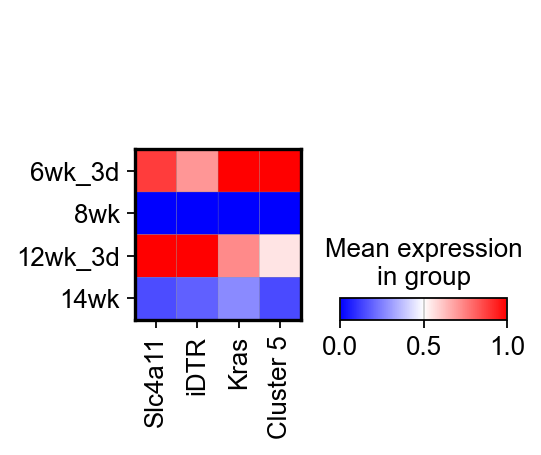

In [33]:
sc.pl.matrixplot(adata,['Slc4a11','iDTR','Kras','Cluster 5'],'Group',cmap='bwr', standard_scale='var')

## Examine Groupings

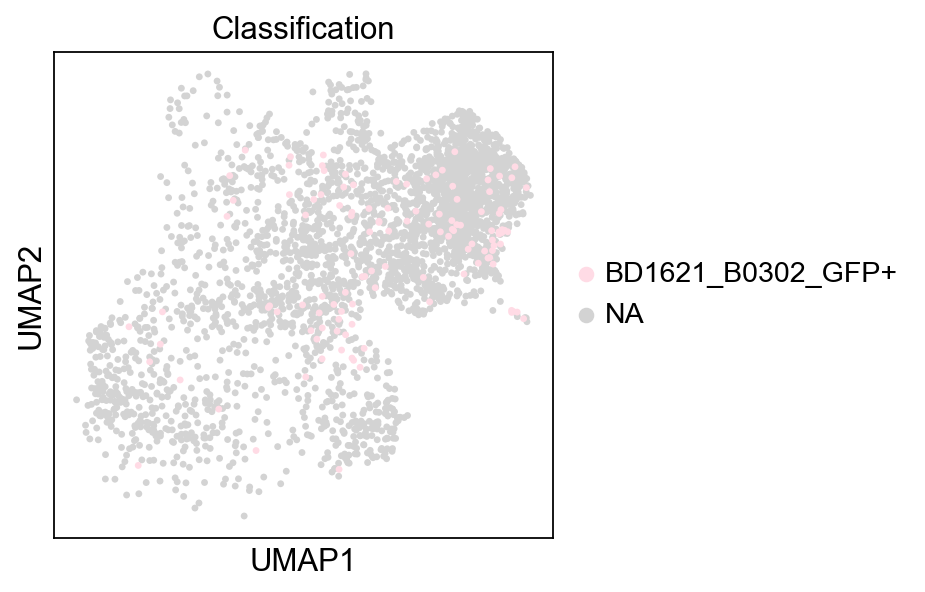

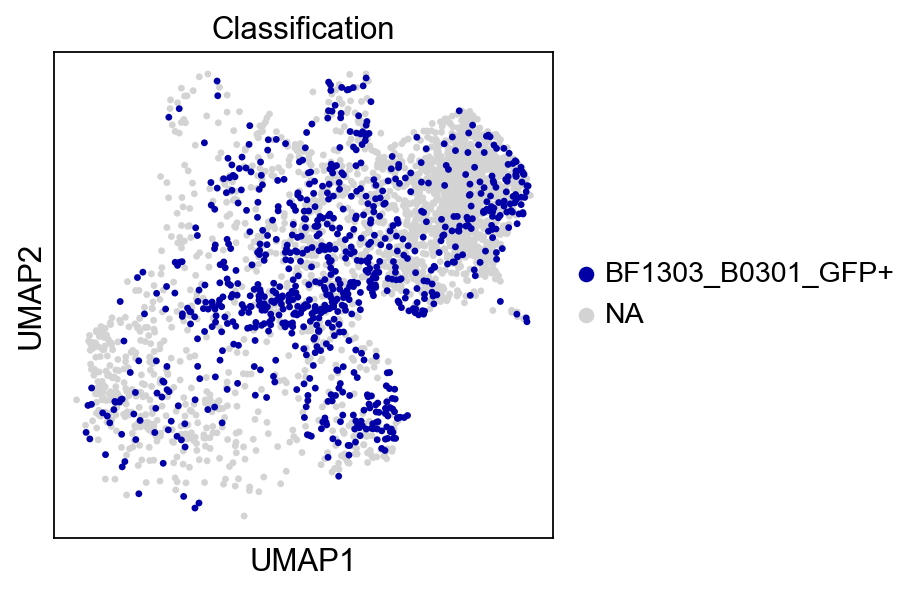

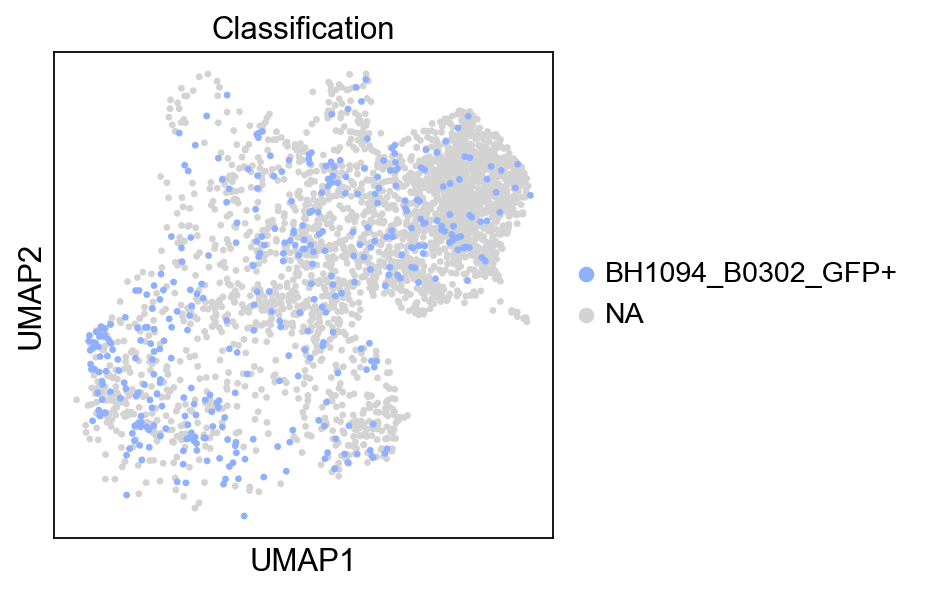

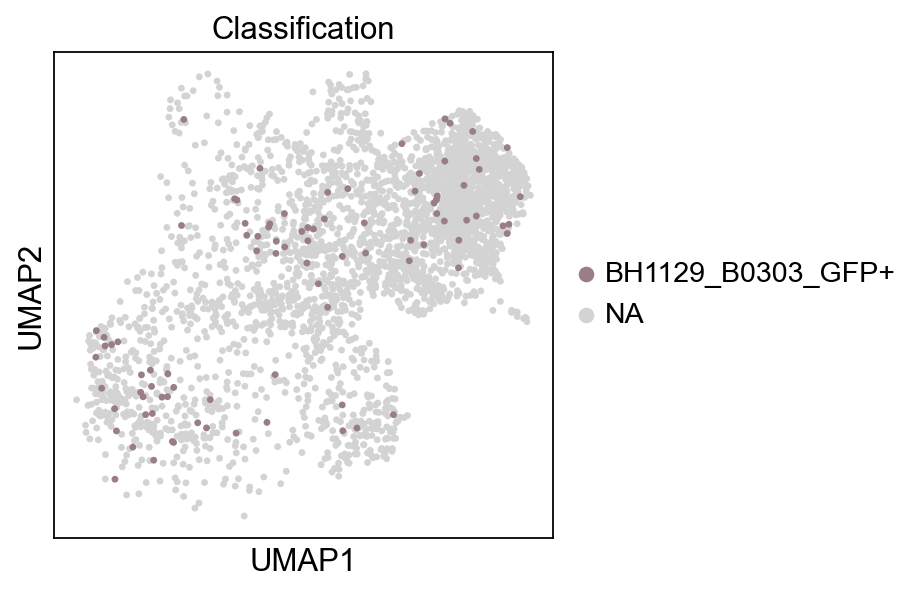

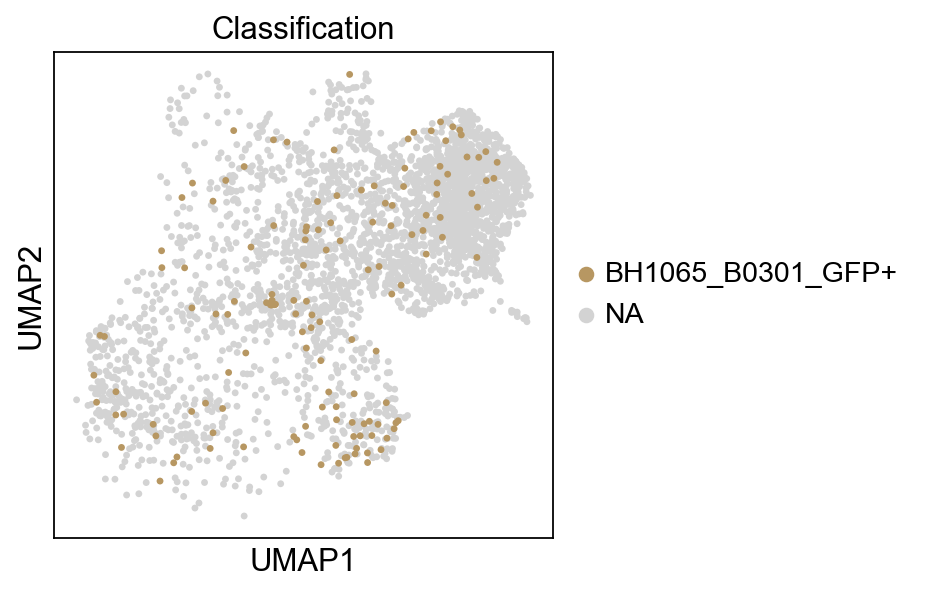

...

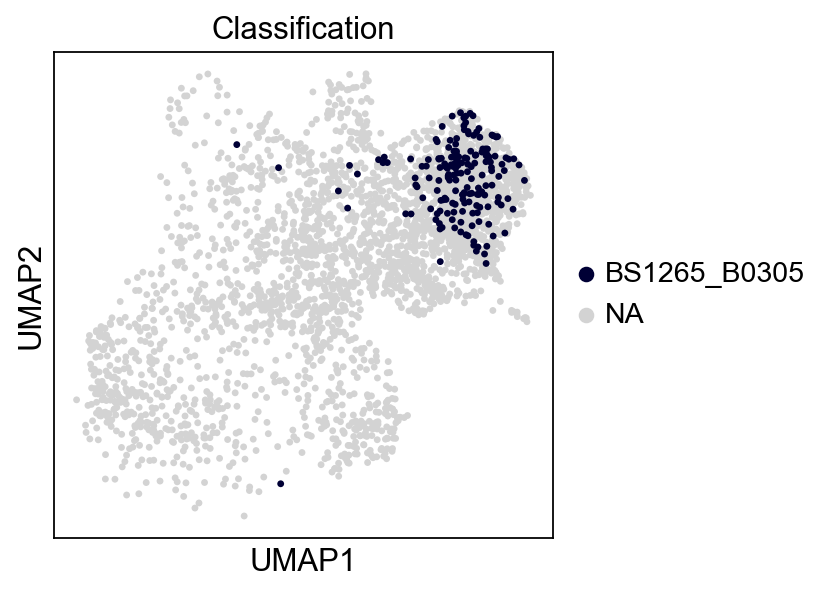

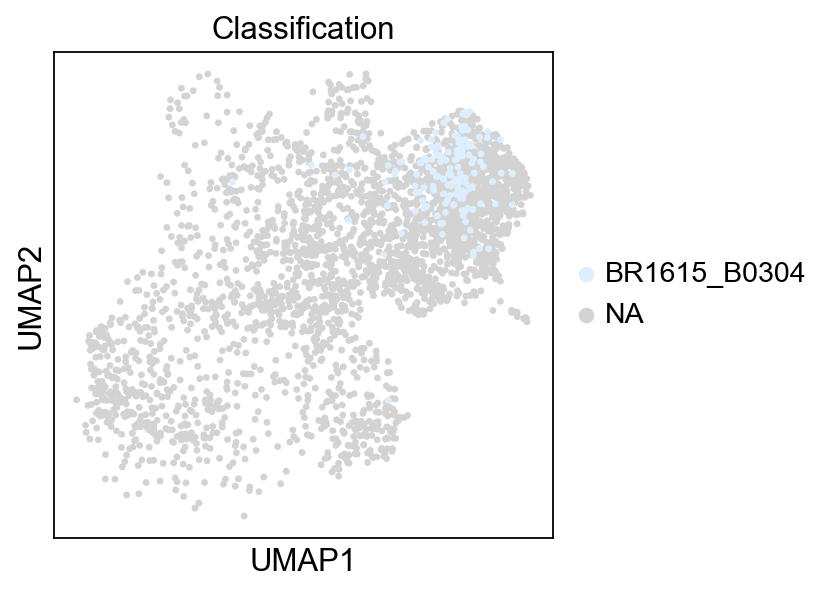

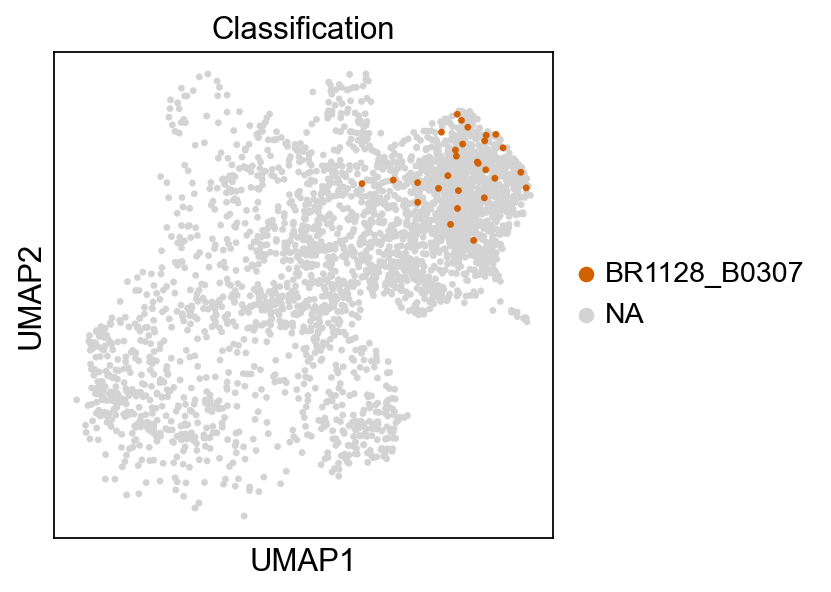

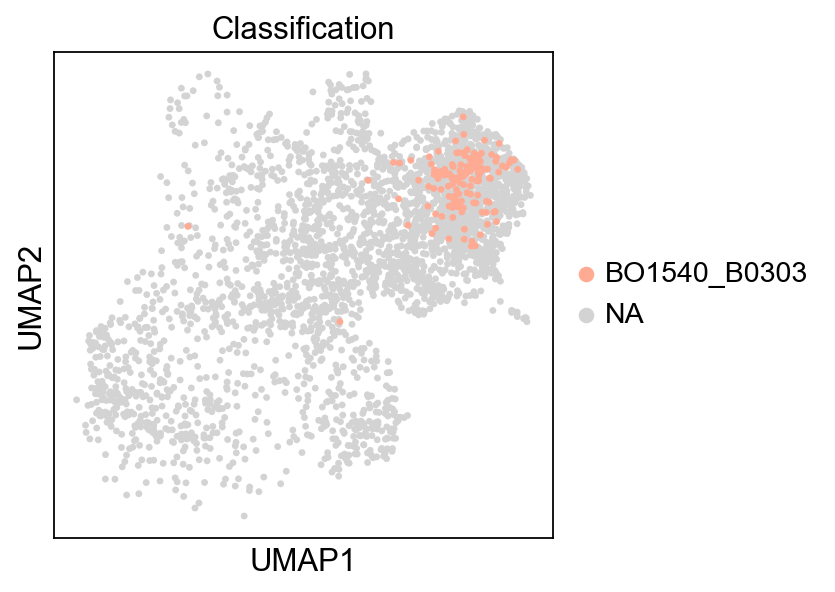

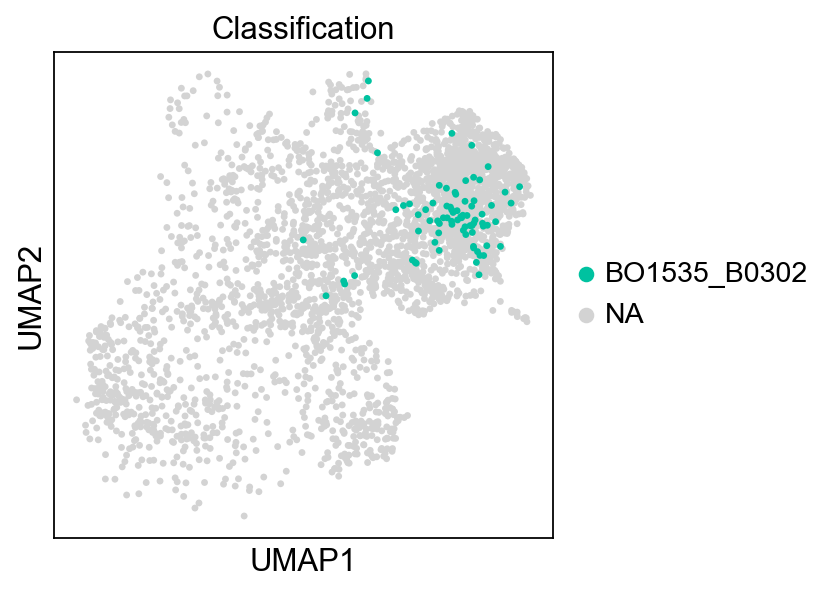

In [34]:
for label in adata.obs['Classification'].unique():
    sc.pl.umap(adata, color='Classification',groups=[label])

In [35]:
sc.tl.embedding_density(adata,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


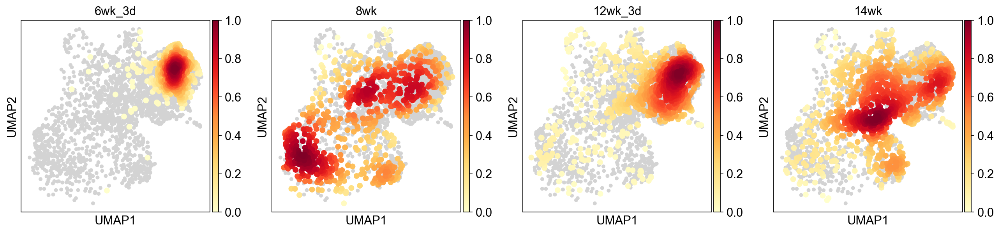

In [36]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Group', )

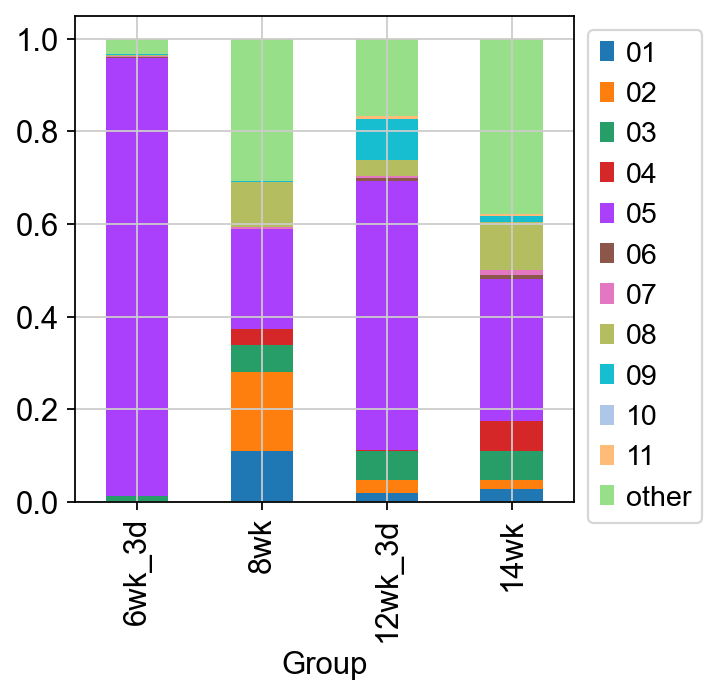

In [37]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12_stringent'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

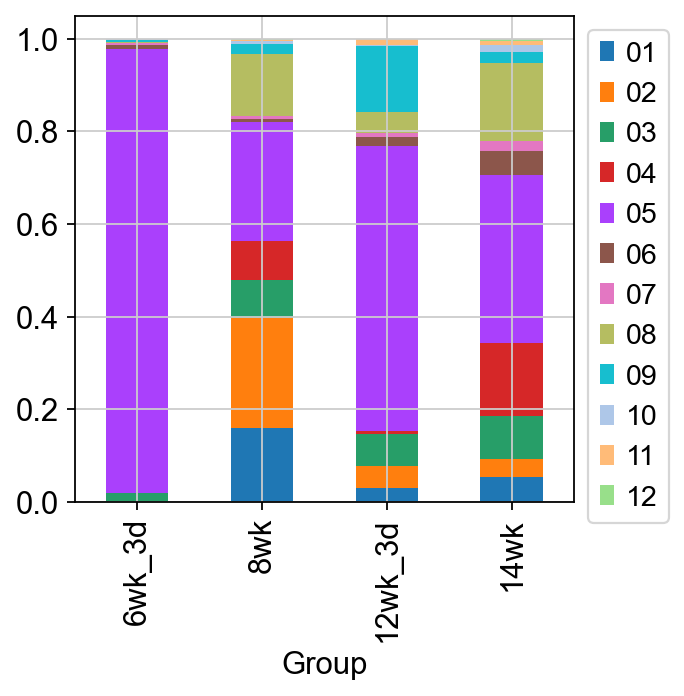

In [38]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [39]:
adata.obs[['Group','Classification']].value_counts(sort=False)

Group    Classification   
6wk_3d   BO1535_B0302          78
         BO1540_B0303         135
         BR1128_B0307          28
         BR1615_B0304         152
         BS1265_B0305         173
8wk      BH1065_B0301_GFP+    138
         BH1094_B0302_GFP+    376
         BH1129_B0303_GFP+     90
         BH1290_B0304_GFP+    138
12wk_3d  BL1121_B0304          57
         BL1124_B0305          67
         BL1233_B0306          58
         BL1237_B0302         239
         BL1606_B0303         354
         BL1646_B0301         102
14wk     BD1621_B0302_GFP+    119
         BF1303_B0301_GFP+    811
         BH1066_GFP+           61
Name: count, dtype: int64

In [40]:
adata.uns['cell type_colors'] = ['#1f77b4',
 '#279e68',
 '#ff7f0e',
 '#aa40fc',
 'palegreen',
 '#d62728',
 '#e377c2',
 '#8c564b',
 'gray']

In [41]:
adata.obs['cell type'].value_counts(sort=False)

cell type
AT1-like                 153
AT2-like                 709
EMT                       12
Embryonic liver-like     205
GI epithelium-like         6
HPCS                    1724
Highly proliferative      98
Lung endoderm-like       269
Name: count, dtype: int64

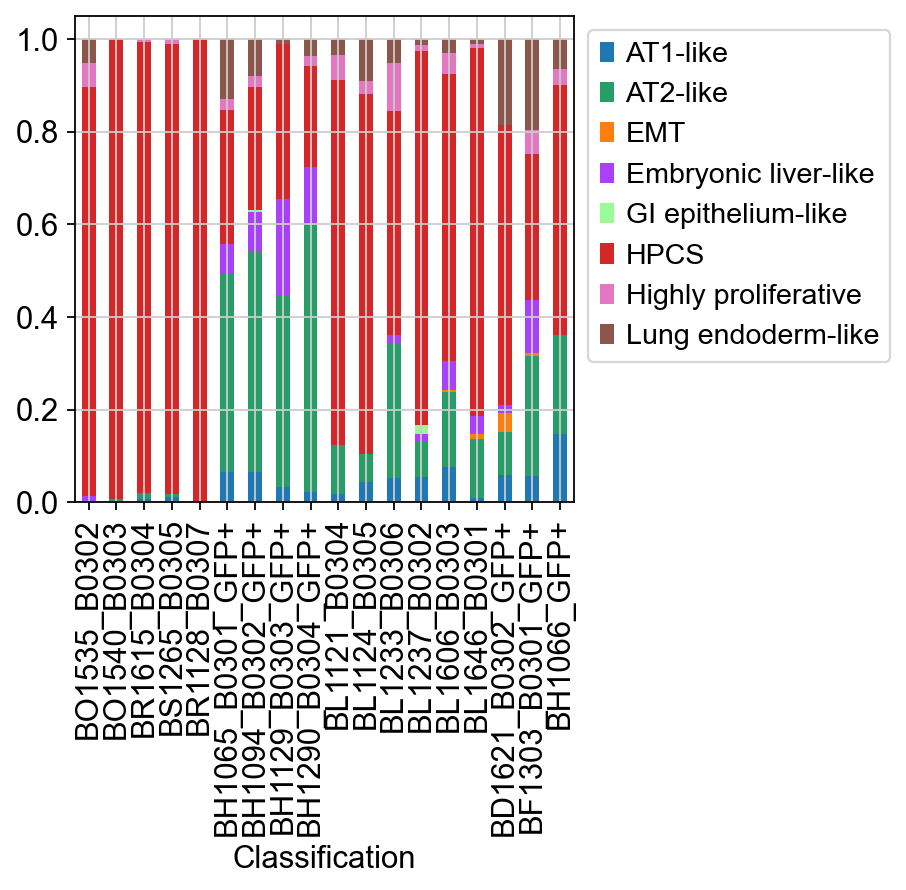

In [42]:
ordered = ['BO1535_B0302', 'BO1540_B0303', 'BR1615_B0304', 'BS1265_B0305','BR1128_B0307', # 6wk 3d
           'BH1065_B0301_GFP+','BH1094_B0302_GFP+','BH1129_B0303_GFP+','BH1290_B0304_GFP+', # 6wk 14d
           'BL1121_B0304','BL1124_B0305','BL1233_B0306','BL1237_B0302','BL1606_B0303','BL1646_B0301', #12wk 3d
           'BD1621_B0302_GFP+','BF1303_B0301_GFP+','BH1066_GFP+'] # 12wk 14d
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Classification'], normalize='columns')[ordered].T.plot(kind='bar', stacked=True, color=adata.uns['cell type_colors']).legend(bbox_to_anchor=(1,1))

In [43]:
sc.tl.embedding_density(adata,basis='umap', groupby='Classification')

computing density on 'umap'
--> added
    'umap_density_Classification', densities (adata.obs)
    'umap_density_Classification_params', parameter (adata.uns)


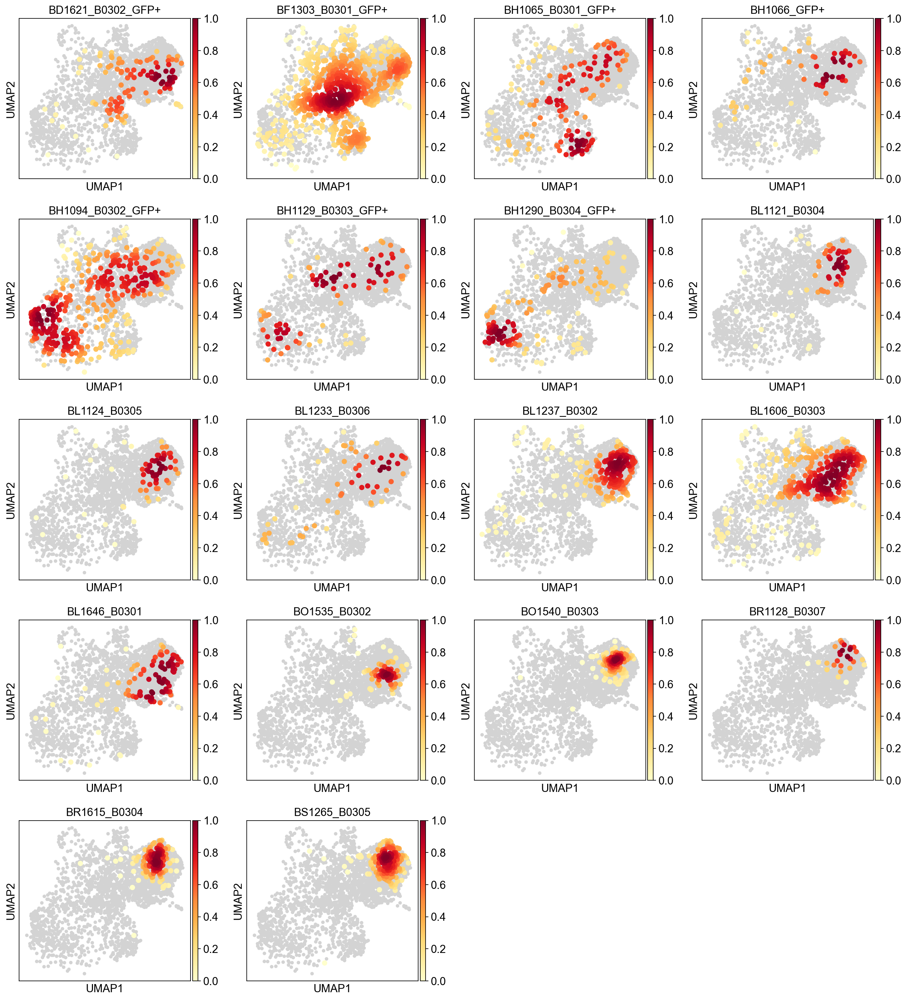

In [44]:
sc.pl.embedding_density(adata,basis='umap',key='umap_density_Classification')

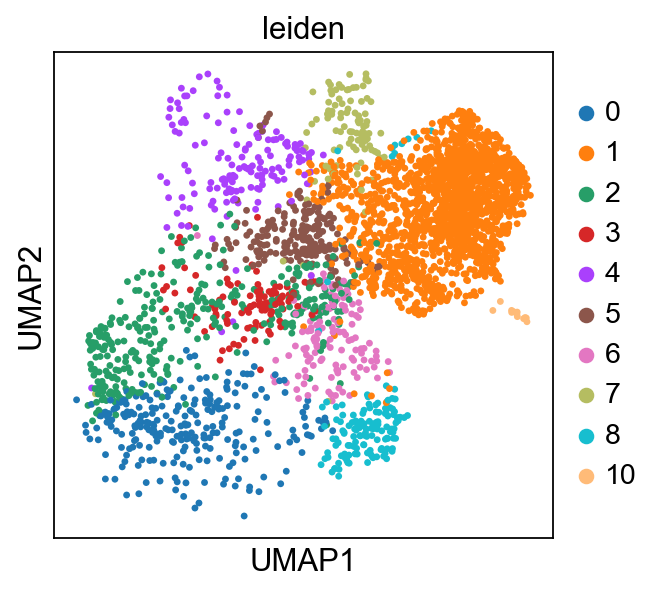

In [45]:
sc.pl.umap(adata, color=['leiden'])

## Evaluate rough clusters

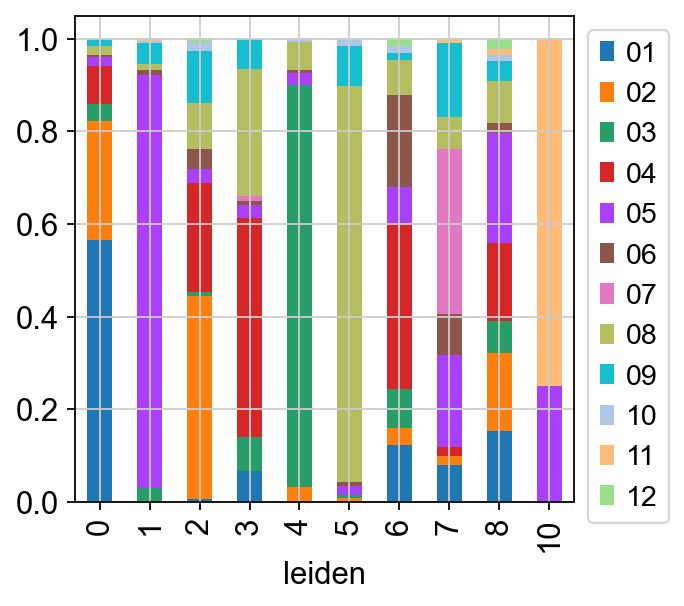

In [46]:
 cell_proportion_df = pd.crosstab(adata.obs['clusterK12'],adata.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

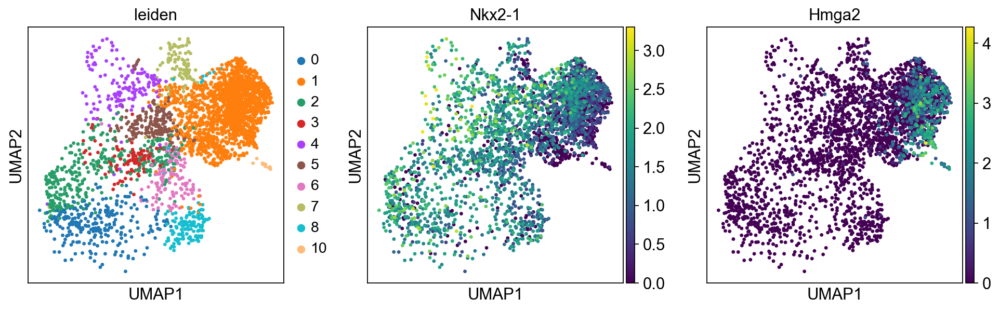

In [47]:
sc.pl.umap(adata, color=['leiden','Nkx2-1','Hmga2'])

## Figures for the paper

### Generate bar graph figures

In [48]:
adata2 = adata[adata.obs.Group.isin(['14wk']),:] # should this be extended to the 12wk_3d 

In [49]:
adata2.obs['HPCS_cell'] = [1  if x == 'HPCS' else 0 for x in adata2.obs['cell type']]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/309636913.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2.obs['HPCS_cell'] = [1  if x == 'HPCS' else 0 for x in adata2.obs['cell type']]


In [50]:
adata3 = adata[adata.obs.Group.isin(['8wk']),:] # should this be extended to the 6wk_3d

In [51]:
adata3.obs['HPCS_cell'] = [1  if x == 'HPCS' else 0 for x in adata3.obs['cell type']]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/1242395224.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata3.obs['HPCS_cell'] = [1  if x == 'HPCS' else 0 for x in adata3.obs['cell type']]


#### 14 week timepoints

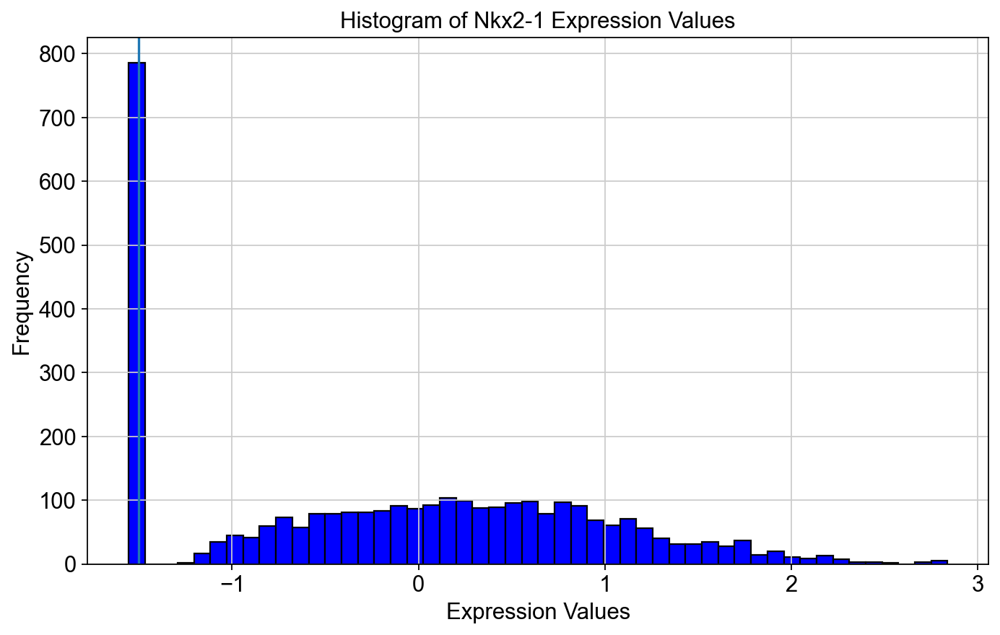

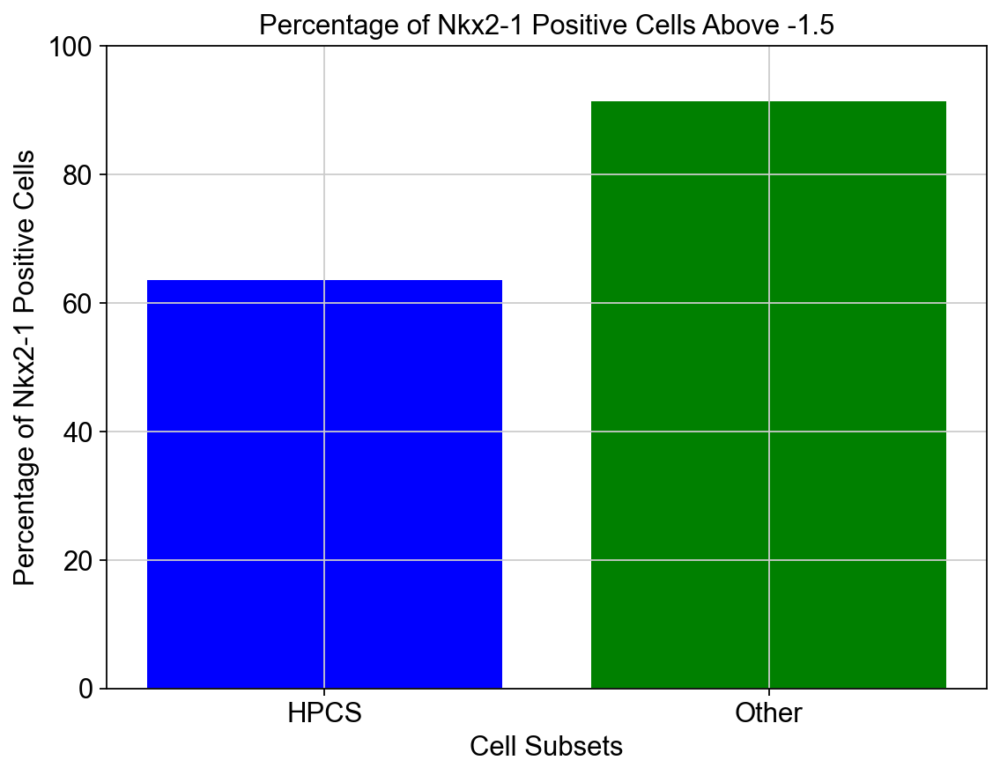

SignificanceResult(statistic=0.1659015439162819, pvalue=4.197762468212995e-26)

In [52]:
gene = 'Nkx2-1'
expression_values = adata[:, gene].X
threshold = -1.5

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['HPCS_cell'] == 1,:]
subset_b = adata2[adata2.obs['HPCS_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

# calculate statistics
from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

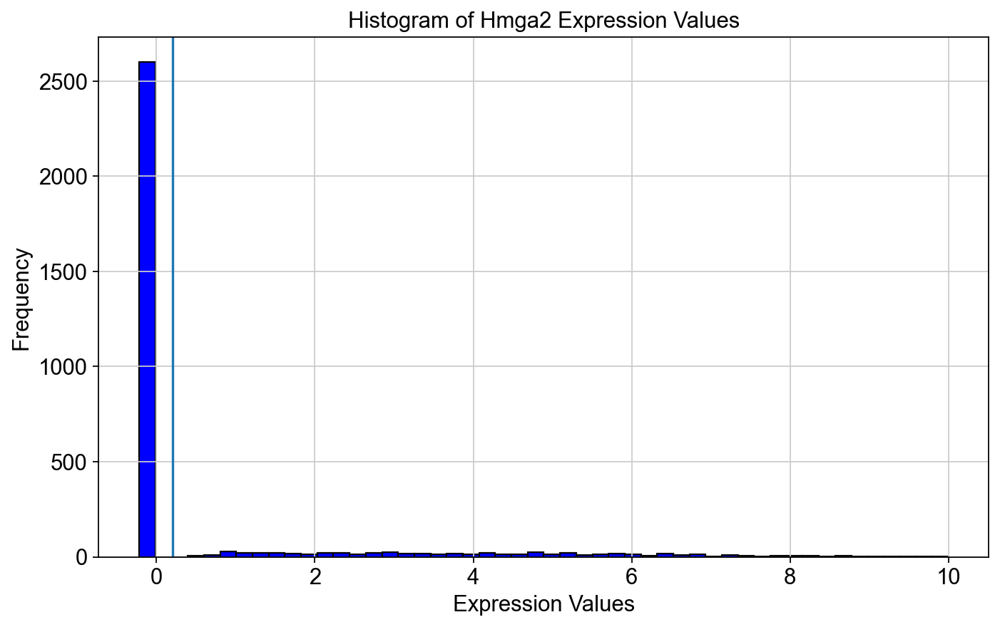

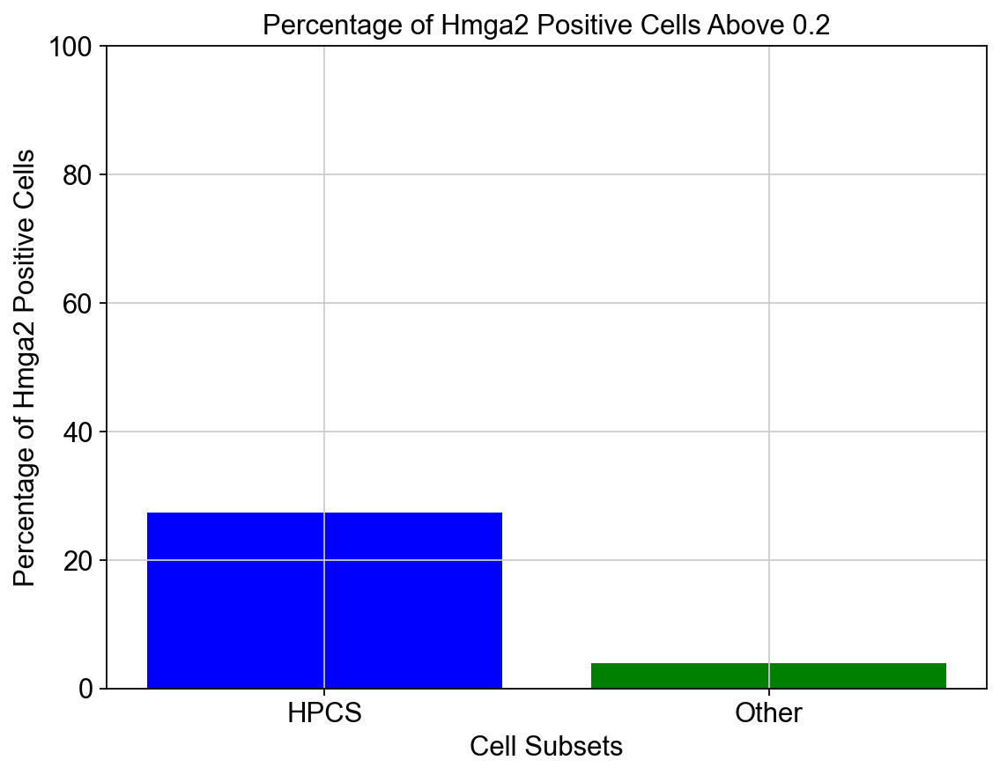

SignificanceResult(statistic=9.116628352490421, pvalue=6.220761857792665e-26)

In [53]:
gene = 'Hmga2'
expression_values = adata[:, gene].X
threshold = 0.2

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['HPCS_cell'] == 1,:]
subset_b = adata2[adata2.obs['HPCS_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

# Calculate statistics

from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

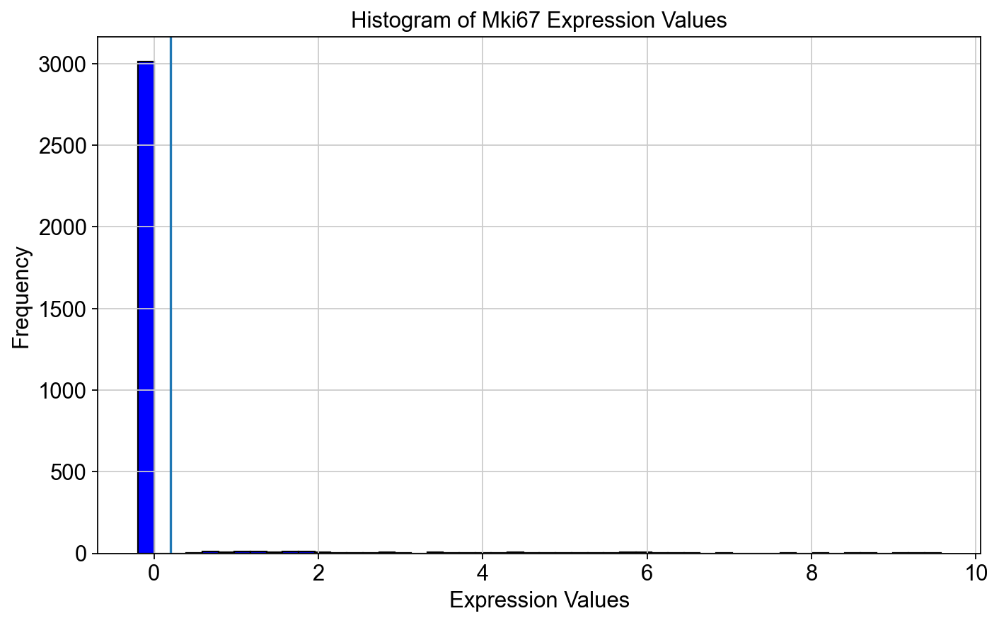

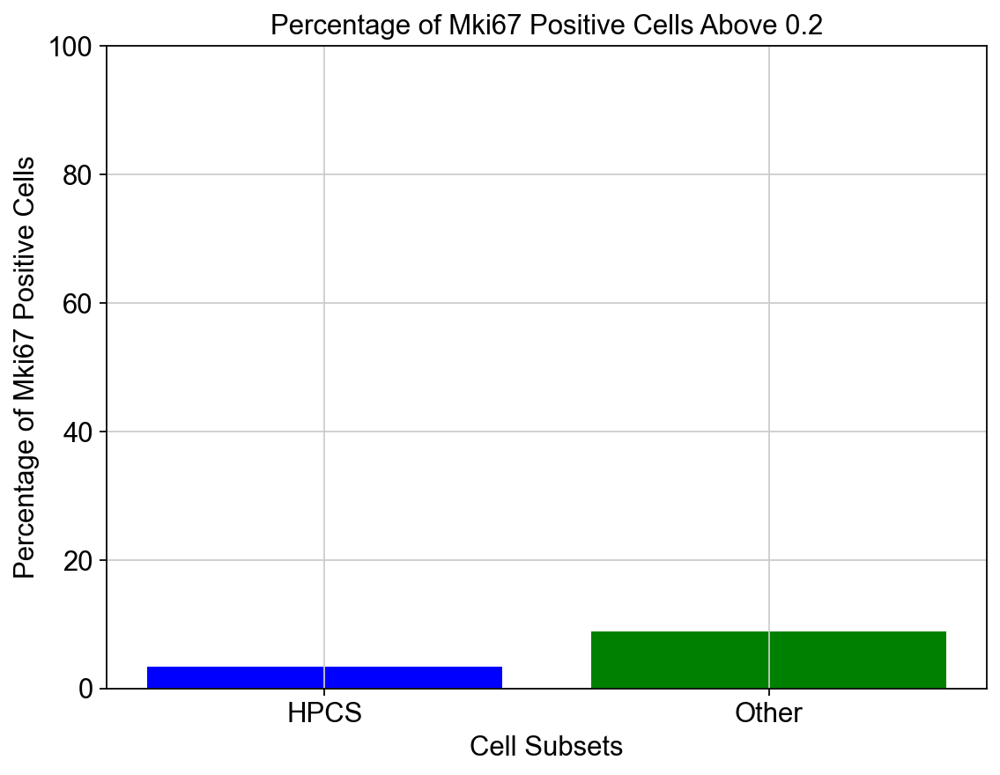

SignificanceResult(statistic=0.3557019349526554, pvalue=0.0009411434647353745)

In [54]:
gene = 'Mki67'
expression_values = adata[:, gene].X
threshold = 0.2

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['HPCS_cell'] == 1,:]
subset_b = adata2[adata2.obs['HPCS_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

#Calculate statistics

from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

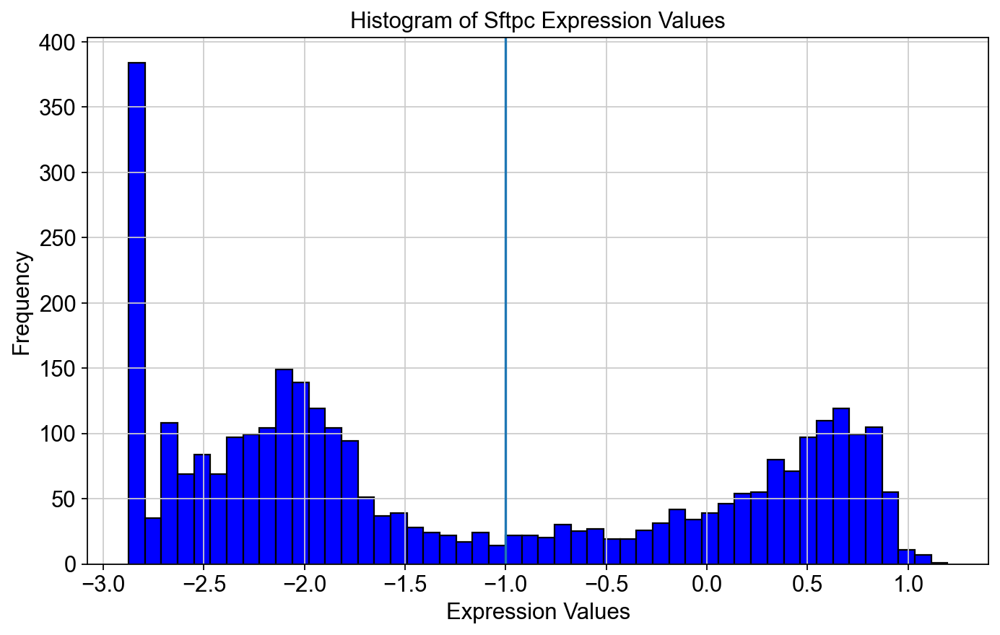

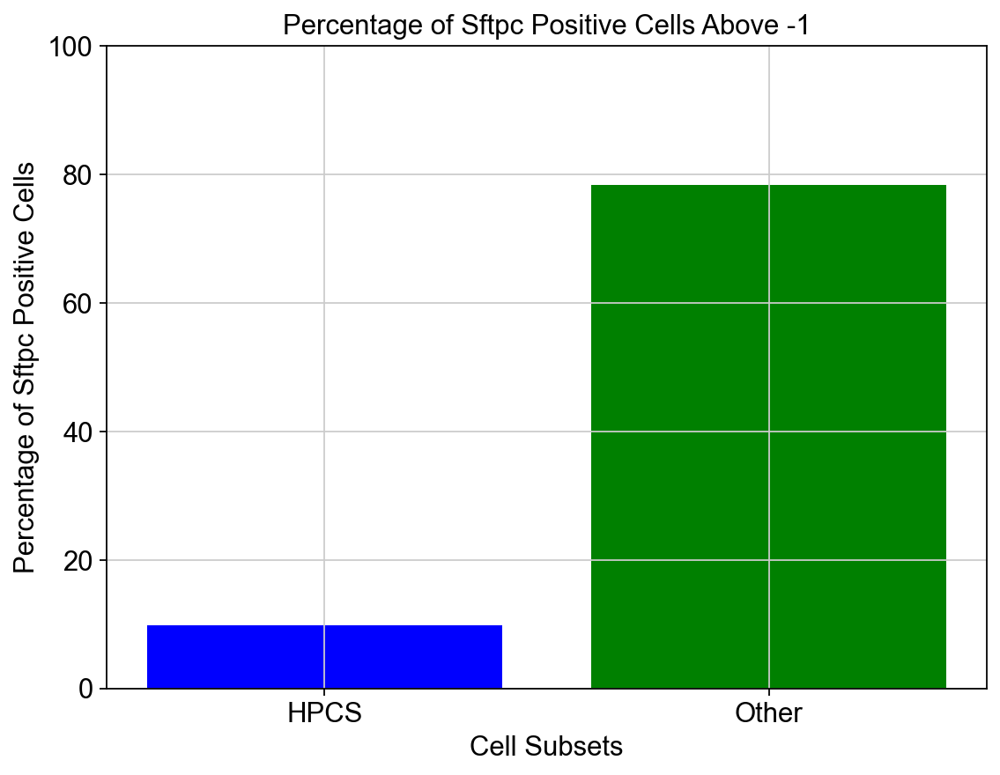

SignificanceResult(statistic=0.029897742860705824, pvalue=1.2355213718926382e-105)

In [55]:
gene = 'Sftpc'
expression_values = adata[:, gene].X
threshold = -1

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['HPCS_cell'] == 1,:]
subset_b = adata2[adata2.obs['HPCS_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

# Calculate statistics
from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

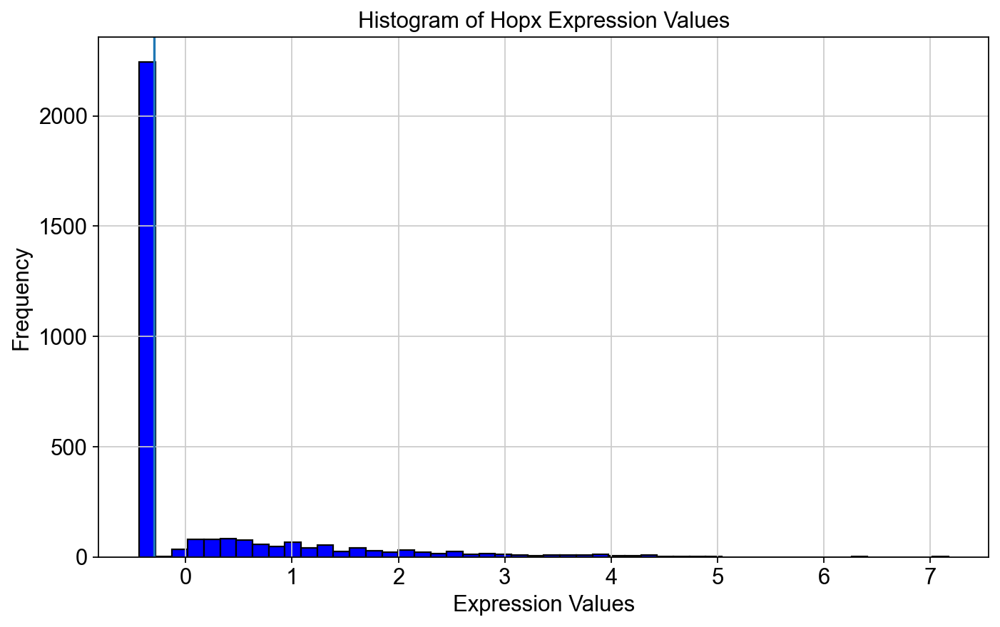

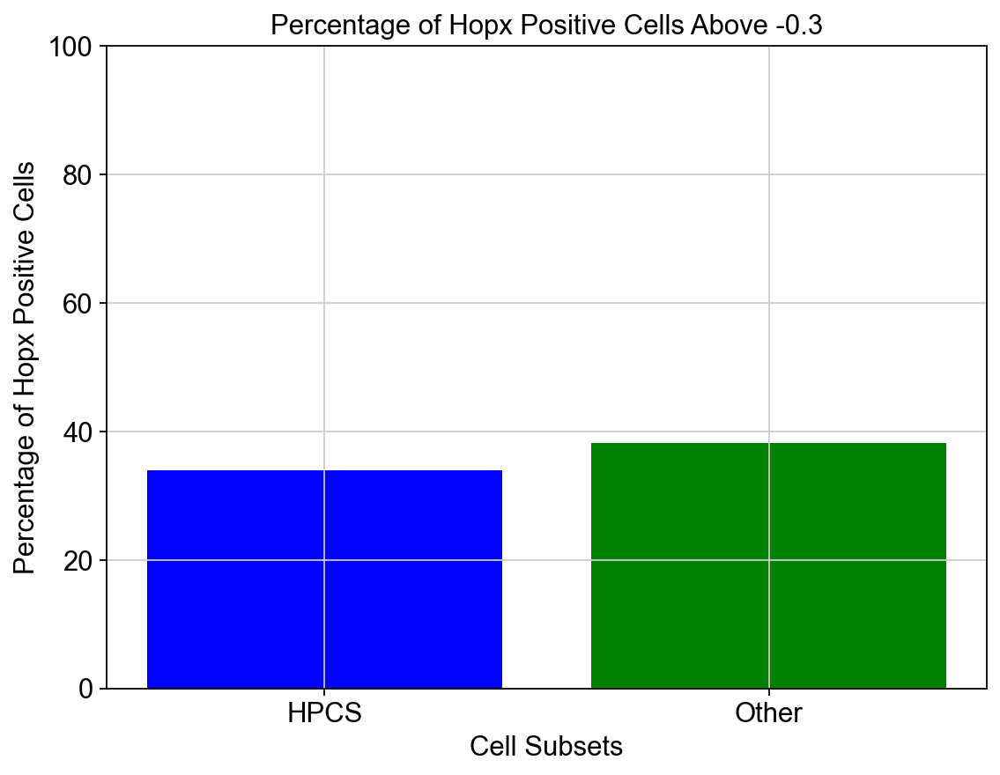

SignificanceResult(statistic=0.8351629112173259, pvalue=0.21695603109199751)

In [56]:
gene = 'Hopx'
expression_values = adata[:, gene].X
threshold = -0.3

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata2[adata2.obs['HPCS_cell'] == 1,:]
subset_b = adata2[adata2.obs['HPCS_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Fig2i_{gene}_positive_cells_percentage_14wk.svg')
plt.show()

#Calculate statistics
from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

#### 8 week timepoints

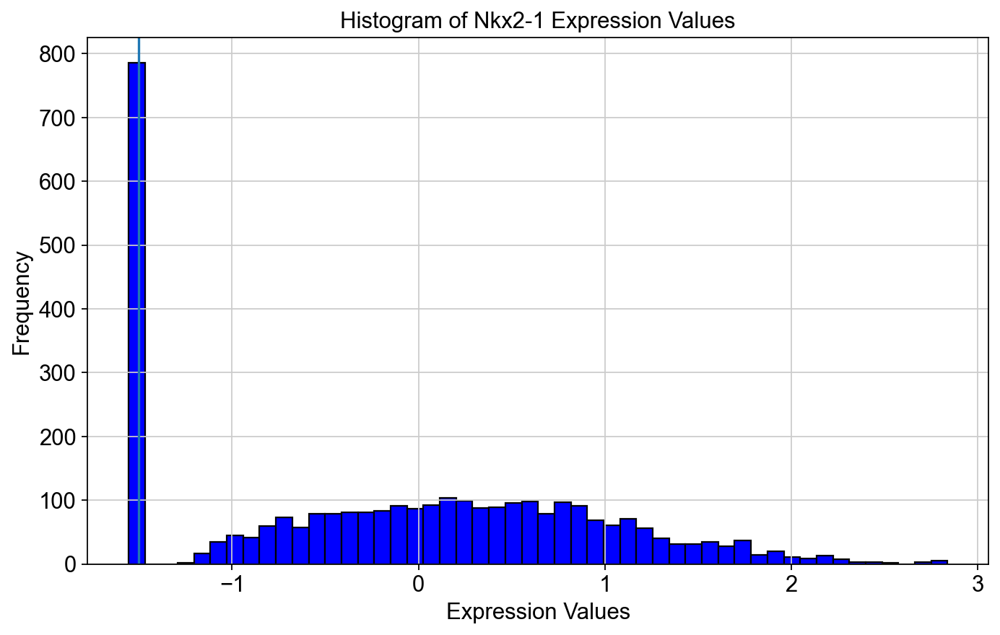

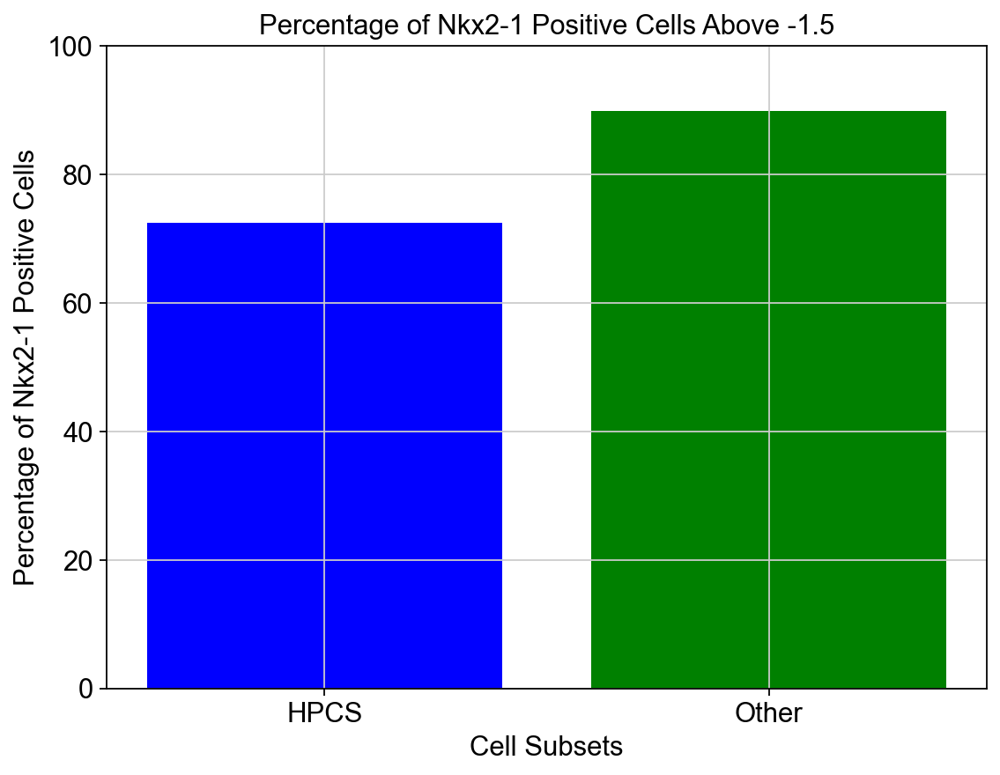

SignificanceResult(statistic=0.29774127310061604, pvalue=2.1448931989850355e-08)

In [57]:
gene = 'Nkx2-1'
expression_values = adata[:, gene].X
threshold = -1.5

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata3[adata3.obs['HPCS_cell'] == 1,:] #6 week
subset_b = adata3[adata3.obs['HPCS_cell'] == 0,:] #12 week

# Extract the expression values for the gene 'Mki67' for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Ext_Data_Fig5f_{gene}_positive_cells_percentage_8wk.svg')
plt.show()

#Calculate statistics

from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

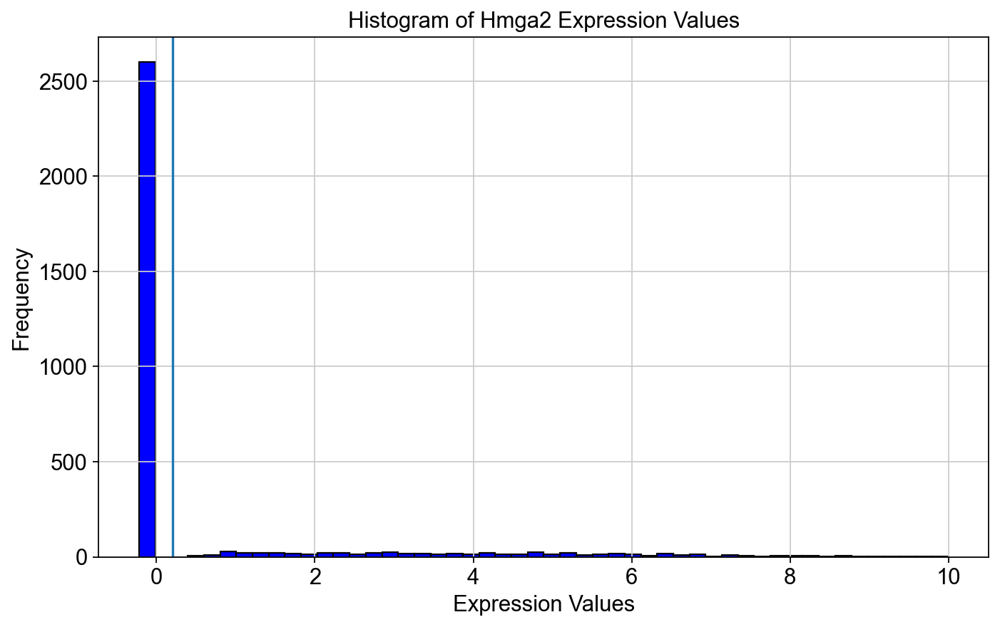

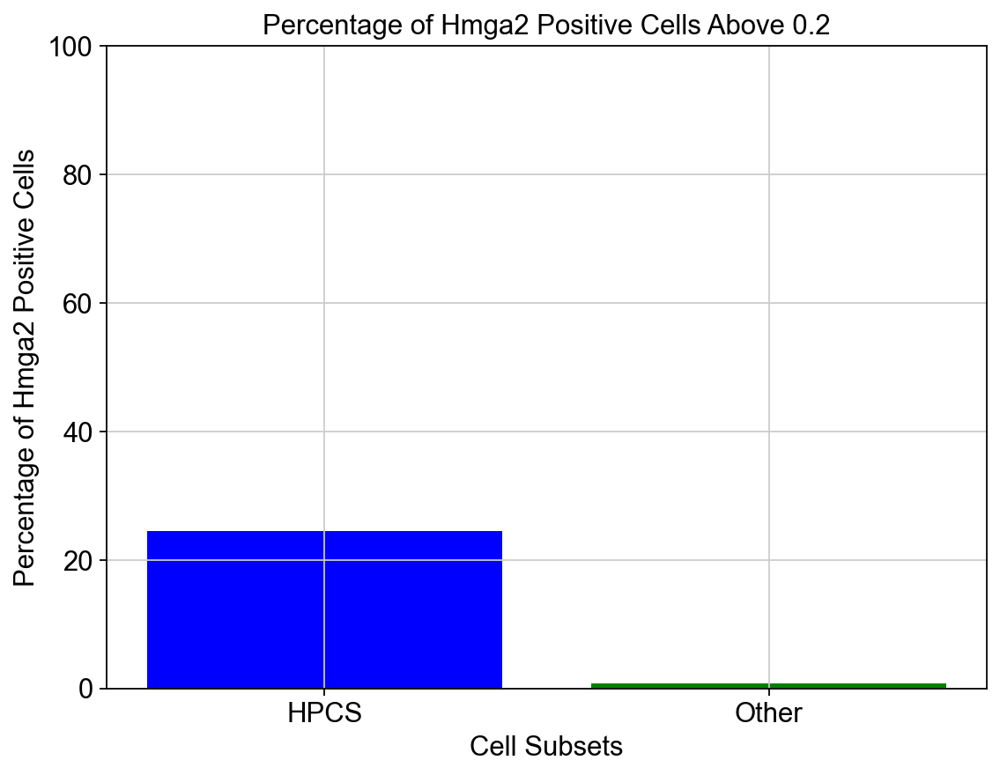

SignificanceResult(statistic=43.645695364238414, pvalue=1.1573206617217833e-25)

In [58]:
gene = 'Hmga2'
expression_values = adata[:, gene].X
threshold = .2

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata3[adata3.obs['HPCS_cell'] == 1,:]
subset_b = adata3[adata3.obs['HPCS_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Ext_Data_Fig5f_{gene}_positive_cells_percentage_8wk.svg')
plt.show()

#Calculate statistics

from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

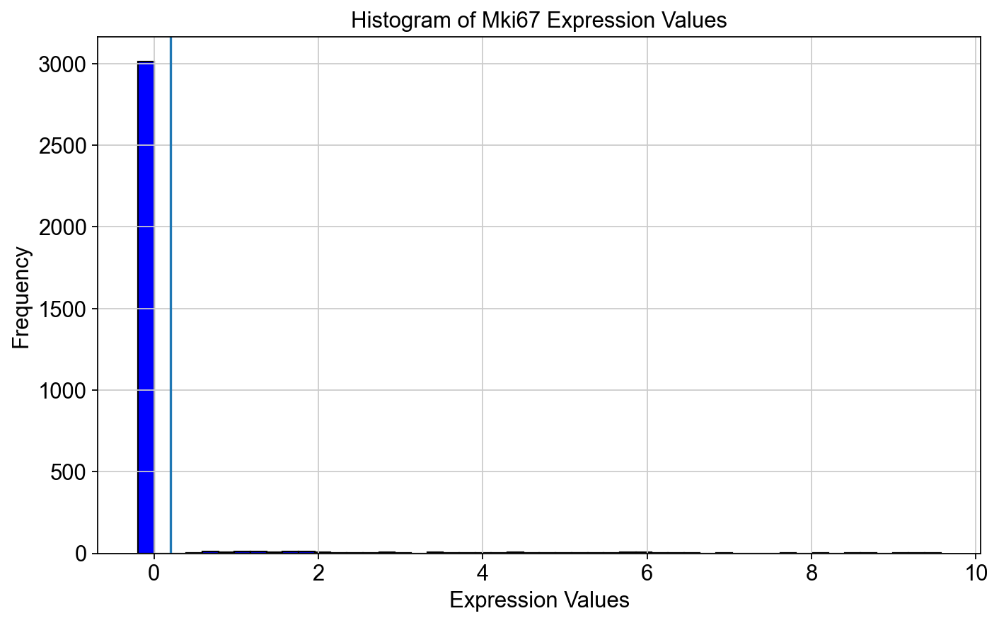

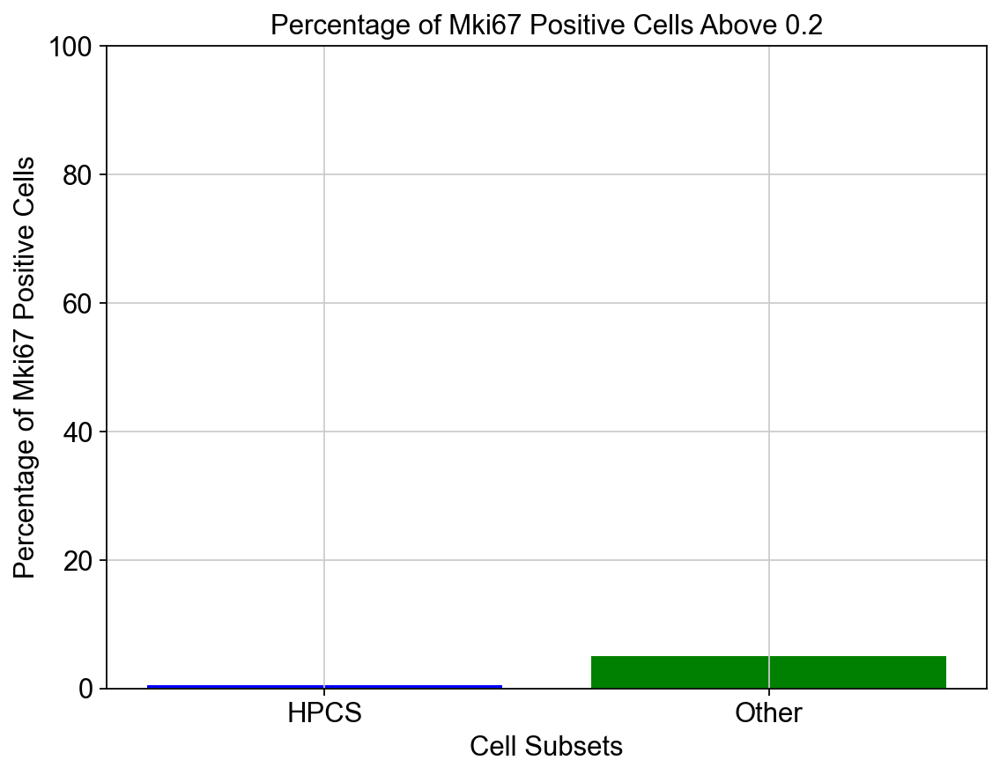

SignificanceResult(statistic=0.09584961846268379, pvalue=0.0020528787499760953)

In [59]:
gene = 'Mki67'
expression_values = adata[:, gene].X
threshold = 0.2

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata3[adata3.obs['HPCS_cell'] == 1,:]
subset_b = adata3[adata3.obs['HPCS_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Ext_Data_Fig5f_{gene}_positive_cells_percentage_8wk.svg')
plt.show()

#Calculate statistics

from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

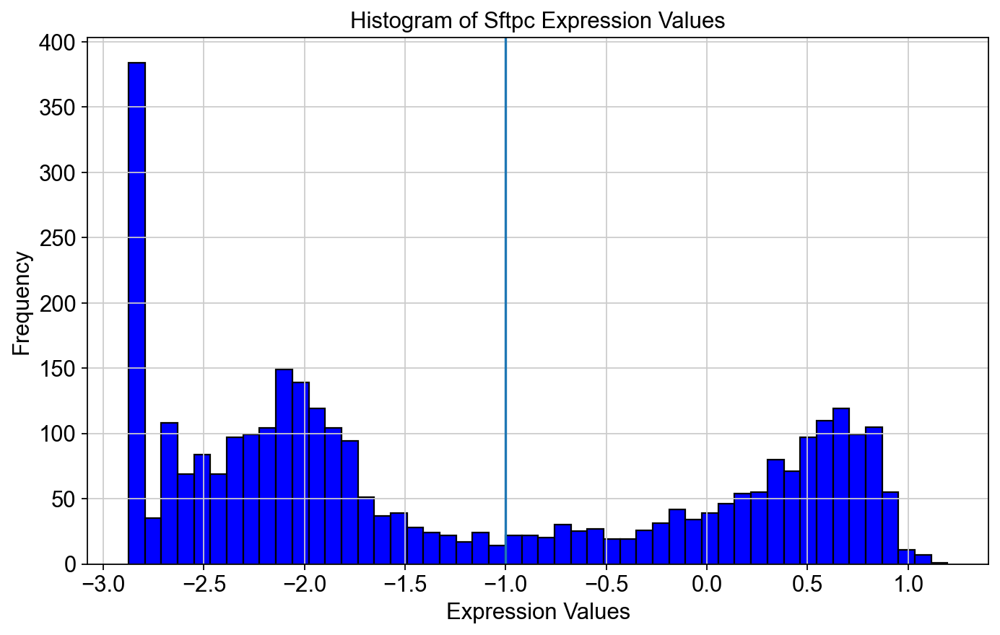

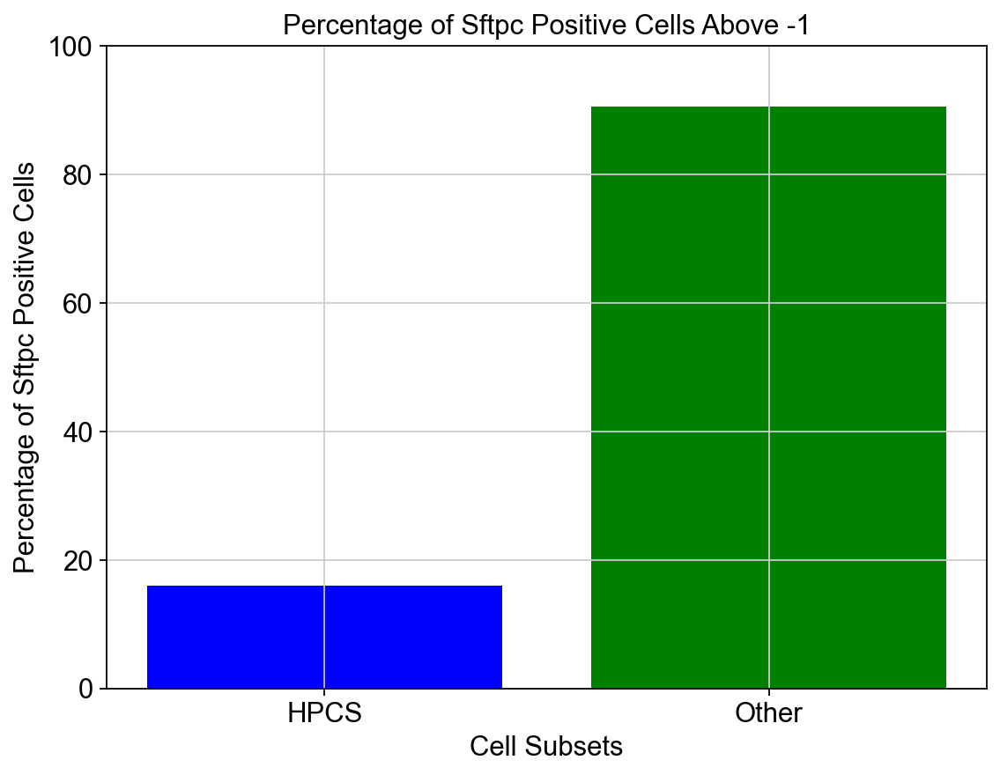

SignificanceResult(statistic=0.019784695955775384, pvalue=1.8144780998866954e-85)

In [60]:
gene = 'Sftpc'
expression_values = adata[:, gene].X
threshold = -1

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata3[adata3.obs['HPCS_cell'] == 1,:] #6 week
subset_b = adata3[adata3.obs['HPCS_cell'] == 0,:] #12 week

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Ext_Data_Fig5f_{gene}_positive_cells_percentage_8wk.svg')
plt.show()

#Calculate statistics

from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

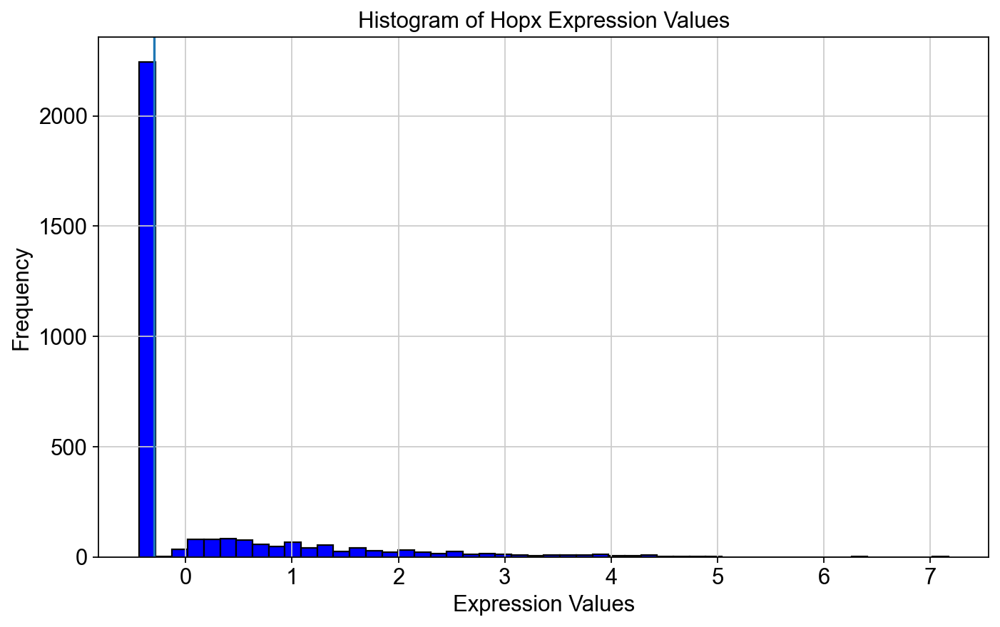

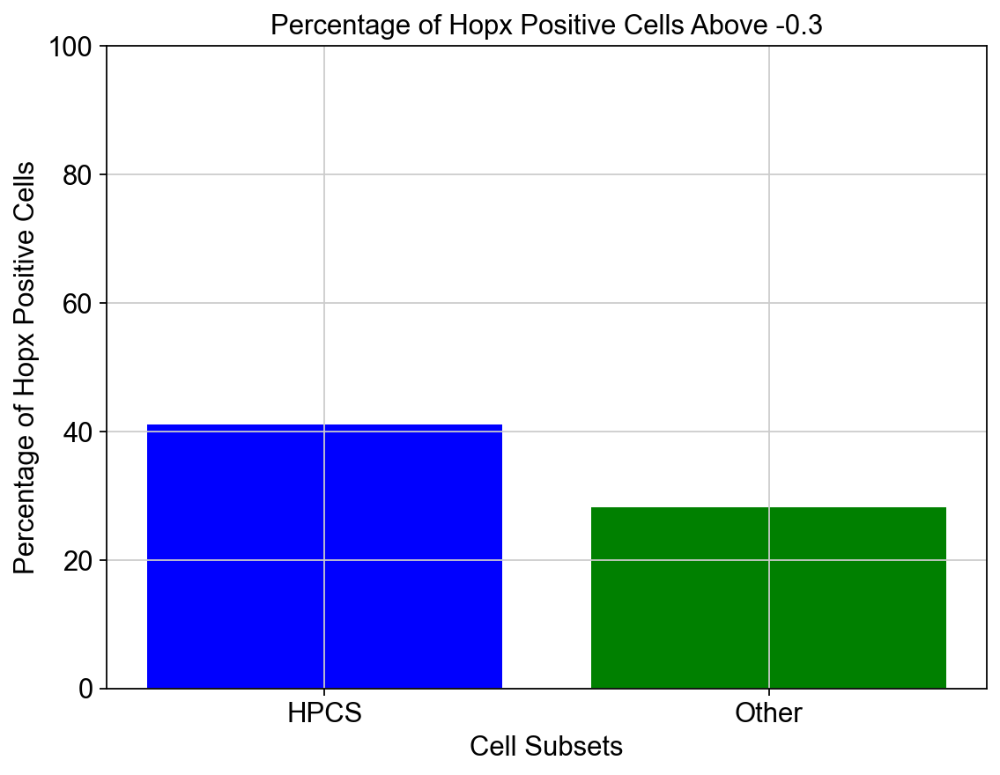

SignificanceResult(statistic=1.7668106790738893, pvalue=0.0013228185925963304)

In [61]:
gene = 'Hopx'
expression_values = adata[:, gene].X
threshold = -0.3

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata3[adata3.obs['HPCS_cell'] == 1,:]
subset_b = adata3[adata3.obs['HPCS_cell'] == 0,:]

# Extract the expression values for the gene for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Ext_Data_Fig5f_{gene}_positive_cells_percentage_8wk.svg')
plt.show()

#Calculate statistics
from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

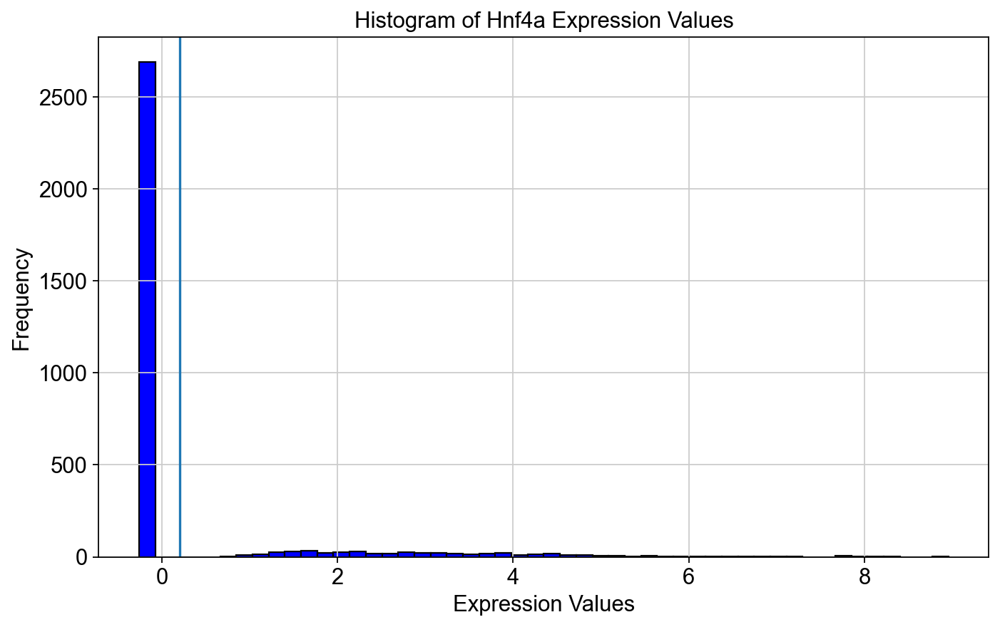

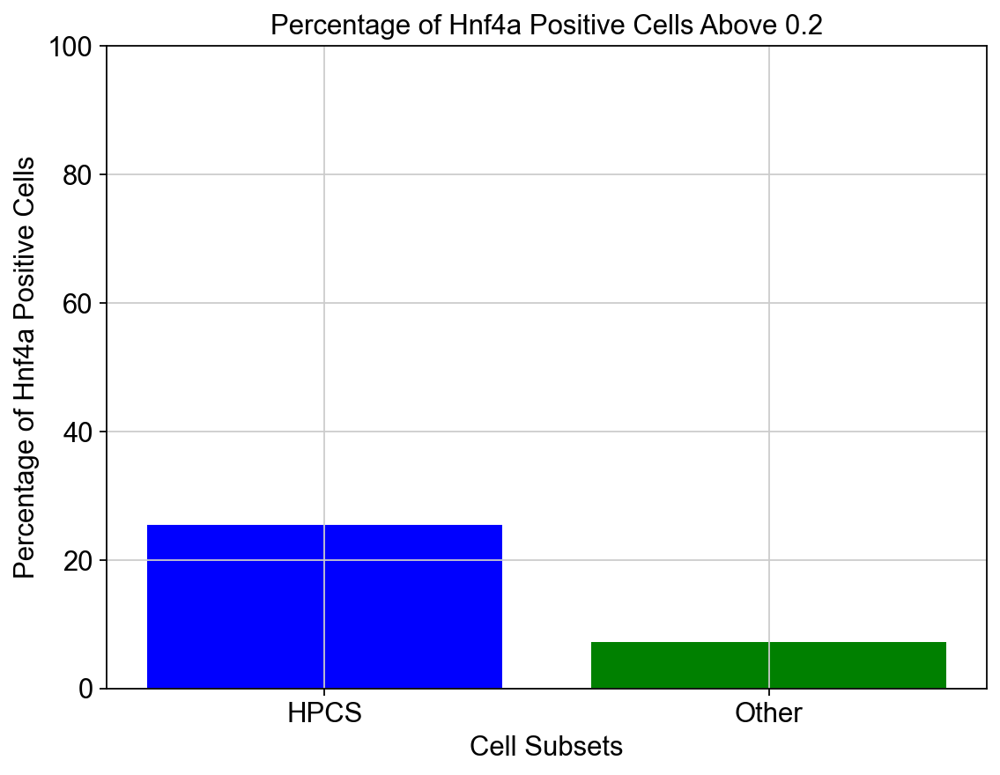

SignificanceResult(statistic=4.41455859576665, pvalue=2.1384175417141183e-10)

In [62]:
gene = 'Hnf4a'
expression_values = adata[:, gene].X
threshold = 0.2

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(expression_values, bins=50, color='blue', edgecolor='black')
plt.axvline(x=threshold)
plt.xlabel('Expression Values')
plt.ylabel('Frequency')
plt.title(f'Histogram of {gene} Expression Values')
plt.show()

# Bar Graph

subset_a = adata3[adata3.obs['HPCS_cell'] == 1,:] #6 week
subset_b = adata3[adata3.obs['HPCS_cell'] == 0,:] #12 week

# Extract the expression values for the gene 'Mki67' for each subset
expression_values_a = subset_a[:, gene].X
expression_values_b = subset_b[:, gene].X

# Calculate the percentage of cells with expression values above the threshold
percent_a = (expression_values_a > threshold).sum() / len(expression_values_a) * 100
percent_b = (expression_values_b > threshold).sum() / len(expression_values_b) * 100

# Plot the bar graph
plt.figure(figsize=(8, 6))
plt.bar(['HPCS', 'Other'], [percent_a, percent_b], color=['blue', 'green'])
plt.xlabel('Cell Subsets')
plt.ylabel(f'Percentage of {gene} Positive Cells')
plt.title(f'Percentage of {gene} Positive Cells Above {threshold}')
plt.ylim(0, 100)
plt.savefig(f'figures/Ext_Data_Fig5f_{gene}_positive_cells_percentage_8wk.svg')
plt.show()

#Calculate statistics

from scipy.stats import fisher_exact
table = [[(expression_values_a > threshold).sum(), (expression_values_a <= threshold).sum()],
        [(expression_values_b > threshold).sum(), (expression_values_b <= threshold).sum()]]
fisher_exact(table)

### Generate uMAPs

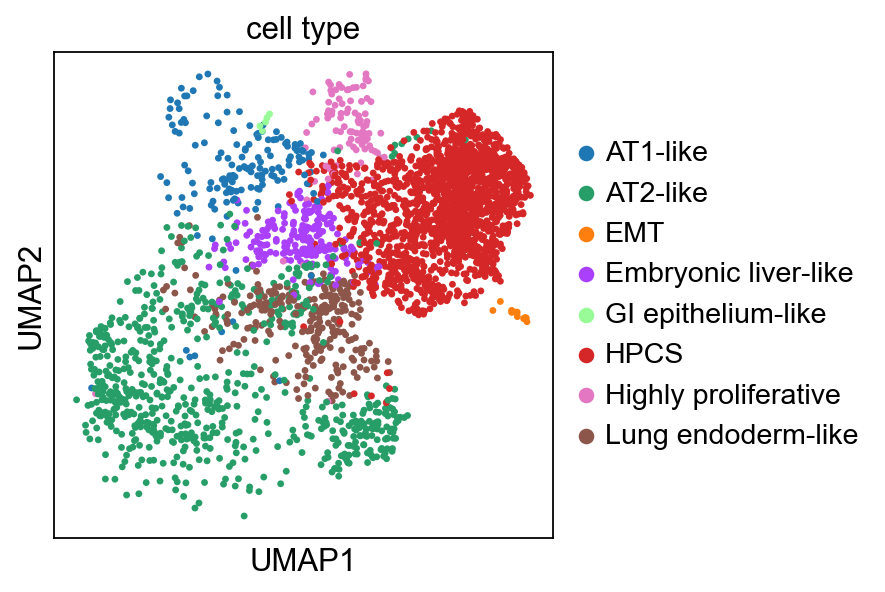

In [63]:
sc.pl.umap(adata,color=['cell type'], save='Ext_Data_Fig5a_cell state umap.svg')
#sc.pl.umap(adata,color=['Slc4a11'], save='Slc4a11 umap.svg', cmap='Reds')
#sc.pl.umap(adata,color=['iDTR'], save='DTR umap.svg', cmap='Reds')
#sc.pl.umap(adata,color=['Cluster 5'], save='Cluster 5 umap.svg', cmap='Reds')

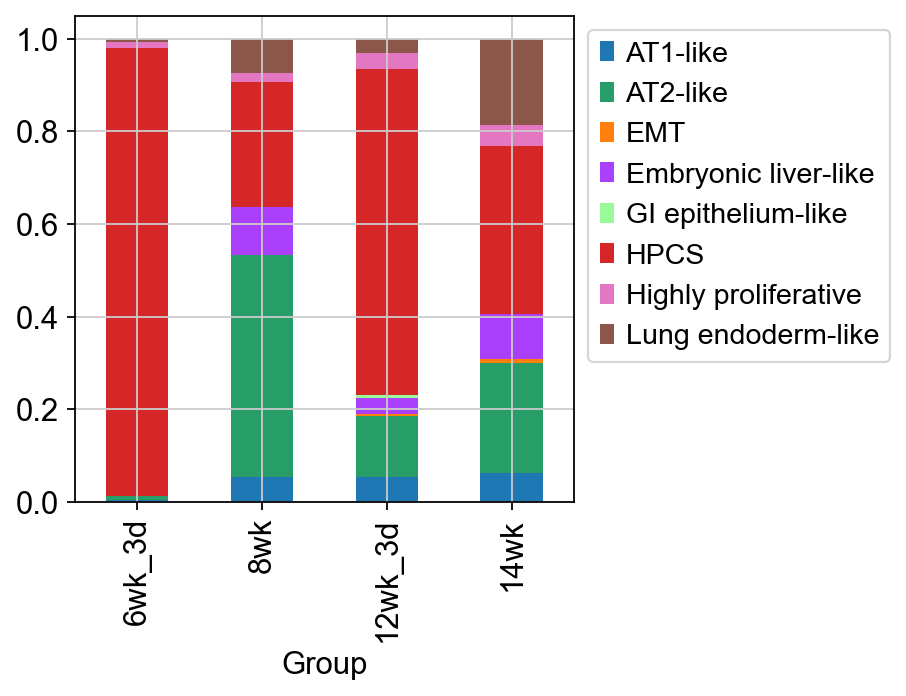

In [64]:
ordered = ['6wk_3d', '8wk','12wk_3d','14wk']
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Group'], normalize='columns')[ordered].T.plot(kind='bar', stacked=True, color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))
cell_proportion_df.get_figure().savefig('figures/Fig2d_cell state proportions.svg')

In [65]:
adata[adata.obs.Group=='12wk_3d',:].obs['cell type'].value_counts(normalize=True)

cell type
HPCS                    0.704675
AT2-like                0.131129
AT1-like                0.054732
Embryonic liver-like    0.035348
Highly proliferative    0.035348
Lung endoderm-like      0.029647
GI epithelium-like      0.005701
EMT                     0.003421
Name: proportion, dtype: float64

In [66]:
adata.obs['Group'].value_counts()

Group
14wk       991
12wk_3d    877
8wk        742
6wk_3d     566
Name: count, dtype: int64

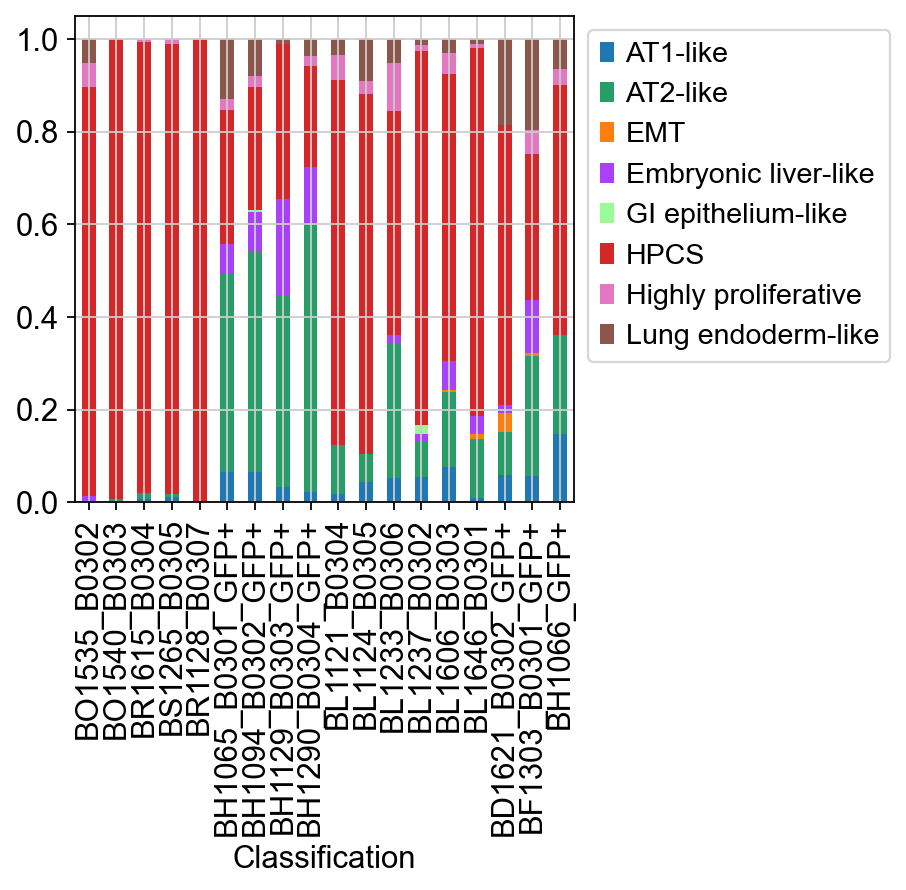

In [67]:
ordered = ['BO1535_B0302', 'BO1540_B0303', 'BR1615_B0304', 'BS1265_B0305','BR1128_B0307', # 6wk 3d
           'BH1065_B0301_GFP+','BH1094_B0302_GFP+','BH1129_B0303_GFP+','BH1290_B0304_GFP+', # 6wk 14d
           'BL1121_B0304','BL1124_B0305','BL1233_B0306','BL1237_B0302','BL1606_B0303','BL1646_B0301', #12wk 3d
           'BD1621_B0302_GFP+','BF1303_B0301_GFP+','BH1066_GFP+'] # 12wk 14d
cell_proportion_df = pd.crosstab(adata.obs['cell type'],adata.obs['Classification'], normalize='columns')[ordered].T.plot(kind='bar', stacked=True,color=adata.uns["cell type_colors"]).legend(bbox_to_anchor=(1,1))
cell_proportion_df.get_figure().savefig('figures/Ext_Data_Fig5b_cellmapbyID2.svg')

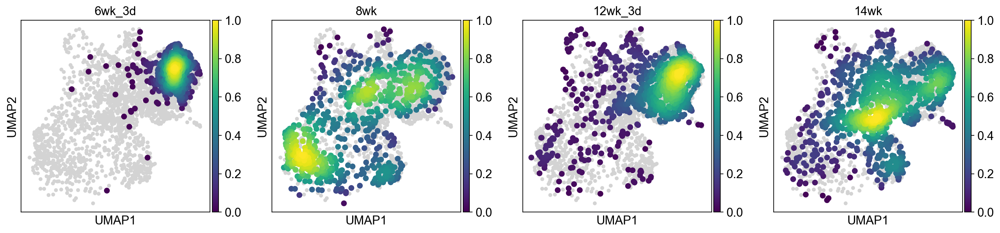

In [68]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_Group',save='Fig2_f_g_Week.svg',color_map='viridis',)

In [69]:
adata

AnnData object with n_obs × n_vars = 3176 × 28999
    obs: 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log10GenesPerUMI', 'Classification', 'EGFP_count', 'Cre_count', 'tdTomato_count', 'Sorting_Groups', 'Group', 'time', 'batch_subgroup', 'batch_untraced', 'Reporter', 'batch', 'Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5', 'Cluster 6', 'Cluster 7', 'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12', 'leiden', 'umap_density_Group', 'clusterK12', 'clusterK12_stringent', 'newleiden', 'cell type', 'umap_density_Classification'
    var: 'gene_ids-Hopx-MACD', 'feature_types-Hopx-MACD', 'mt-Hopx-MACD', 'highly_variable-Hopx-MACD', 'means-Hopx-MACD', 'dispersions-Hopx-MACD', 'dispersions_norm-Hopx-MACD', 'genome-Hopx-MACD', 'pattern-Hopx-MACD', 'read-Hopx-MACD', 'sequence-Hopx-MACD', 'n_cells-Hopx-MACD', 'n_cells_by_counts-Hopx-MACD', 'mean_counts-Hopx-MACD', 'pct_dropout_by_counts-Hopx-MACD', 'total_counts-H

In [70]:
adata_t = adata[adata.obs.Group=='8wk',:].copy()

In [71]:
# Get current 'cell type' categories in the subset (in correct order)
present_categories = adata_t.obs['cell type'].cat.categories

# Get the original colors and categories
all_categories = adata.obs['cell type'].cat.categories
all_colors = adata.uns['cell type_colors']

# Map original categories to their colors
category_color_map = dict(zip(all_categories, all_colors))

# Now only keep colors for the present categories
subset_colors = [category_color_map[cat] for cat in present_categories]

# Assign them to the subset AnnData
adata_t.uns['cell type_colors'] = subset_colors

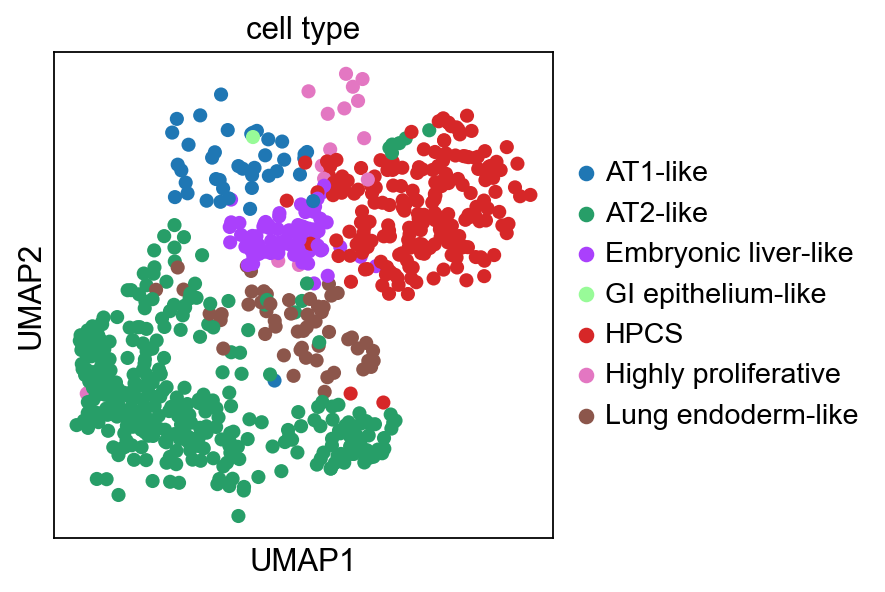

In [72]:
sc.pl.umap(adata_t,color=['cell type'], save='Fig2f_cell state umap-8wk.svg')


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


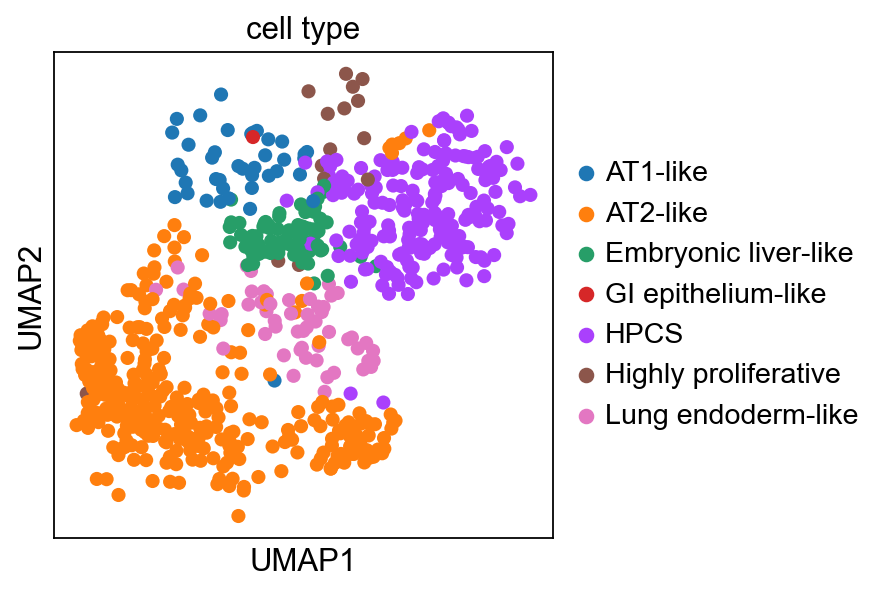

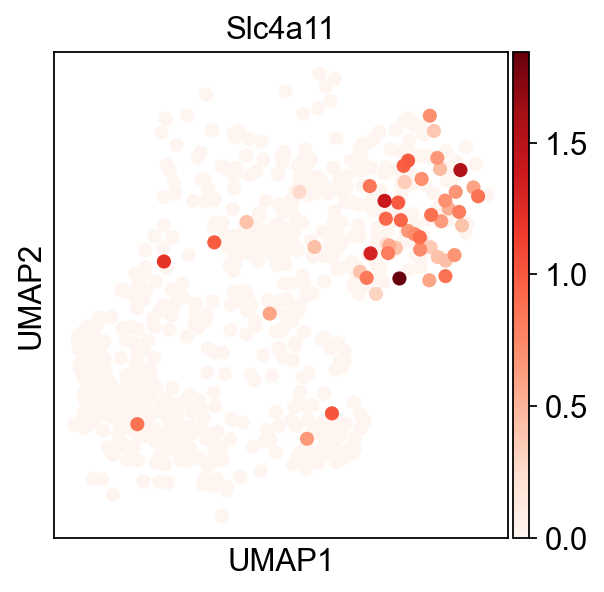

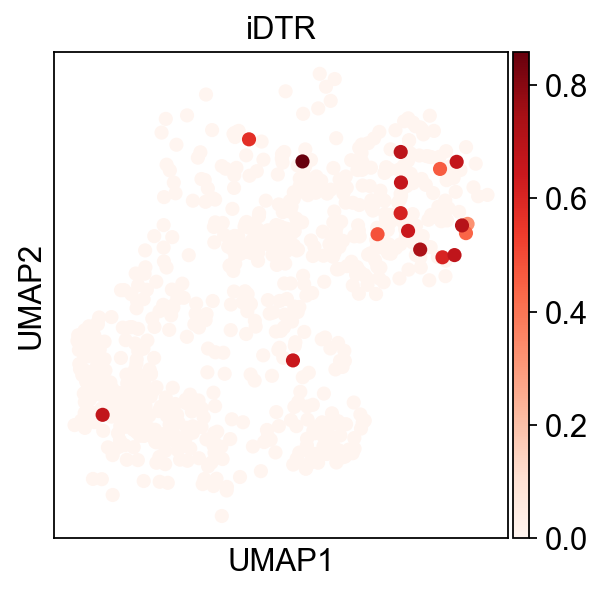

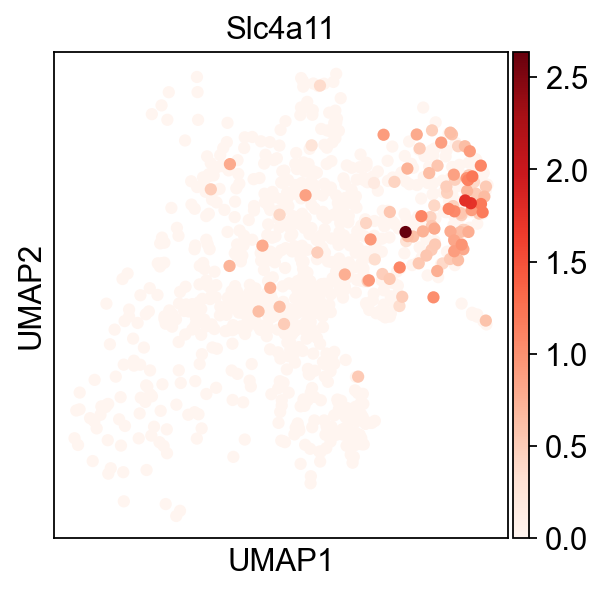

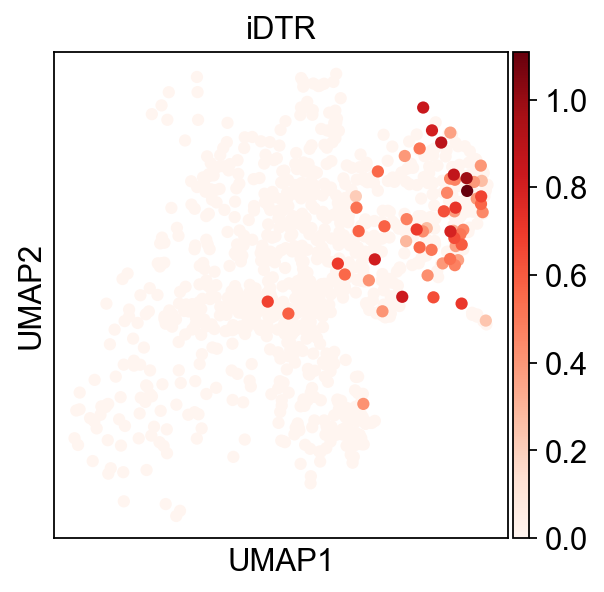

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


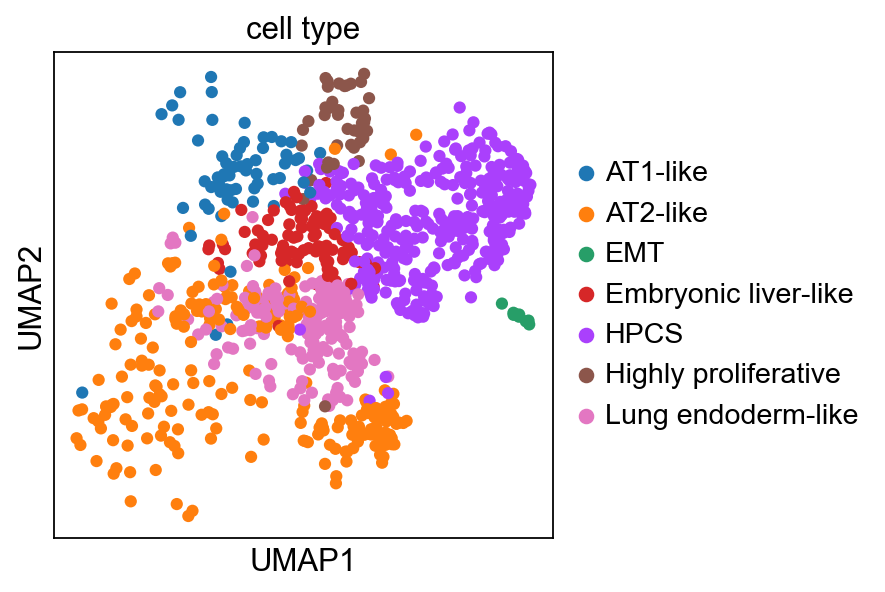

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


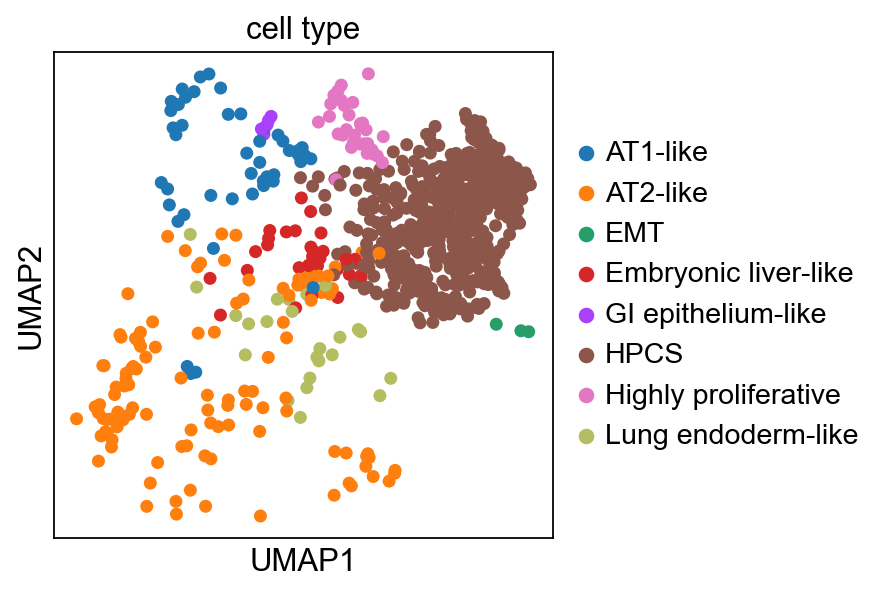

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/plotting/_utils.py:491: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


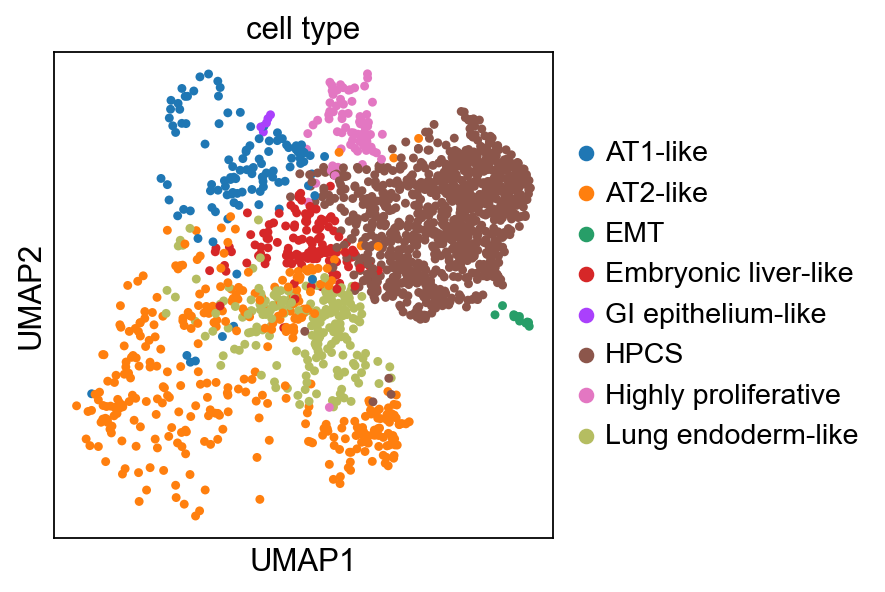

In [73]:
# will need to redo this as above to preserve colors
sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['cell type'], save='Fig2f_cell state umap-8wk.svg')
sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['Slc4a11'], save='Ext_Data_Fig5c_Slc4a11 umap-8wk.svg', cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['iDTR'], save='Ext_Data_Fig5c_DTR umap-8wk.svg', cmap='Reds')
#sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['Cluster 5'], save='HPCS umap-8wk.svg', cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['Slc4a11'], save='Ext_Data_Fig5d_Slc4a11 umap-14wk.svg', cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['iDTR'], save='Ext_Data_Fig5dDTR umap-14wk.svg', cmap='Reds')
#sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['Cluster 5'], save='HPCS umap-14wk.svg', cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['cell type'], save='Fig2g_cell state umap-14wk.svg')
sc.pl.umap(adata[adata.obs.Group=='12wk_3d',:],color=['cell type']) # save to file at somepoint
sc.pl.umap(adata[adata.obs.Group.isin(['12wk_3d','14wk']),:],color=['cell type'],save='Interim_14wk.svg')

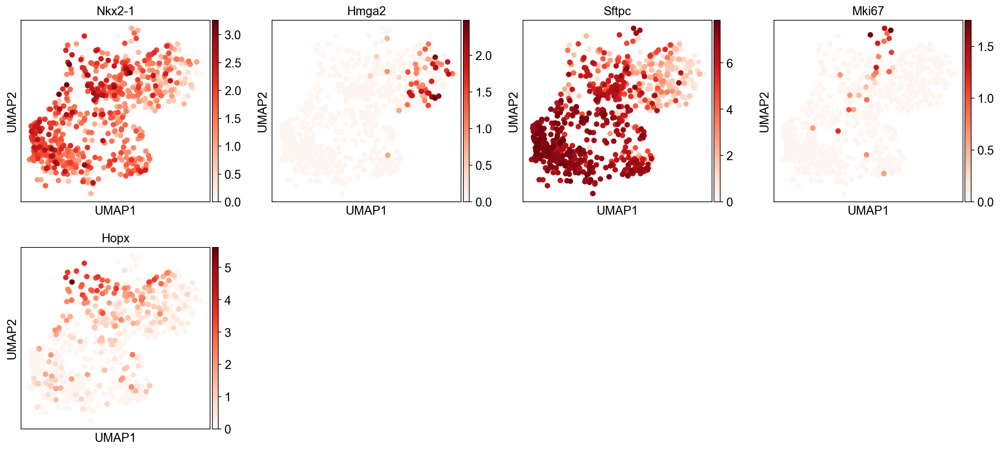

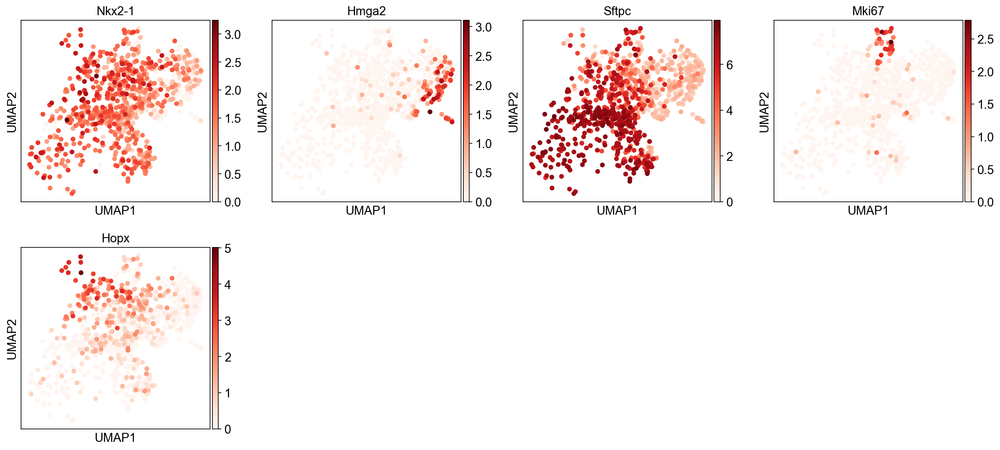

In [74]:
#Markers
sc.pl.umap(adata[adata.obs.Group=='8wk',:],color=['Nkx2-1','Hmga2','Sftpc','Mki67','Hopx'], save='Ext_Data_Fig5e_h_cell type markers-8wk.svg',cmap='Reds')
sc.pl.umap(adata[adata.obs.Group=='14wk',:],color=['Nkx2-1','Hmga2','Sftpc','Mki67','Hopx'], save='Fig2h_Ext_Data_Fig5h_cell type markers-14wk.svg',cmap='Reds')

## For Revision

In [75]:
adata_orig = load('write/combined_data.joblib').raw.to_adata()

In [76]:
adata2 = load('../../IGO16652_IGO16655/write/allmice-tumor-IGO16652_IGO16655-noPtprc.joblib')

### Try concatenation

In [77]:
adata_orig.obs.batch.value_counts()

batch
depletion           10763
Hopx-MACD           10508
traced               3176
untraced_14wk        1865
Hopx-MACD_traced     1069
Name: count, dtype: int64

In [78]:
adata_concat = adata_orig.concatenate(adata2, join="outer")

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/3254273629.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_concat = adata_orig.concatenate(adata2, join="outer")


In [79]:
sc.pp.highly_variable_genes(adata_concat, batch_key='batch')

extracting highly variable genes
    finished (0:00:14)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [80]:
adata_concat.var.highly_variable = adata_concat.var.highly_variable_intersection

In [81]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata_concat.var.highly_variable['EGFP'] = False
adata_concat.var.highly_variable['mScarlet'] = False
adata_concat.var.highly_variable['Cre'] = False
adata_concat.var.highly_variable['ERT'] = False
adata_concat.var.highly_variable['iDTR'] = False
adata_concat.var.highly_variable['tagBFP'] = False
adata_concat.var.highly_variable['mKate2'] = False
adata_concat.var.highly_variable['Akaluc'] = False
adata_concat.var.highly_variable['tdTomato'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/490956250.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_concat.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/

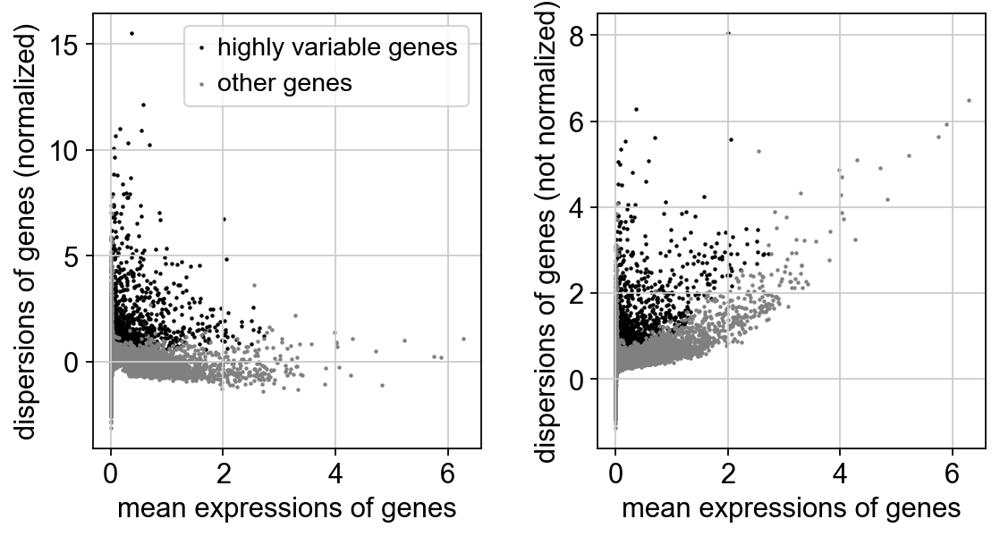

In [82]:
sc.pl.highly_variable_genes(adata_concat)

In [83]:
adata_concat.raw = adata_concat

In [84]:
sc.pp.scale(adata_concat, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [85]:
sc.tl.pca(adata_concat, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:05)


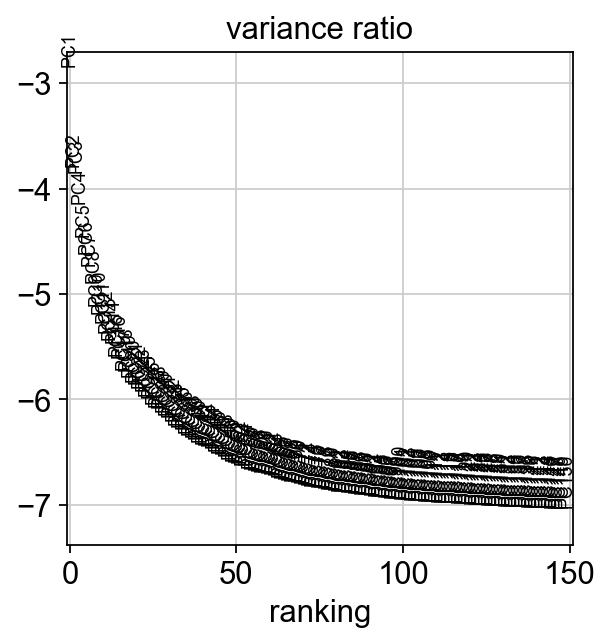

In [86]:
sc.pl.pca_variance_ratio(adata_concat, log=True, n_pcs=150)

In [87]:
sc.pp.neighbors(adata_concat, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:23)


In [88]:
sc.tl.umap(adata_concat)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:19)


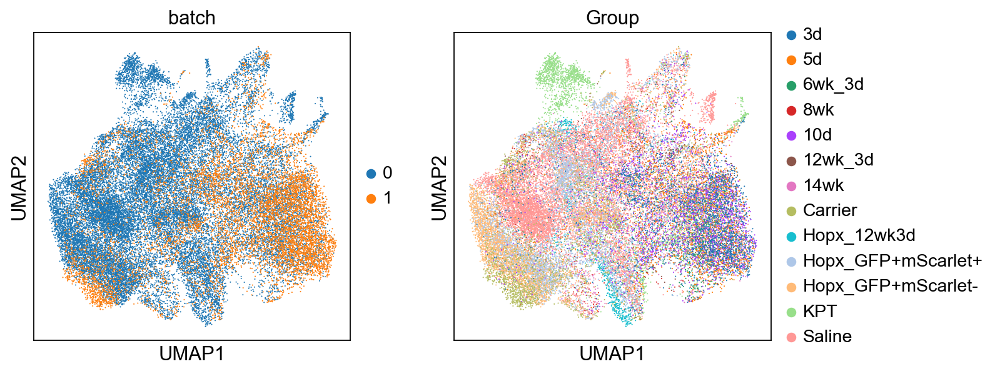

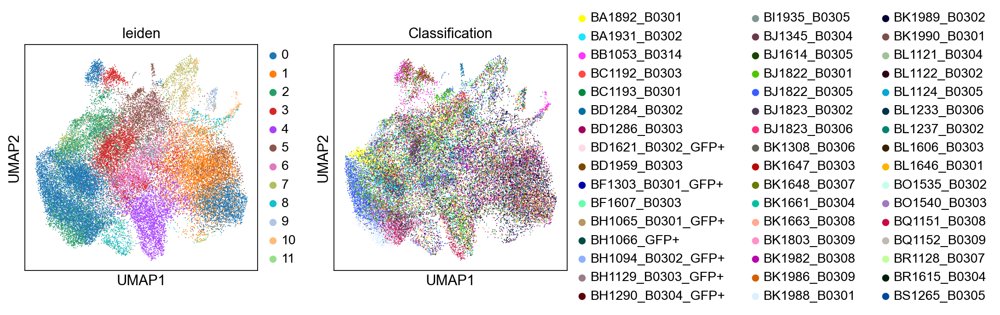

In [89]:
sc.pl.umap(adata_concat, color=['batch','Group'])
sc.pl.umap(adata_concat, color=['leiden','Classification',])

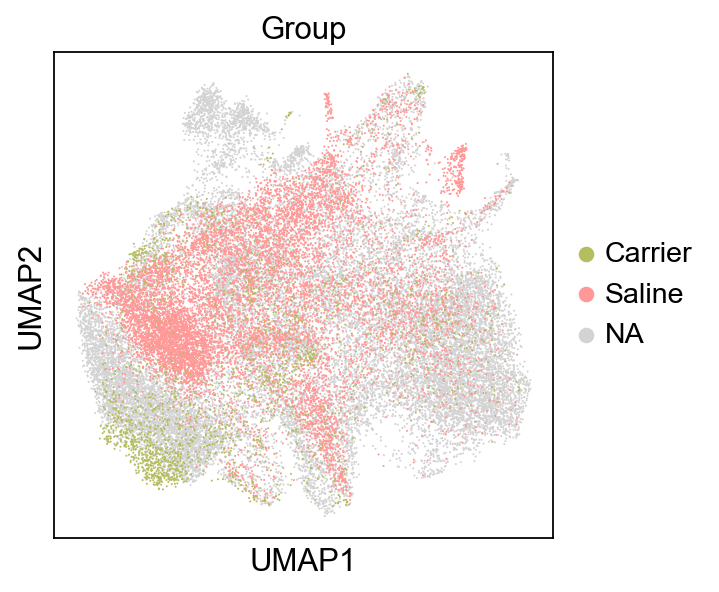

In [90]:
sc.pl.umap(adata_concat, color=['Group'], groups=['Saline', 'Carrier'])

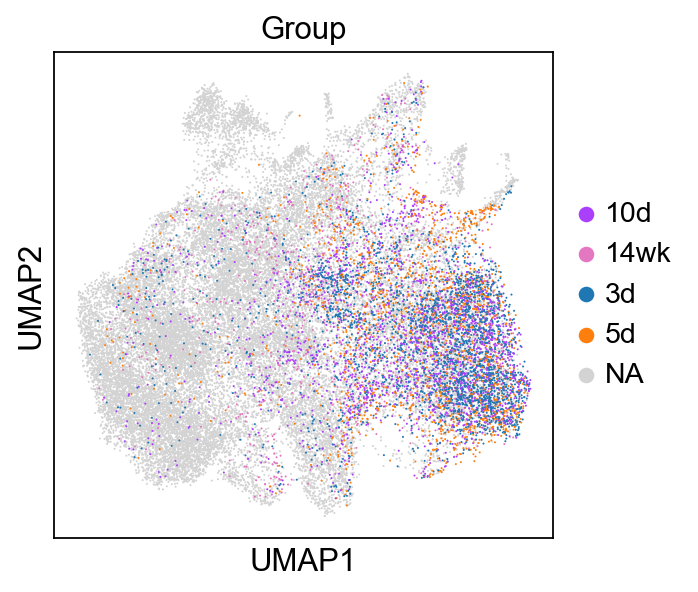

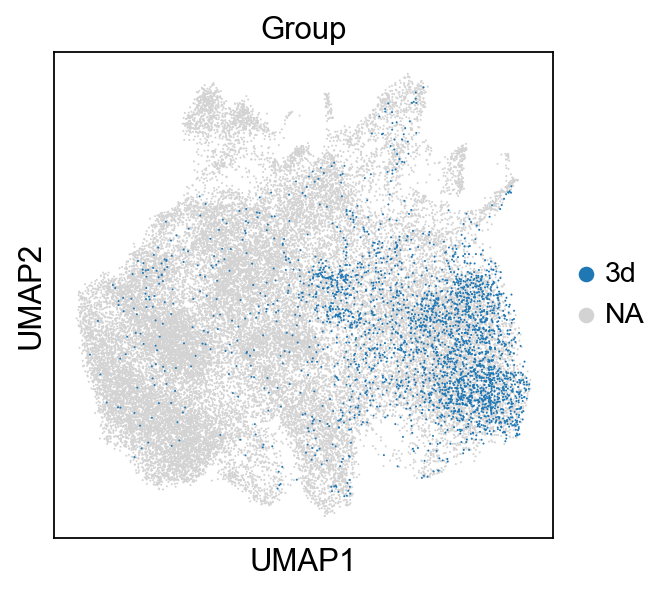

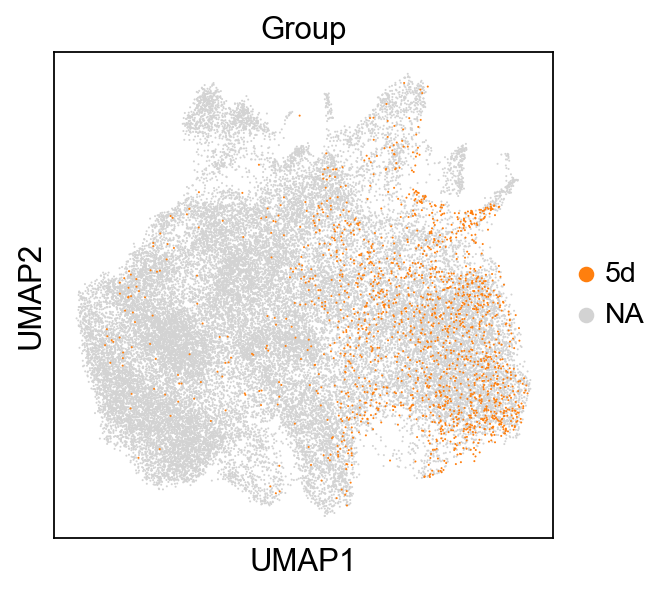

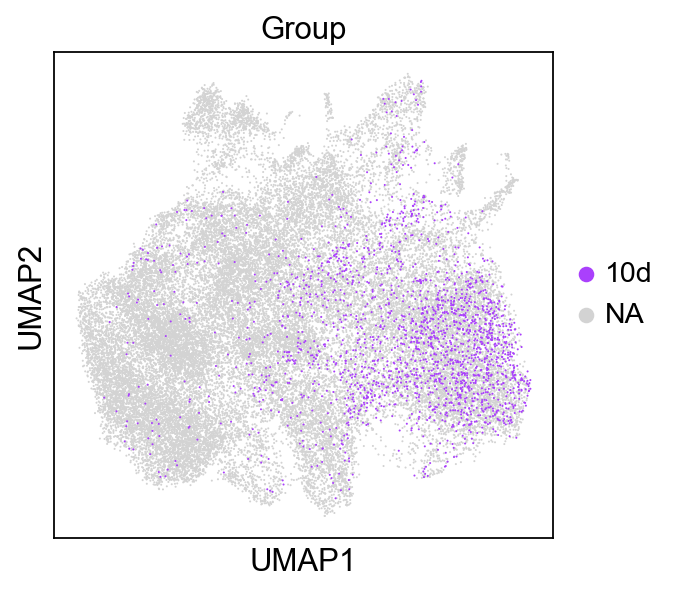

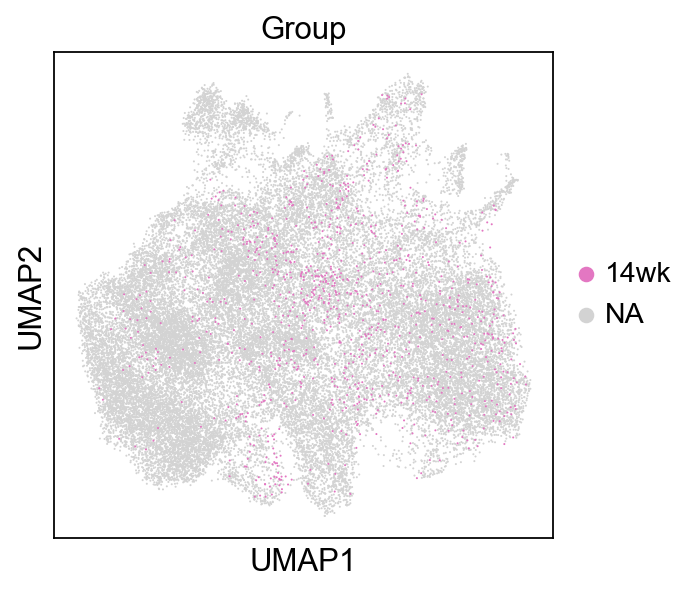

In [91]:
sc.pl.umap(adata_concat, color=['Group'], groups=['3d','5d','10d','14wk'])
sc.pl.umap(adata_concat, color=['Group'], groups=['3d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['5d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['10d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['14wk'])

In [92]:
sc.tl.embedding_density(adata_concat,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


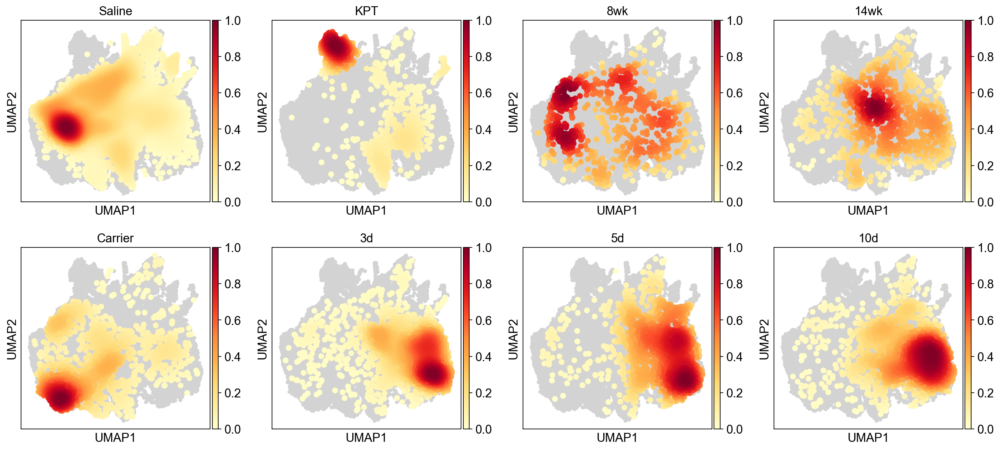

In [93]:
sc.pl.embedding_density(adata_concat,basis='umap',key='umap_density_Group', group=['Saline','KPT','8wk','14wk','Carrier','3d','5d','10d'])

### Logistic Regression

In [94]:
from sklearn.linear_model import LogisticRegression
from joblib import dump, load
names = load('../common_files/genes.joblib')

In [95]:
adata_log = adata_concat[:,adata_concat.var.index.isin(names)]

In [96]:
adata_names = [x for x in adata_log.var.index]

In [97]:
goi = [x for x in adata_log.var.index]

### Load SmartSeq h5ad file

In [98]:
smartseq = anndata.read('../Marjanovic_et_al_2020/write/Marjanovic_et_al_LUAD_data.h5ad')

/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


### Logistic Regression against Cancer Cell 2020 Clusters intersected with 10x data

In [99]:
from sklearn.model_selection import train_test_split

names_adata = smartseq[:,smartseq.var.index.isin(goi)]

X_train, X_test, y_train, y_test = train_test_split(names_adata.X, smartseq.obs['clusterK12'], test_size=0.25, random_state=250)

In [100]:
names = [x for x in names_adata.var.index]

In [101]:
# import the class
from sklearn.linear_model import LogisticRegression

# instantiate the model (using the default parameters)
logreg = LogisticRegression(random_state=250,multi_class='multinomial', solver='lbfgs')

# fit the model with data
logreg.fit(X_train, y_train)

y_pred = logreg.predict(X_test)
y_score = logreg.predict_proba(X_test)


In [102]:
# import the metrics class
from sklearn import metrics

cnf_matrix = metrics.confusion_matrix(y_test, y_pred)
cnf_matrix

array([[141,   6,   2,   0,   1,   1,   1,   0,   0,   0,   0,   0],
       [  9,  68,   0,   3,   0,   0,   0,   0,   0,   0,   0,   0],
       [  0,   0,  41,   0,   3,   0,   0,   2,   0,   1,   0,   0],
       [  1,   1,   0,  67,   0,   0,   0,   7,   1,   0,   0,   0],
       [  1,   0,   3,   0, 179,   1,   0,   4,   0,   0,   0,   1],
       [  0,   0,   0,   1,   0,  33,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  15,   0,   0,   0,   0,   0],
       [  0,   0,   1,   1,   1,   0,   0, 139,   1,   0,   0,   1],
       [  0,   0,   0,   1,   1,   0,   0,   1,  38,   1,   0,   0],
       [  0,   0,   1,   1,   3,   0,   0,   3,   0,  54,   0,   1],
       [  0,   0,   0,   0,   0,   0,   0,   0,   1,   0,  13,   0],
       [  0,   0,   0,   0,   1,   0,   0,   0,   1,   0,   0,  41]])

Text(0.5, 295.64444444444445, 'Predicted label')

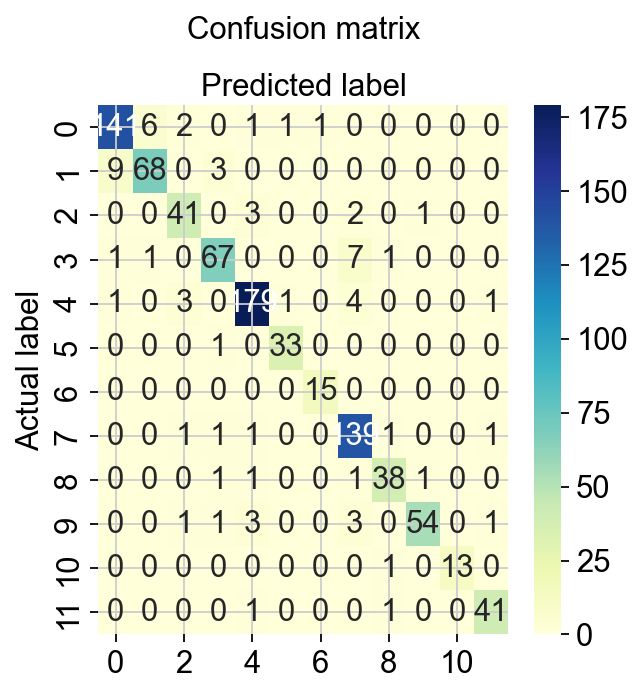

In [103]:
# import required modules
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class_names=[0,1] # name  of classes
fig, ax = plt.subplots()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks, class_names)
# create heatmap
sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
ax.xaxis.set_label_position("top")
plt.tight_layout()
plt.title('Confusion matrix', y=1.1)
plt.ylabel('Actual label')
plt.xlabel('Predicted label')

#Text(0.5,257.44,'Predicted label');

In [104]:
from sklearn.metrics import classification_report
target_names = ['1', '2', '3','4','5','6','7','8','9','10','11','12']
print(classification_report(y_test, y_pred, target_names=target_names))

              precision    recall  f1-score   support

           1       0.93      0.93      0.93       152
           2       0.91      0.85      0.88        80
           3       0.85      0.87      0.86        47
           4       0.91      0.87      0.89        77
           5       0.95      0.95      0.95       189
           6       0.94      0.97      0.96        34
           7       0.94      1.00      0.97        15
           8       0.89      0.97      0.93       144
           9       0.90      0.90      0.90        42
          10       0.96      0.86      0.91        63
          11       1.00      0.93      0.96        14
          12       0.93      0.95      0.94        43

    accuracy                           0.92       900
   macro avg       0.93      0.92      0.92       900
weighted avg       0.92      0.92      0.92       900



In [105]:
from sklearn.preprocessing import LabelBinarizer

label_binarizer = LabelBinarizer().fit(y_train)
y_onehot_test = label_binarizer.transform(y_test)
y_onehot_test.shape  # (n_samples, n_classes)

(900, 12)

In [106]:
class_of_interest = '09'
class_id = np.flatnonzero(label_binarizer.classes_ == class_of_interest)[0]
class_id

8

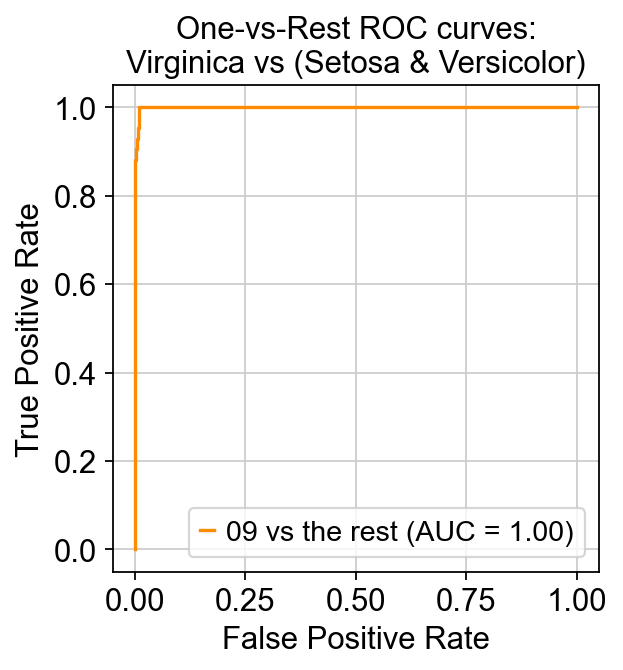

In [107]:
import matplotlib.pyplot as plt

from sklearn.metrics import RocCurveDisplay

RocCurveDisplay.from_predictions(
    y_onehot_test[:, class_id],
    y_score[:, class_id],
    name=f"{class_of_interest} vs the rest",
    color="darkorange",
    #plot_chance_level=True,
)
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\nVirginica vs (Setosa & Versicolor)")
plt.legend()
plt.show()

In [108]:
y_pred = logreg.predict(smartseq[:,names].X)
y_proba = logreg.predict_proba(smartseq[:,names].X)

In [109]:
smartseq.obs['clusterK12_intersecting'] = [x for x in y_pred]
smartseq.obs['clusterK12_intersecting'] = smartseq.obs['clusterK12_intersecting'].astype('category')

In [110]:
results_binary = logreg.predict(X_test)
probs_binary = logreg.predict_proba(X_test)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
results_df_binary['actual'] = list(y_test)
for x in range(0,12):
    results_df_binary["probability_%d" % (x+1)] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[["probability_%d" % (x+1) for x in range(0,12)]].max(axis=1)
results_df_binary['correct'] = (results_df_binary['predicted'] == results_df_binary['actual']).astype(int)
results_df_binary

,predicted,actual,probability_1,probability_2,probability_3,probability_4,probability_5,probability_6,probability_7,probability_8,probability_9,probability_10,probability_11,probability_12,highest_prob,correct
0,08,03,2.024733e-08,1.193001e-04,1.360919e-01,2.234624e-02,1.590459e-06,4.950356e-05,4.384334e-04,8.402771e-01,3.068069e-06,2.946426e-05,2.494301e-05,6.184840e-04,0.840277,0
1,01,01,9.999900e-01,2.606586e-07,1.334730e-08,9.261363e-08,1.187713e-07,1.173115e-06,8.185733e-06,3.118667e-10,2.803527e-09,7.240798e-09,1.195354e-07,8.277613e-09,0.999990,1
2,08,08,3.901781e-09,2.387097e-07,3.324283e-07,1.898129e-06,6.508430e-06,7.807842e-07,3.181202e-05,9.999028e-01,8.099331e-06,4.187792e-05,5.262991e-06,4.179326e-07,0.999903,1
3,05,10,4.256196e-08,7.174518e-06,2.530812e-05,3.727557e-07,5.077934e-01,6.263545e-04,6.877741e-05,3.589147e-05,3.351415e-04,4.901153e-01,7.320659e-05,9.190050e-04,0.507793,0
4,08,08,7.330879e-08,4.237366e-07,6.107412e-08,3.636460e-06,1.345852e-05,1.366528e-06,1.157134e-04,9.995716e-01,2.652963e-04,1.620757e-05,6.501900e-06,5.620280e-06,0.999572,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
895,05,05,2.626773e-04,1.624163e-07,3.106699e-06,3.877330e-05,9.900777e-01,4.738424e-03,3.370961e-04,2.181050e-03,6.927437e-04,1.487783e-03,1.689380e-04,1.152039e-05,0.990078,1
896,05,05,3.041426e-10,3.394007e-07,2.402987e-07,1.828173e-07,9.999853e-01,7.097324e-06,3.560938e-07,5.664735e-10,1.194156e-07,2.437135e-07,5.167737e-06,9.417700e-07,0.999985,1
897,08,08,2.355620e-06,5.963603e-05,8.044133e-06,1.230088e-02,5.077450e-08,4.251771e-06,8.956648e-05,9.862628e-01,1.079968e-03,1.487867e-04,2.007523e-05,2.355954e-05,0.986263,1
898,05,05,6.279537e-11,1.954838e-07,4.080871e-06,8.044004e-12,9.999944e-01,5.488562e-08,2.777840e-07,4.053856e-07,6.315053e-08,6.833435e-08,3.270018e-07,1.068356e-07,0.999994,1


In [111]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','correct','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high,correct
0,0.36-0.87,0.362248,0.873162,0.612403
1,0.87-0.98,0.873162,0.981001,0.906250
2,0.98-1.0,0.981001,0.996441,0.945736
3,1.0-1.0,0.998993,0.999880,0.996109


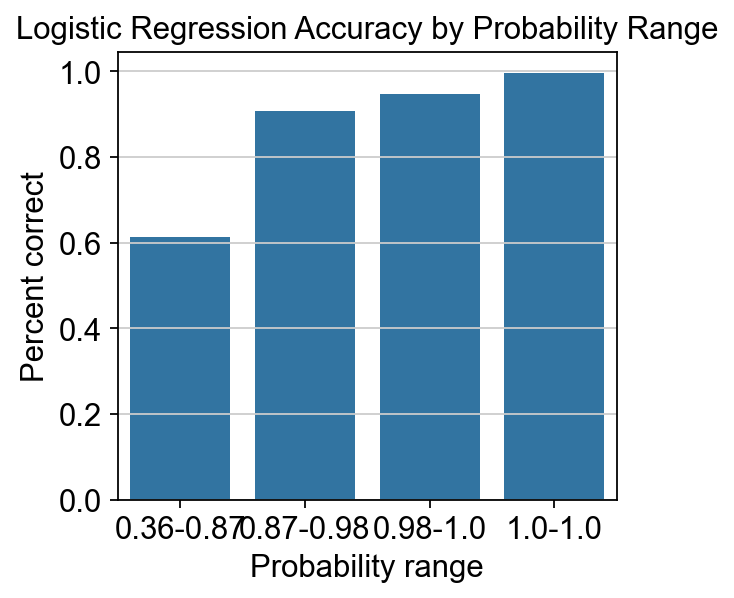

In [112]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(4,4))
plt.subplots_adjust(top=0.85)

ax = sns.barplot(x='prob range', y='correct', data=df_bins_grouped)
plt.title("Logistic Regression Accuracy by Probability Range")
plt.ylabel('Percent correct')
plt.xlabel('Probability range')
plt.show()

In [113]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

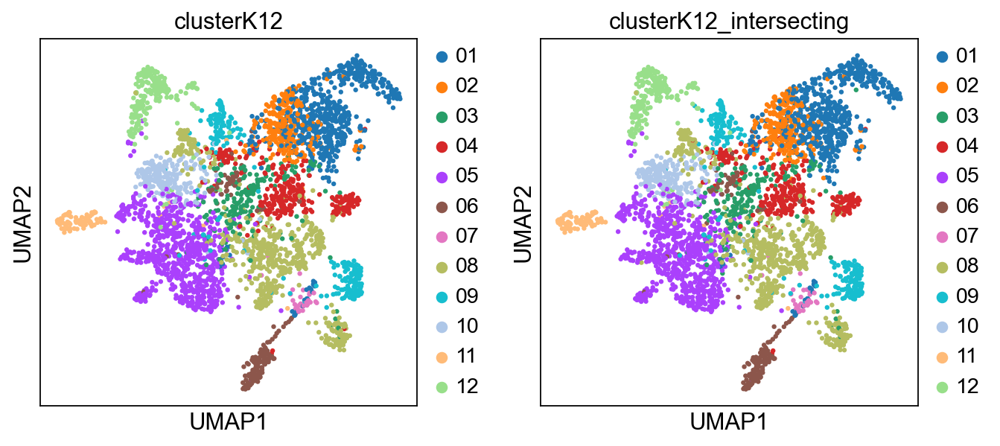

In [114]:
sc.pl.umap(smartseq, color=['clusterK12','clusterK12_intersecting'])

In [115]:
dict = {1: "01", 2: "02", 3: "03", 4: "04", 5: "05", 6: "06", 7: "07", 8: "08", 9: "09", 10: "10", 11: "11", 12: "12"}

In [116]:
from sklearn.metrics import accuracy_score
accuracy_score(smartseq.obs.replace({"clusterK12": dict})['clusterK12'], smartseq.obs['clusterK12_intersecting'])

0.9802777777777778

In [117]:
results_binary = logreg.predict(smartseq[:,names].X)
probs_binary = logreg.predict_proba(smartseq[:,names].X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)

for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,11,1.079023e-12,1.453921e-10,9.199541e-11,2.947902e-13,1.341452e-08,2.662035e-11,4.181171e-09,8.226695e-12,1.839834e-10,8.085645e-11,1.000000e+00,1.255878e-09,1.000000
1,12,2.123903e-10,2.626507e-11,9.314639e-11,2.597986e-09,2.626694e-09,9.591519e-07,1.731984e-08,4.304893e-08,1.126615e-07,4.636917e-07,9.720245e-09,9.999984e-01,0.999998
2,05,8.925460e-04,2.348204e-07,3.523692e-04,1.604098e-07,9.987312e-01,1.795393e-05,6.999716e-07,1.102849e-10,2.722909e-07,9.975674e-07,8.959291e-07,2.696706e-06,0.998731
3,10,5.192333e-07,4.058507e-07,4.899529e-07,1.824765e-03,7.023358e-07,9.640610e-06,7.509113e-06,2.602576e-03,9.009416e-06,9.955219e-01,4.430019e-06,1.800731e-05,0.995522
4,01,9.999964e-01,5.598767e-09,1.451876e-06,1.631412e-06,9.838237e-09,1.016262e-07,7.136127e-08,2.085584e-10,1.769480e-10,7.336746e-09,3.131001e-07,1.719759e-08,0.999996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3595,08,3.035559e-10,9.057235e-08,6.798166e-09,1.323402e-07,1.239356e-08,7.121993e-09,5.557090e-07,9.999959e-01,3.068574e-06,1.402991e-07,5.719076e-08,9.393428e-09,0.999996
3596,09,8.182234e-08,2.469212e-07,1.202042e-07,7.787092e-08,1.187730e-06,5.844187e-08,1.312787e-06,3.732995e-04,9.996199e-01,2.554051e-07,3.316047e-06,1.131491e-07,0.999620
3597,08,3.570496e-08,3.934607e-06,8.143276e-08,4.213077e-05,2.403487e-08,5.465755e-08,6.944887e-06,9.998498e-01,9.138945e-05,2.638795e-06,2.127800e-06,8.772187e-07,0.999850
3598,08,8.022182e-09,2.170156e-06,2.817636e-06,1.695398e-06,4.154154e-04,2.097533e-07,1.025989e-05,9.995378e-01,9.203934e-06,1.439988e-05,4.129055e-06,1.917060e-06,0.999538


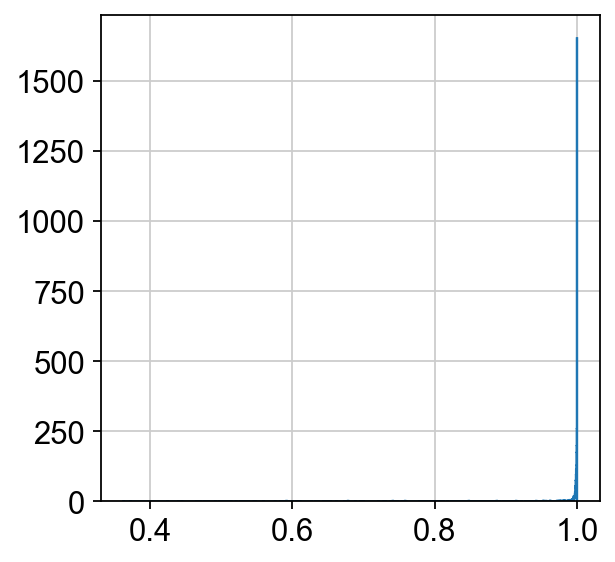

In [118]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto', histtype='step')

### End LogisticRegression

In [119]:
adata_ordered_genes = [adata_names.index(x) for x in names]

In [120]:
adata_log_ordered = adata_log[:,adata_ordered_genes]

In [121]:
y_pred = logreg.predict(adata_log_ordered.X)

In [122]:
adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]
adata_log_ordered.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/3908199522.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_log_ordered.obs['clusterK12'] = [x for x in y_pred]


In [123]:
#reset size
from matplotlib import rcParams
FIGSIZE=(4,4)
rcParams['figure.figsize']=FIGSIZE

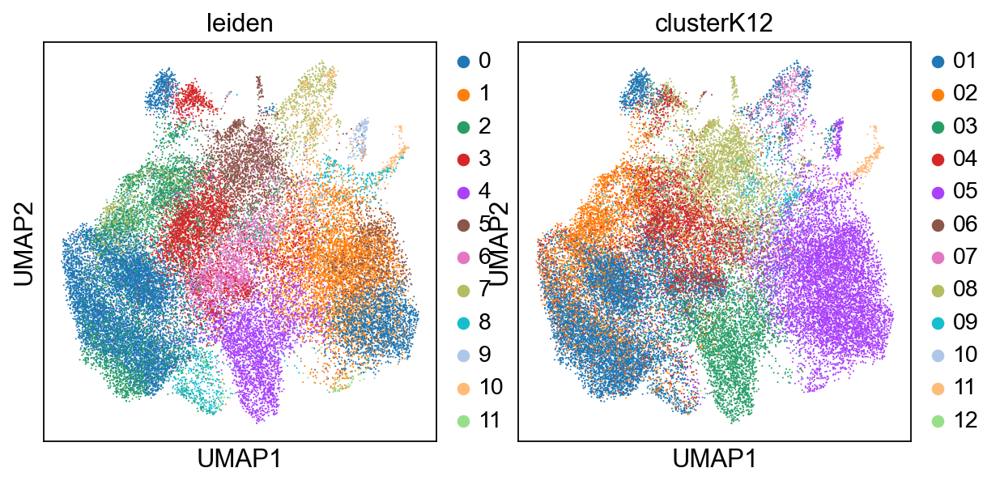

In [124]:
sc.pl.umap(adata_log_ordered,color=['leiden','clusterK12'], wspace=0.1)

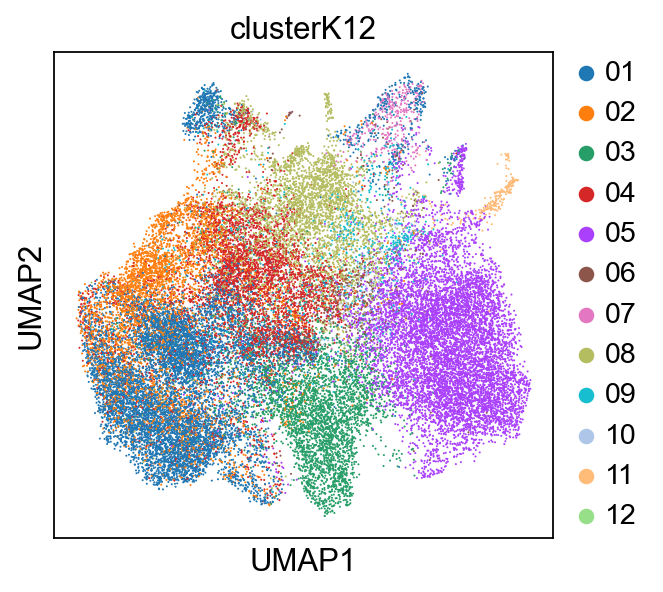

In [125]:
sc.pl.umap(adata_log_ordered,color=['clusterK12'])

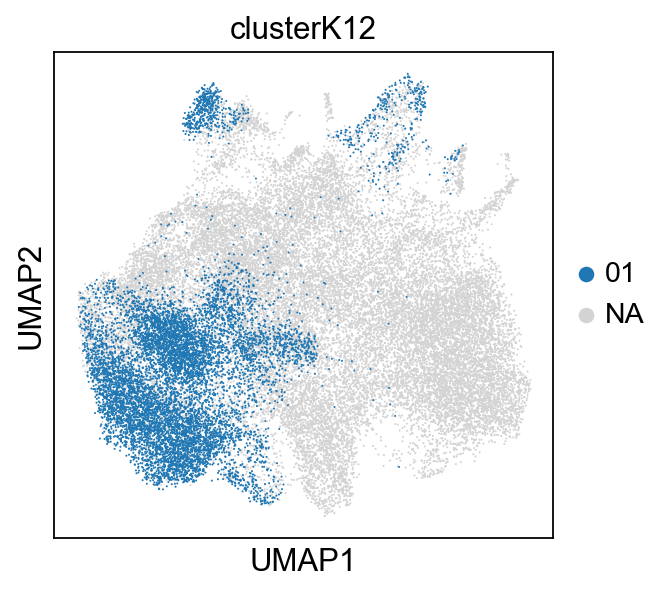

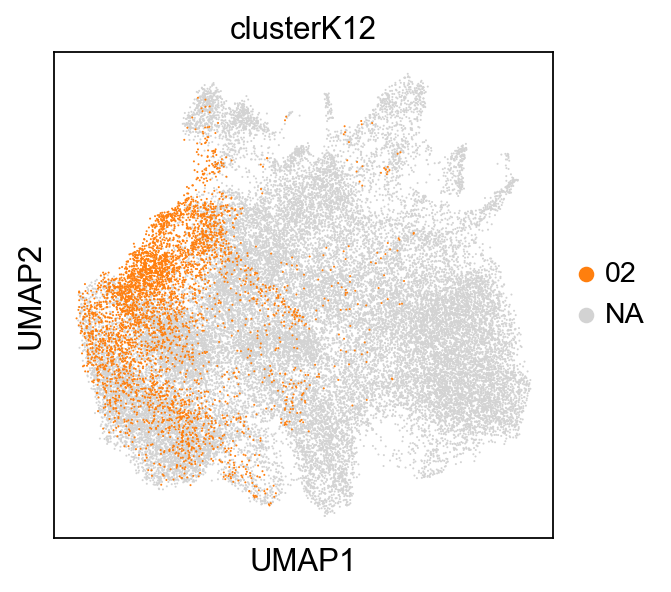

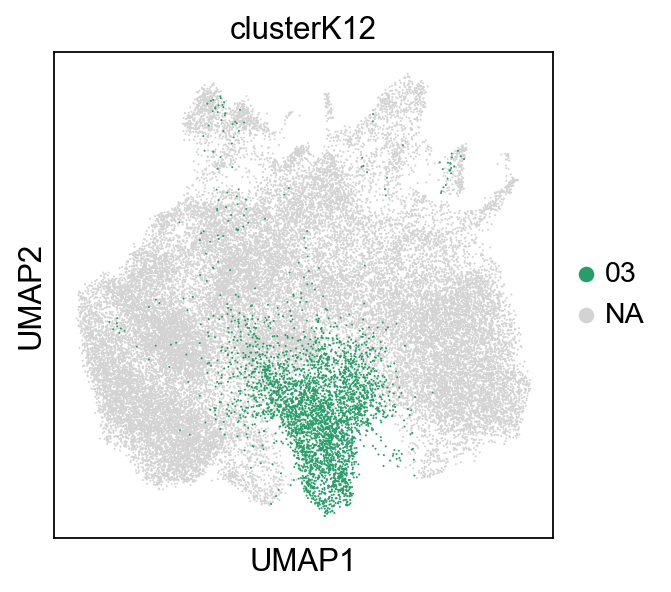

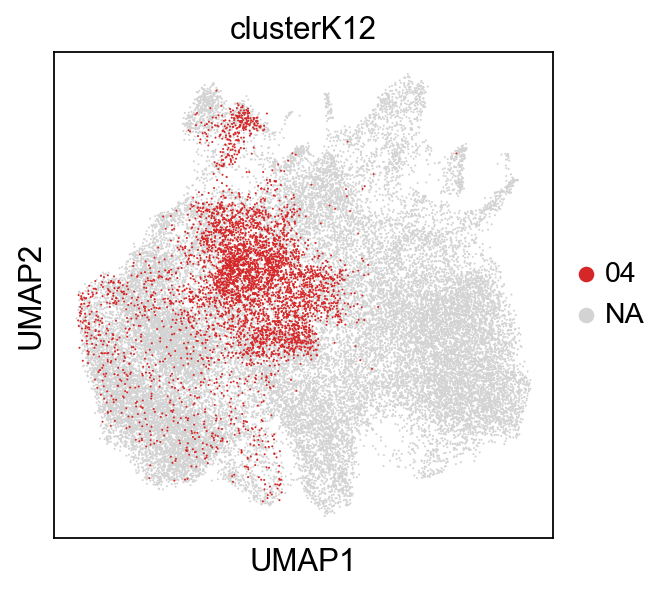

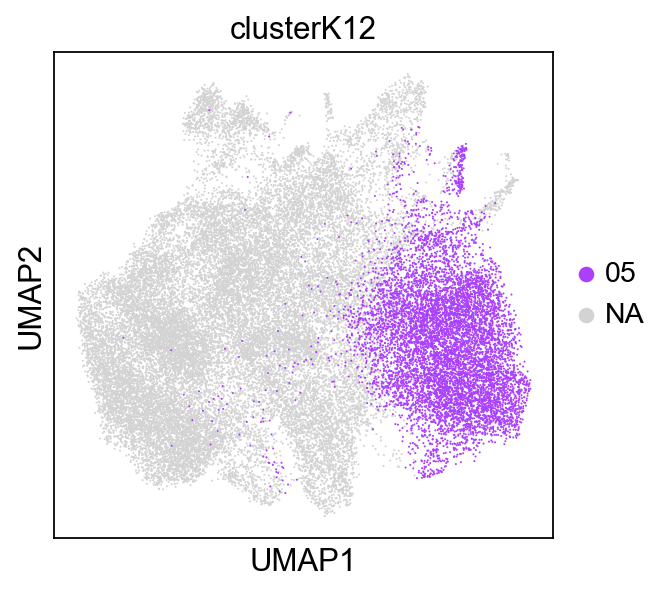

...

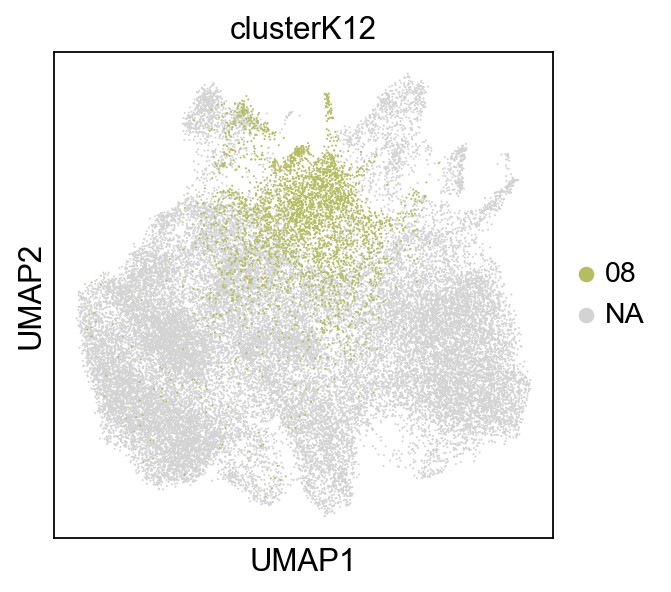

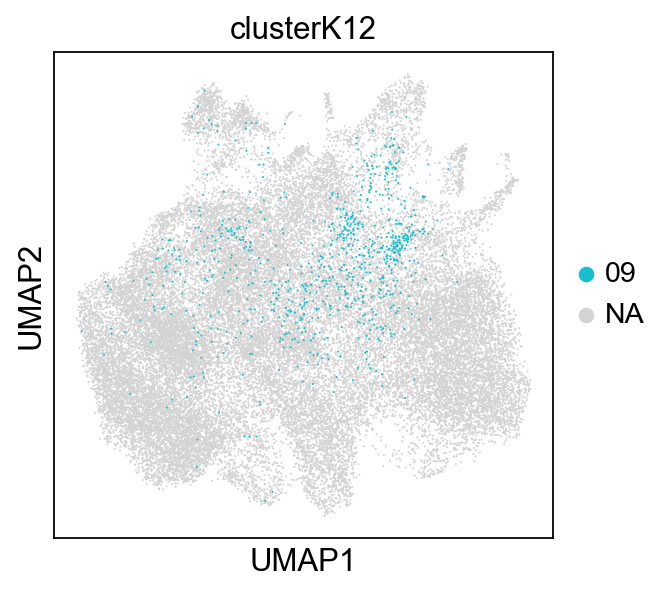

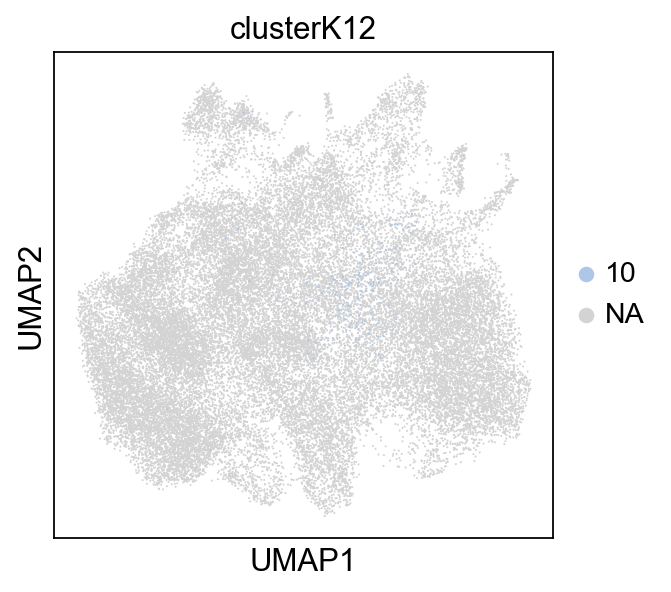

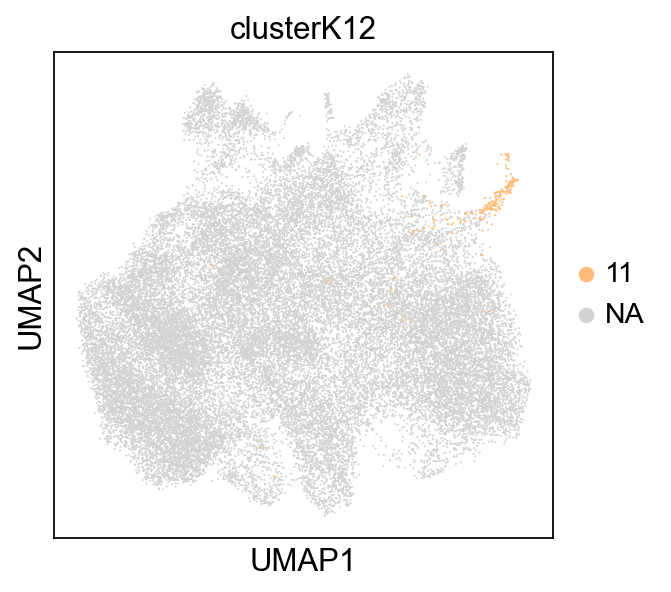

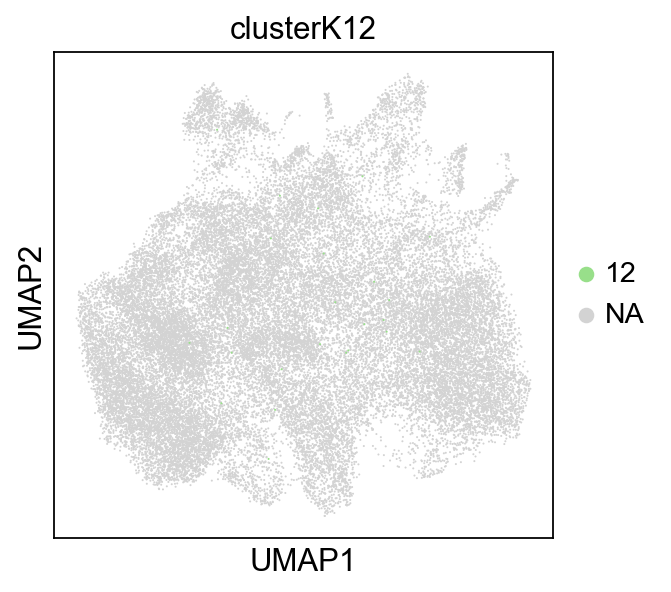

In [126]:
for x in adata_log_ordered.obs.clusterK12.cat.categories:
    sc.pl.umap(adata_log_ordered,color=['clusterK12'], groups=[x])

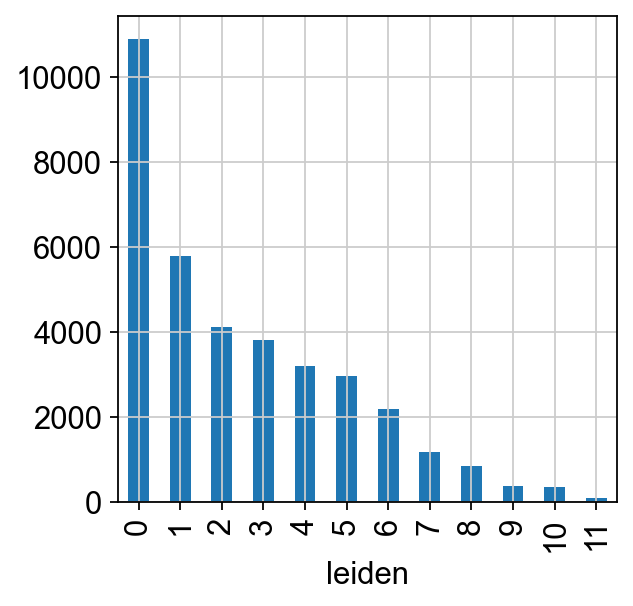

In [127]:
 cell_proportion_df = adata_log_ordered.obs.leiden.value_counts().T.plot(kind='bar', stacked=True, legend=False)

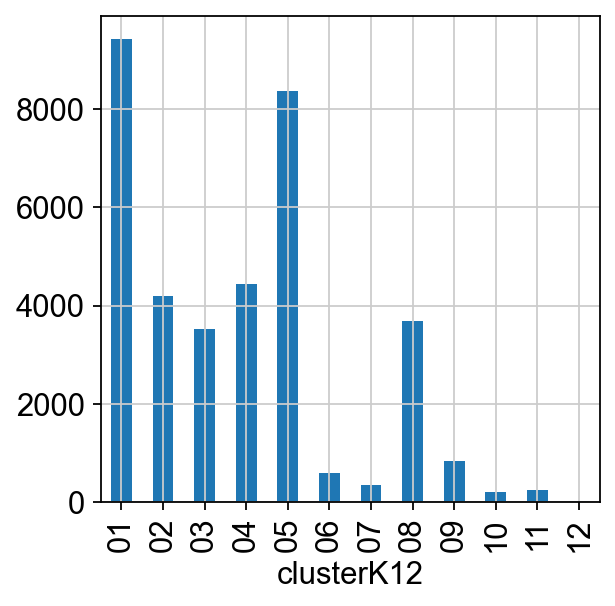

In [128]:
 cell_proportion_df = adata_log_ordered.obs.clusterK12.value_counts(sort=False).T.plot(kind='bar', stacked=True, legend=False)

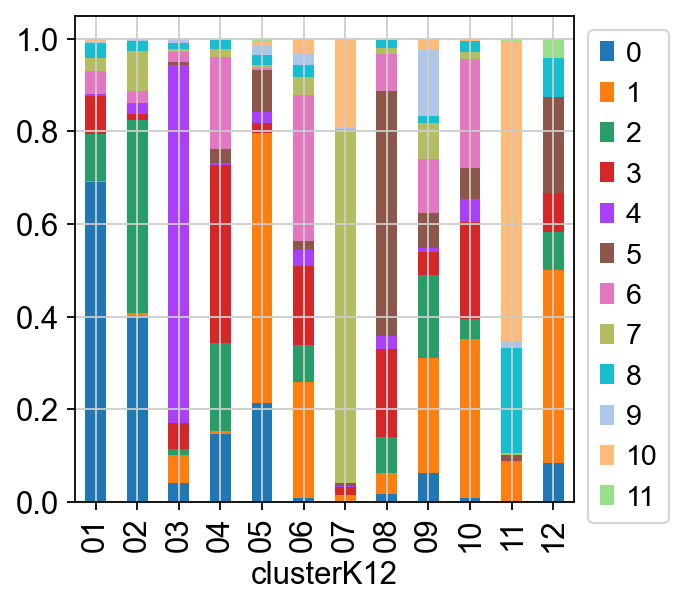

In [129]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

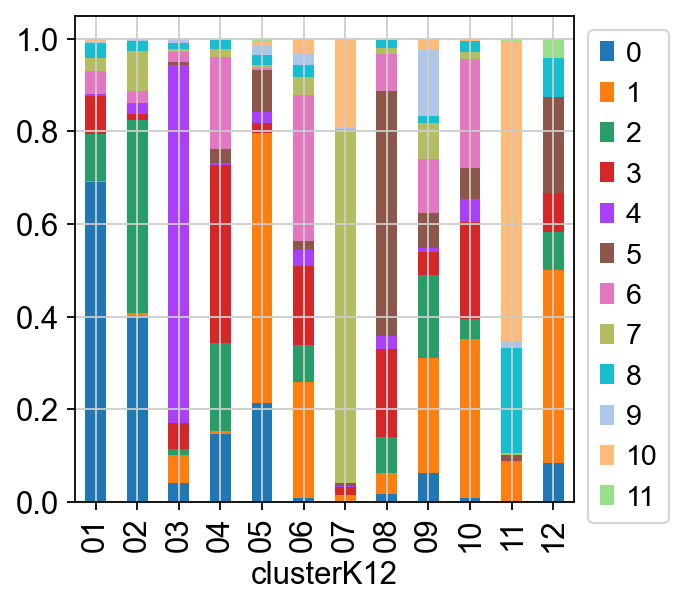

In [130]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

In [131]:
results_binary = logreg.predict(adata_log_ordered.X)
probs_binary = logreg.predict_proba(adata_log_ordered.X)

results_df_binary = pd.DataFrame()
results_df_binary['predicted'] = list(results_binary)
#results_df_binary['actual'] = list(smartseq.obs['clusterK12'])
for x in range(0,12):
    results_df_binary[x+1] = [i[x] for i in list(probs_binary)]
results_df_binary['highest_prob'] =results_df_binary[[x+1 for x in range(0,12)]].max(axis=1)
results_df_binary

,predicted,1,2,3,4,5,6,7,8,9,10,11,12,highest_prob
0,03,1.184854e-05,1.298899e-02,8.990797e-01,2.448890e-03,2.817335e-03,4.384296e-02,8.599242e-04,6.847107e-04,0.002337,2.749520e-02,0.002587,4.845953e-03,0.899080
1,01,4.180860e-01,6.583214e-03,1.157456e-03,3.343959e-01,4.111344e-05,3.663941e-03,1.491994e-02,1.681708e-01,0.030206,1.022522e-02,0.006534,6.016176e-03,0.418086
2,01,2.808779e-01,2.300939e-03,2.264935e-02,1.988686e-01,3.361552e-04,1.421202e-01,7.737588e-03,6.520432e-02,0.155714,3.334457e-02,0.015844,7.500189e-02,0.280878
3,03,6.586893e-05,4.722620e-04,8.126071e-01,3.605976e-04,6.989458e-02,1.229296e-03,2.374860e-03,6.604553e-02,0.024409,1.826362e-02,0.001641,2.635897e-03,0.812607
4,08,2.696532e-06,1.867622e-06,3.928311e-04,1.189035e-04,1.120484e-05,7.707990e-05,1.545866e-04,9.965110e-01,0.000009,1.169846e-03,0.000066,1.485257e-03,0.996511
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35862,05,8.860476e-07,1.604171e-04,1.473277e-03,2.946861e-07,9.963660e-01,1.199253e-03,8.173449e-05,7.738754e-05,0.000012,1.138357e-04,0.000097,4.183866e-04,0.996366
35863,05,5.863936e-09,2.043693e-06,5.055216e-07,1.544117e-09,9.999192e-01,9.104378e-07,3.976448e-06,8.617371e-07,0.000015,9.423953e-07,0.000046,1.018379e-05,0.999919
35864,05,2.434200e-10,6.019013e-08,9.687388e-08,1.133200e-09,9.999925e-01,5.051435e-07,1.743667e-07,2.994754e-09,0.000003,8.999247e-07,0.000002,9.598749e-07,0.999992
35865,04,1.969328e-07,9.057858e-04,1.252281e-05,9.713225e-01,7.140785e-07,8.256321e-05,9.288264e-05,2.667202e-02,0.000088,7.279570e-04,0.000038,5.671647e-05,0.971323


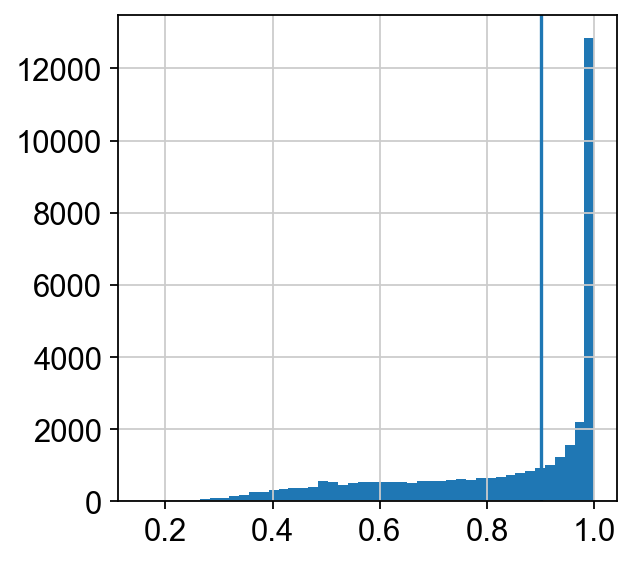

In [132]:
_ = plt.hist(results_df_binary['highest_prob'], bins='auto')
plt.axvline(x=0.9)

In [133]:
results_df_binary['bin'] = pd.qcut(results_df_binary['highest_prob'], q=7)
idx = pd.IntervalIndex(results_df_binary['bin'])
results_df_binary['low'] = idx.left
results_df_binary['high'] = idx.right
results_df_binary['prob range'] = results_df_binary['low'].round(2).astype(str) + "-" + results_df_binary['high'].round(2).astype(str)
df_bins_grouped = results_df_binary[['low','high','prob range']].groupby('prob range').mean().reset_index()
df_bins_grouped

,prob range,low,high
0,0.15-0.56,0.1536,0.5581
1,0.56-0.73,0.5581,0.7315
2,0.73-0.87,0.7315,0.8742
3,0.87-0.96,0.8742,0.9598
4,0.96-0.99,0.9598,0.9937
5,0.99-1.0,0.9937,0.9998
6,1.0-1.0,0.9998,1.0000


In [134]:
cutoff = 0.8
adata_log_ordered.obs['clusterK12_stringent'] = 'other'
adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % y for y in results_df_binary[[x+1 for x in range(0,12)]].idxmax(axis=1)[np.array(results_df_binary['highest_prob'] >= cutoff)].to_numpy()]

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/4020989001.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_log_ordered.obs['clusterK12_stringent'][np.array(results_df_binary['highest_prob'] >= cutoff)] = ["%02d" % 

In [135]:
adata_log_ordered.obs['clusterK12_stringent']

AAACCCAGTAGCGTAG-1-14wk-traced-0       03
AAACGAATCAAGTCGT-1-14wk-traced-0    other
AAAGAACAGATGACAT-1-14wk-traced-0    other
AAAGGGCTCACTTGTT-1-14wk-traced-0       03
AAAGGTATCCATAGGT-1-14wk-traced-0       08
                                    ...  
TGTCTTGCACTTCGGT-1-1-1                 05
TGTGCATGTCTGGCTA-1-1-1                 05
TGTGCATGTGGCTGCT-1-1-1                 05
TGTGCTGGTATGGTTC-1-1-1                 04
TGTGGTTGTCTAGCTG-1-1-1                 05
Name: clusterK12_stringent, Length: 35867, dtype: object

In [136]:
adata_log_ordered.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

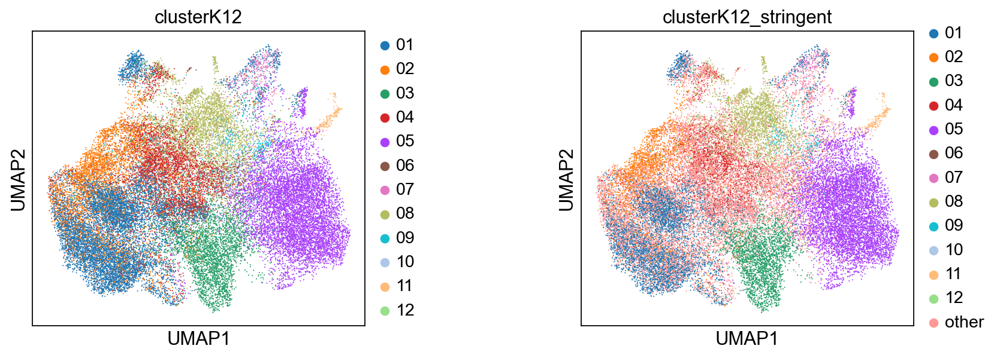

In [137]:
sc.pl.umap(adata_log_ordered, color=['clusterK12', 'clusterK12_stringent'], wspace=0.5)

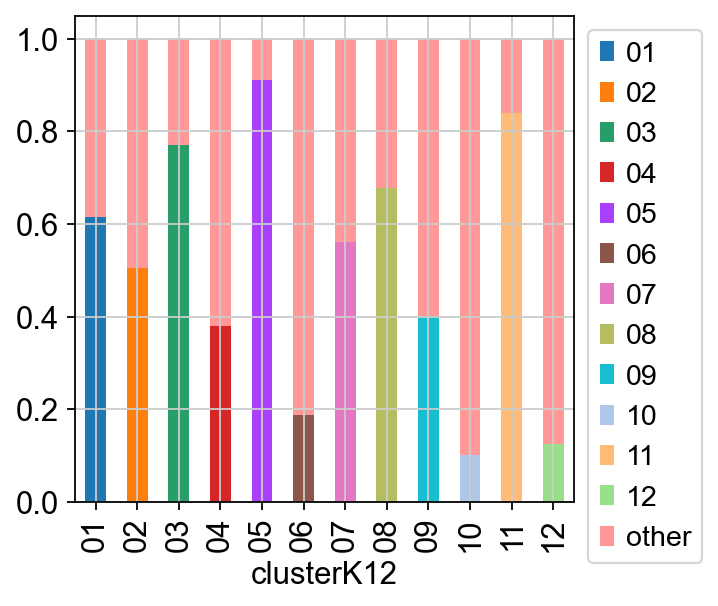

In [138]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['clusterK12_stringent'],adata_log_ordered.obs['clusterK12'],normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

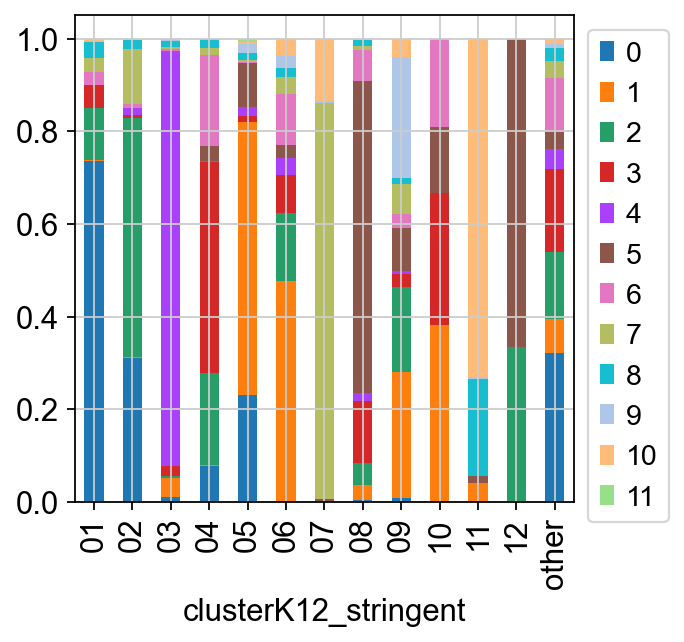

In [139]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

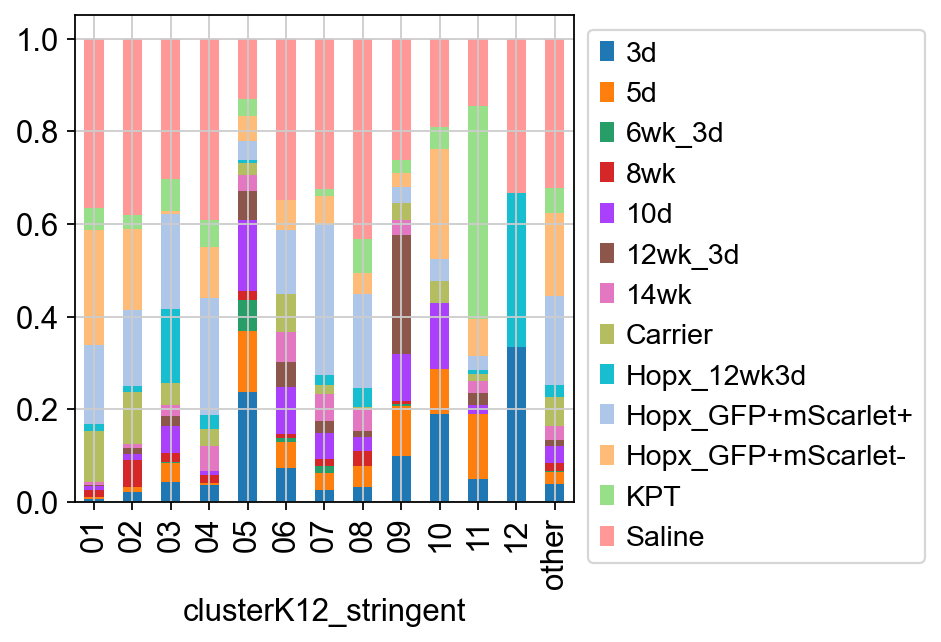

In [140]:
 cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Group'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

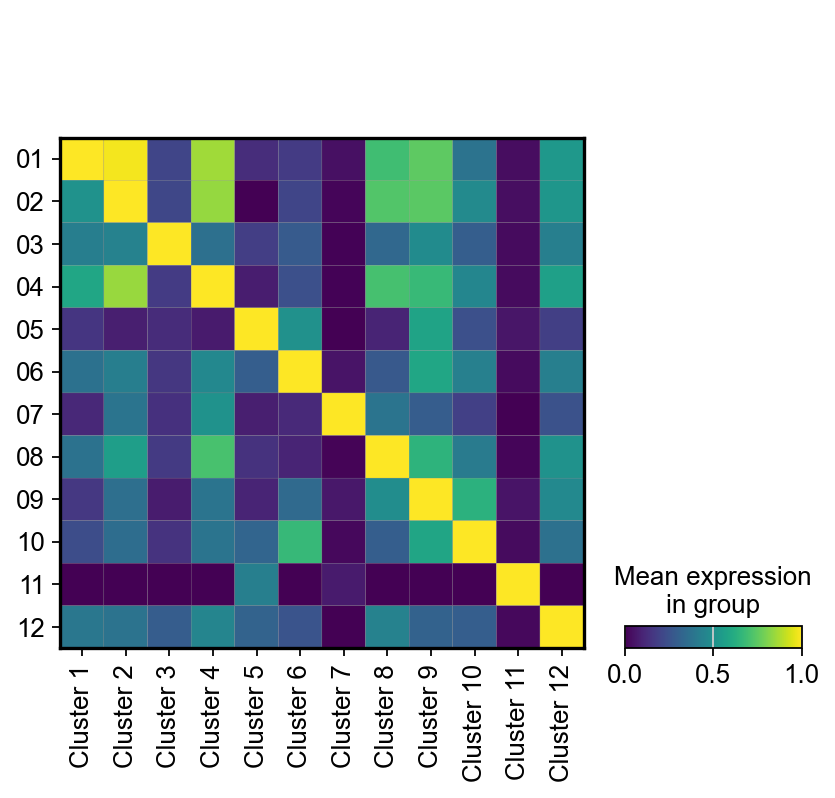

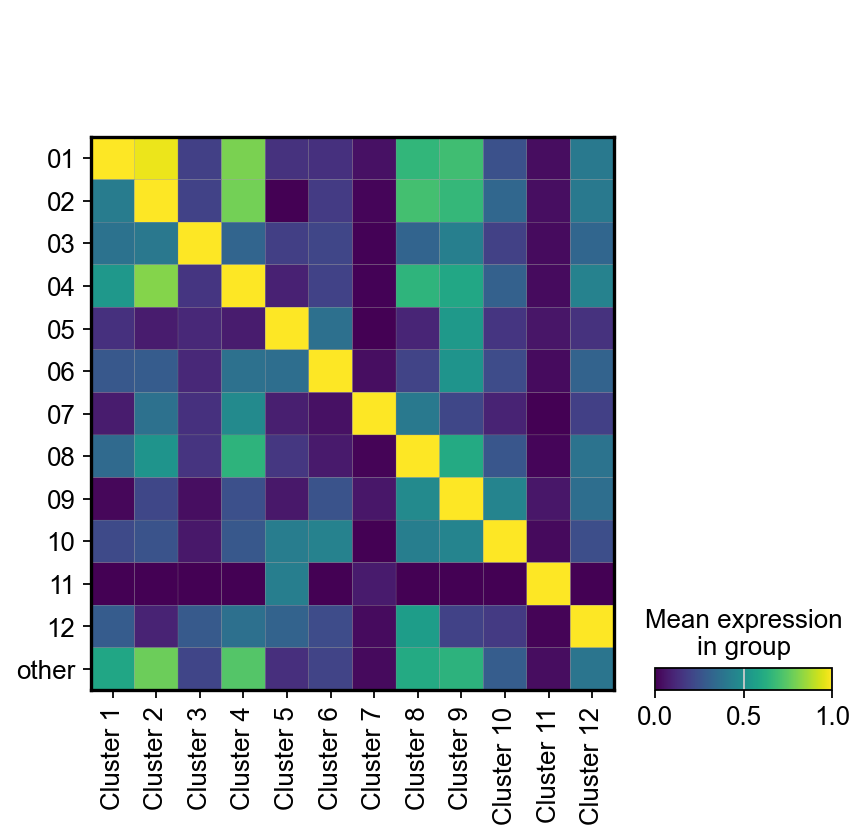

In [141]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']
#cell_proportion_df = pd.crosstab(adata_log_ordered.obs['Cluster 1'],adata_log_ordered.obs['clusterK12']).T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12', standard_scale='var')
sc.pl.matrixplot(adata_log_ordered, cancerCell, 'clusterK12_stringent', standard_scale='var')

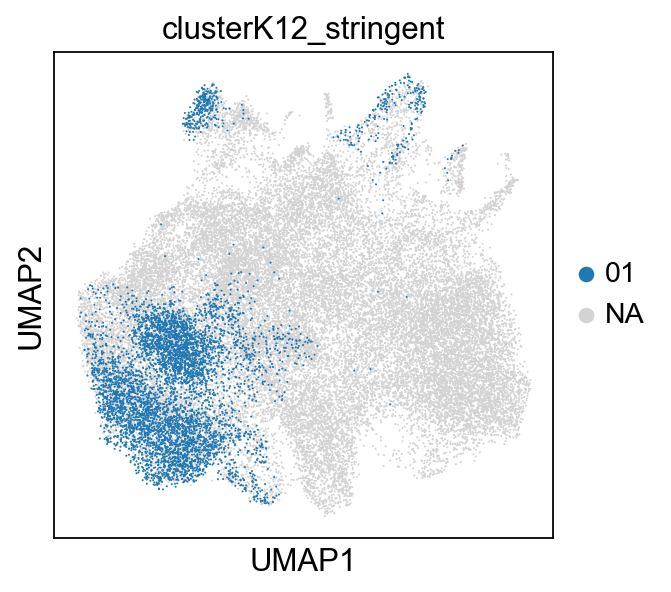

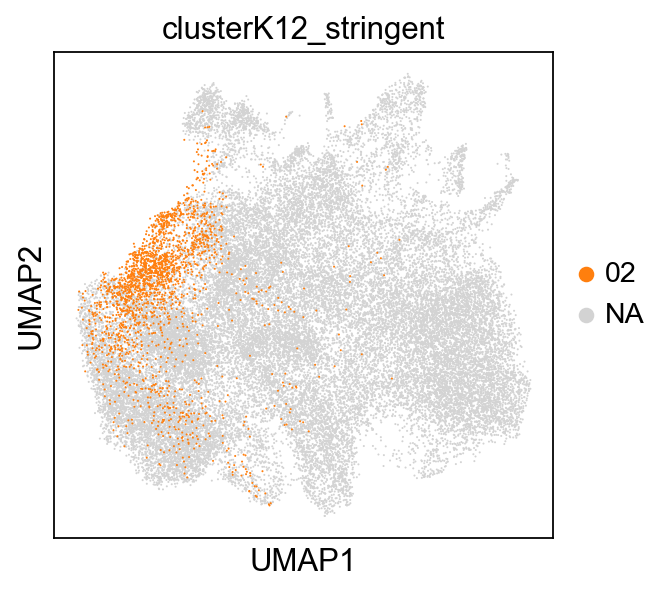

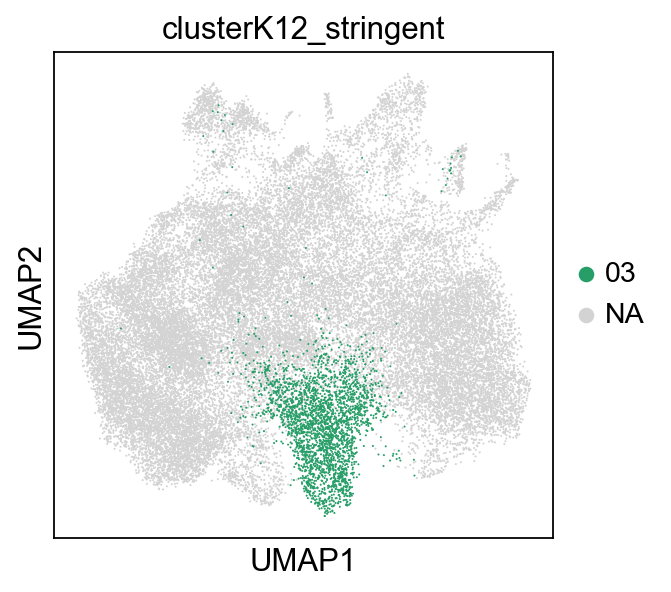

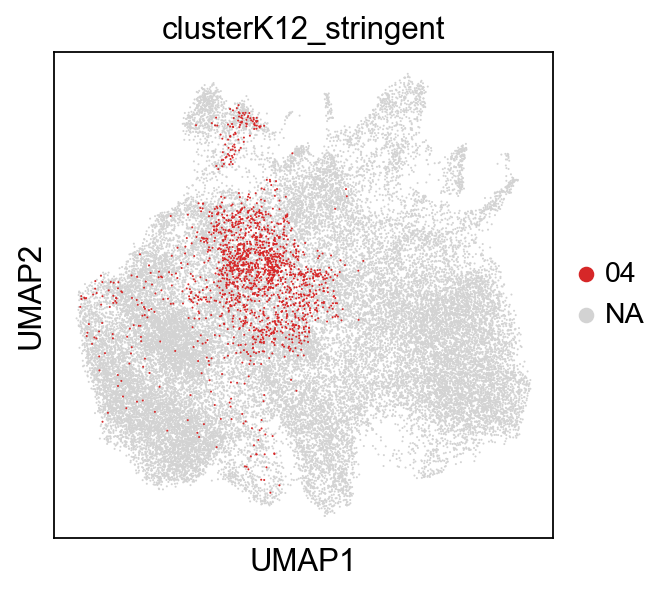

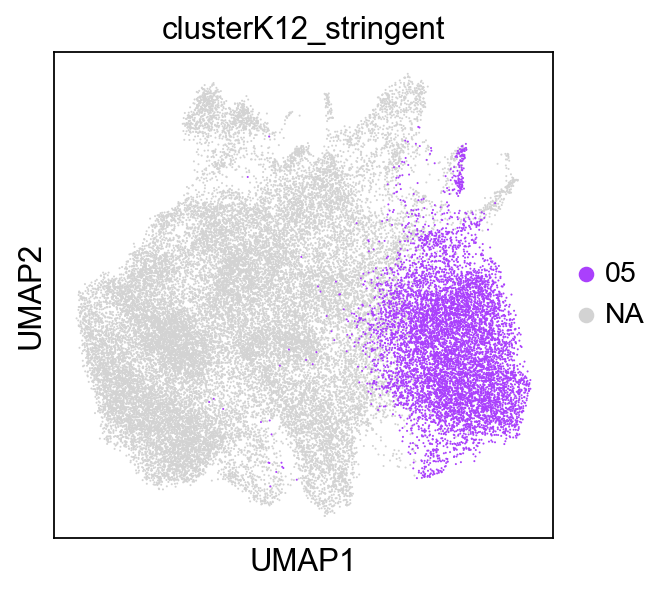

...

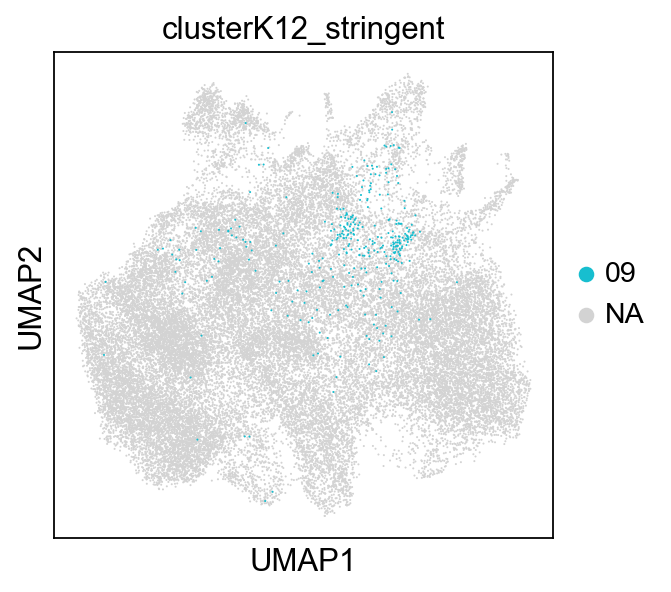

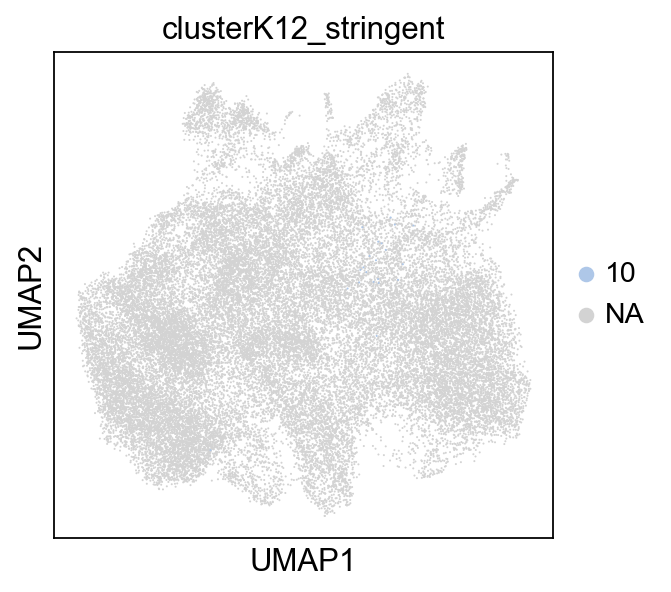

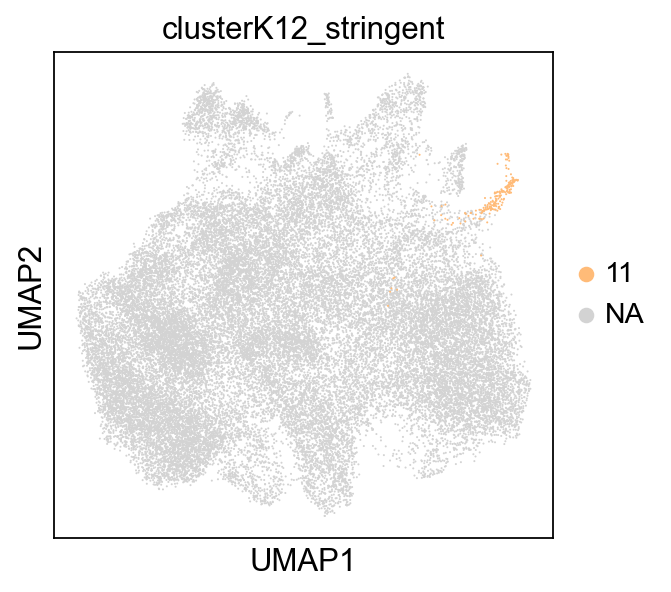

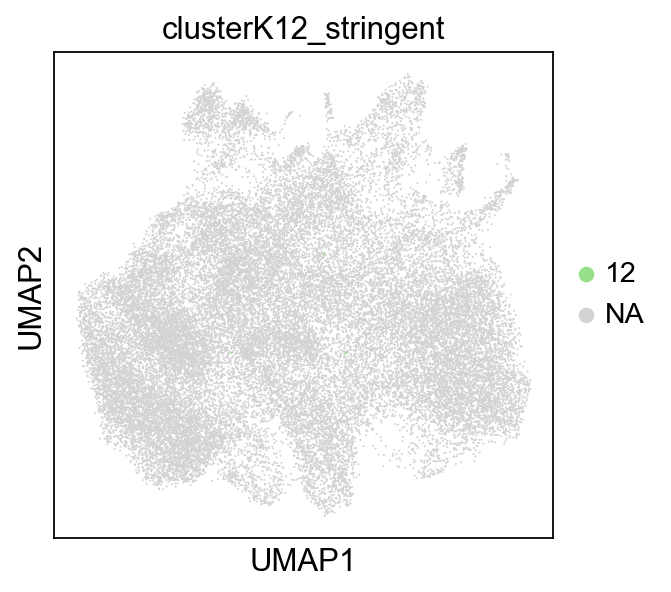

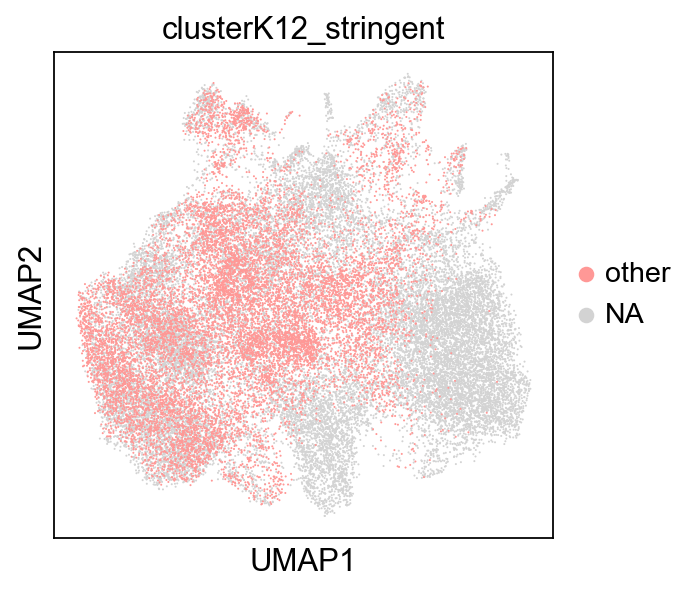

In [142]:
for x in adata_log_ordered.obs.clusterK12_stringent.cat.categories:
    # skip if NA
    sc.pl.umap(adata_log_ordered, color='clusterK12_stringent', groups=[x])

In [143]:
cancerCell = ['Cluster 1', 'Cluster 2','Cluster 3','Cluster 4','Cluster 5','Cluster 6', 'Cluster 7', 
              'Cluster 8', 'Cluster 9', 'Cluster 10', 'Cluster 11', 'Cluster 12']

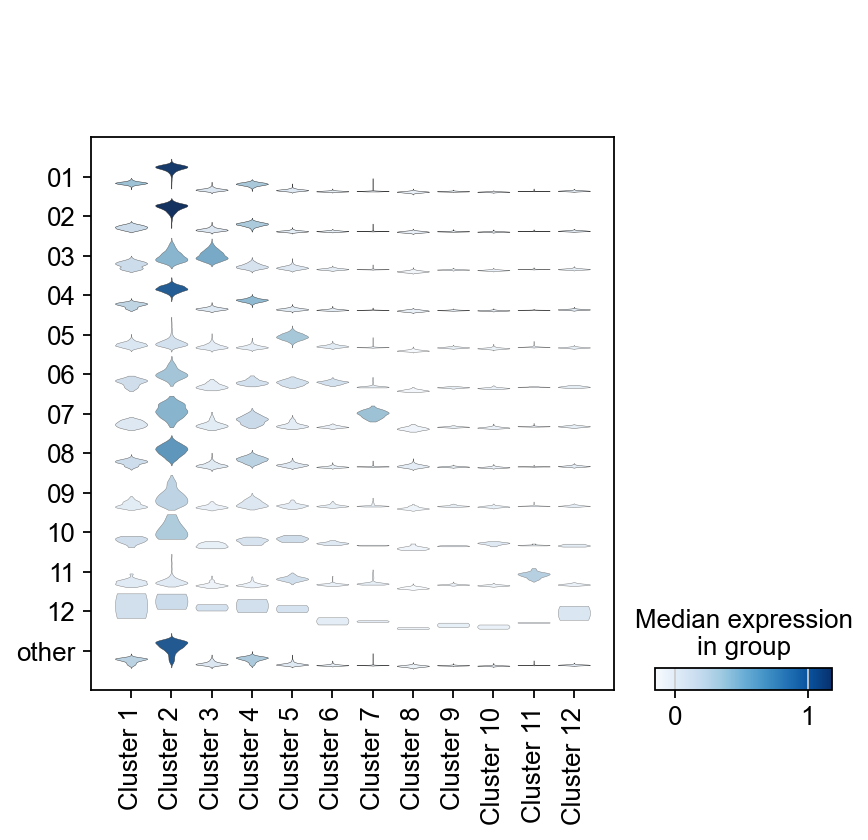

In [144]:
sc.pl.stacked_violin(adata_log_ordered, cancerCell, groupby='clusterK12_stringent')

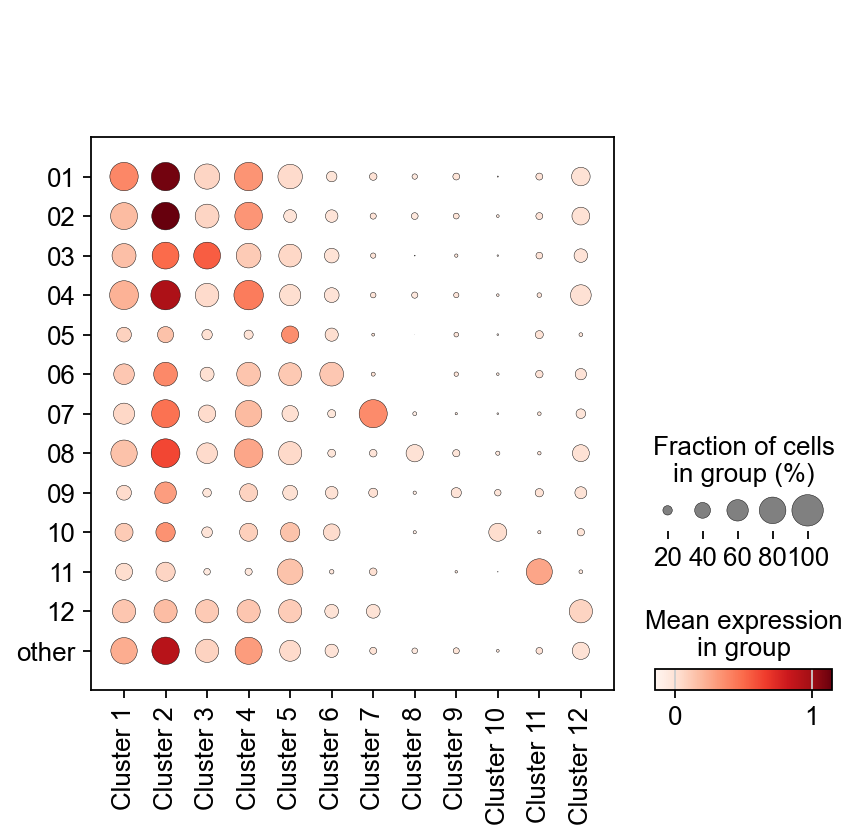

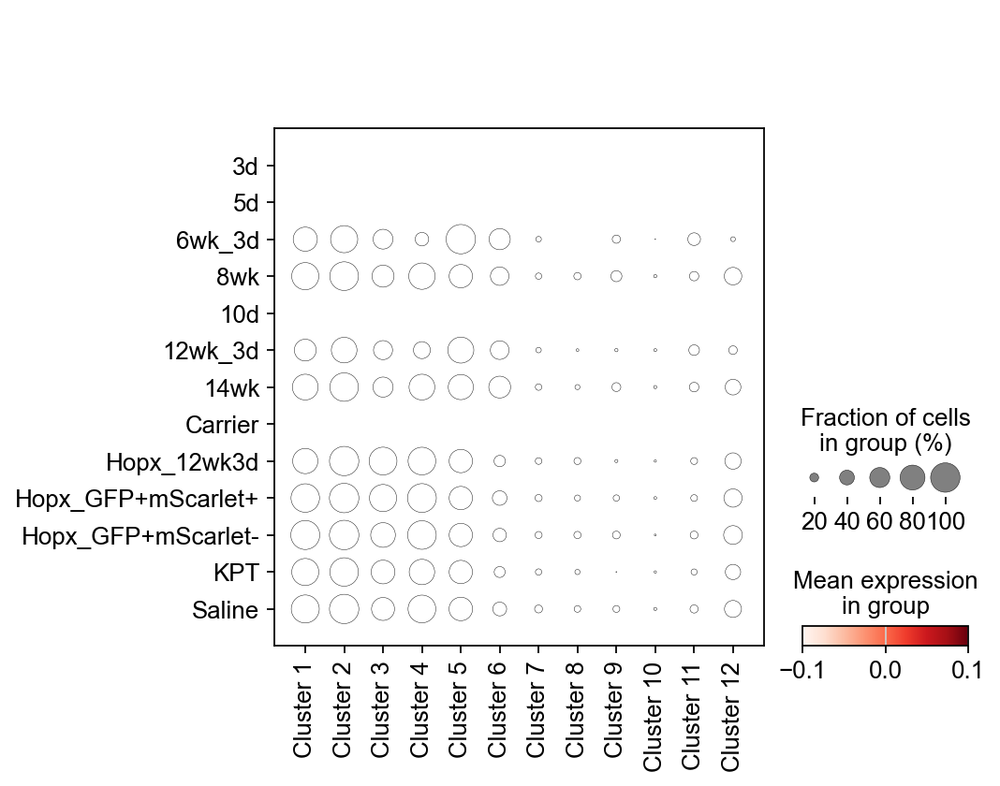

In [145]:
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='clusterK12_stringent')
sc.pl.dotplot(adata_log_ordered, [*cancerCell], groupby='Group')

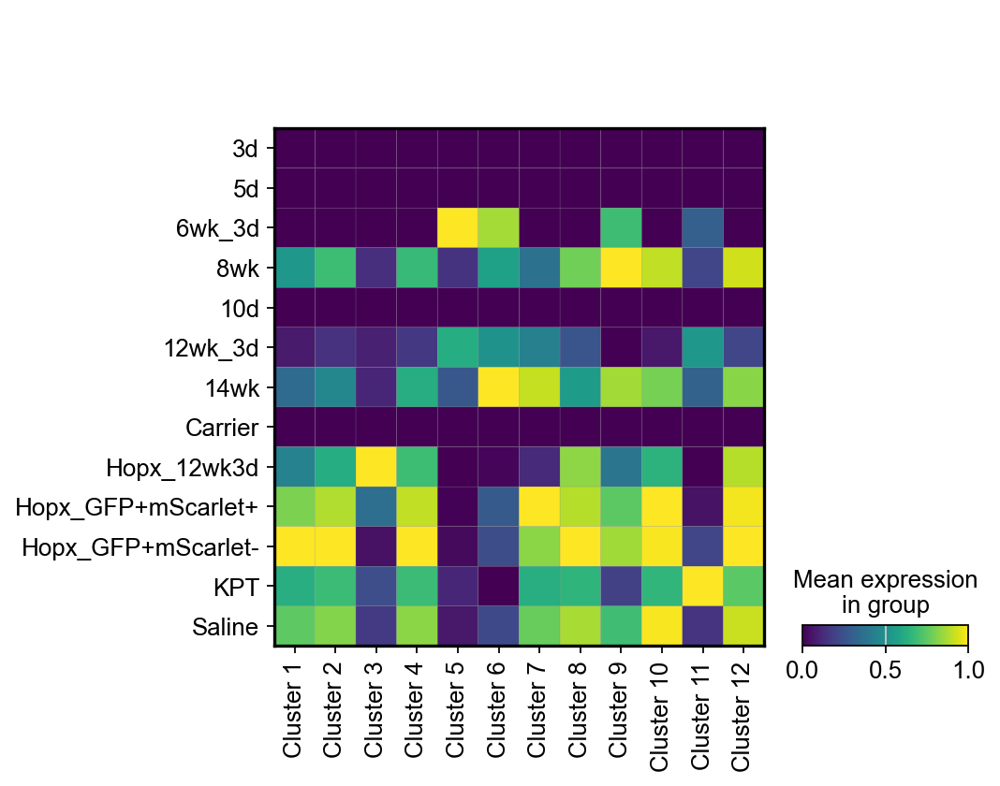

In [146]:
sc.pl.matrixplot(adata_log_ordered, [*cancerCell], groupby='Group',standard_scale='var')
#sc.pl.matrixplot(adata_log_ordered, cancerCell, groupby='Group',standard_scale='var')

In [147]:
adata_concat.obs['clusterK12'] = adata_log_ordered.obs['clusterK12'].astype('category')
adata_concat.obs['clusterK12_stringent'] = adata_log_ordered.obs['clusterK12_stringent'].astype('category')

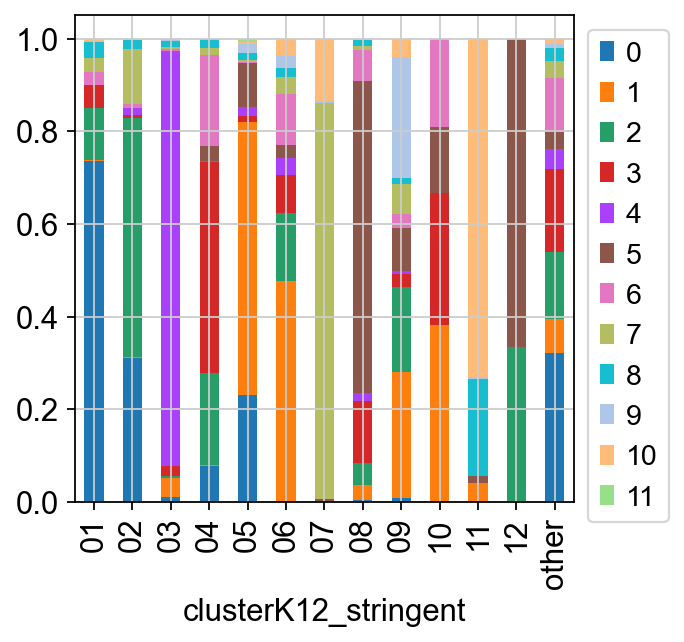

In [148]:
 cell_proportion_df = pd.crosstab(adata_concat.obs['leiden'],adata_log_ordered.obs['clusterK12_stringent'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

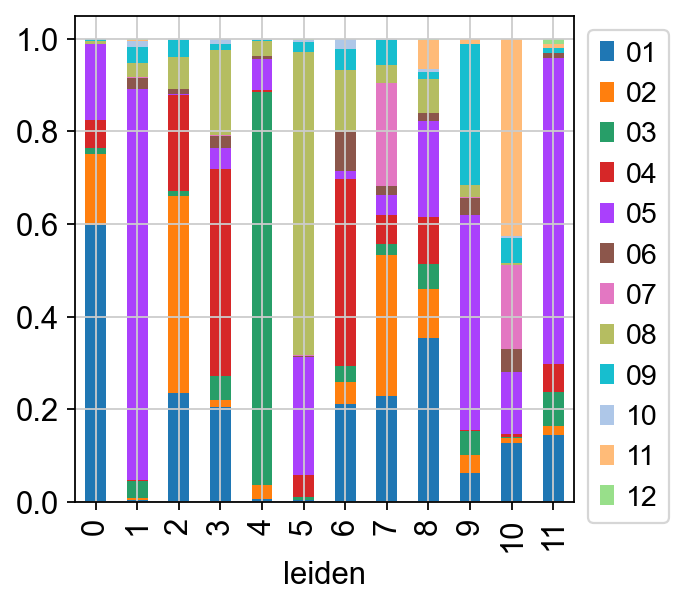

In [149]:
 cell_proportion_df = pd.crosstab(adata_concat.obs['clusterK12'],adata_log_ordered.obs['leiden'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

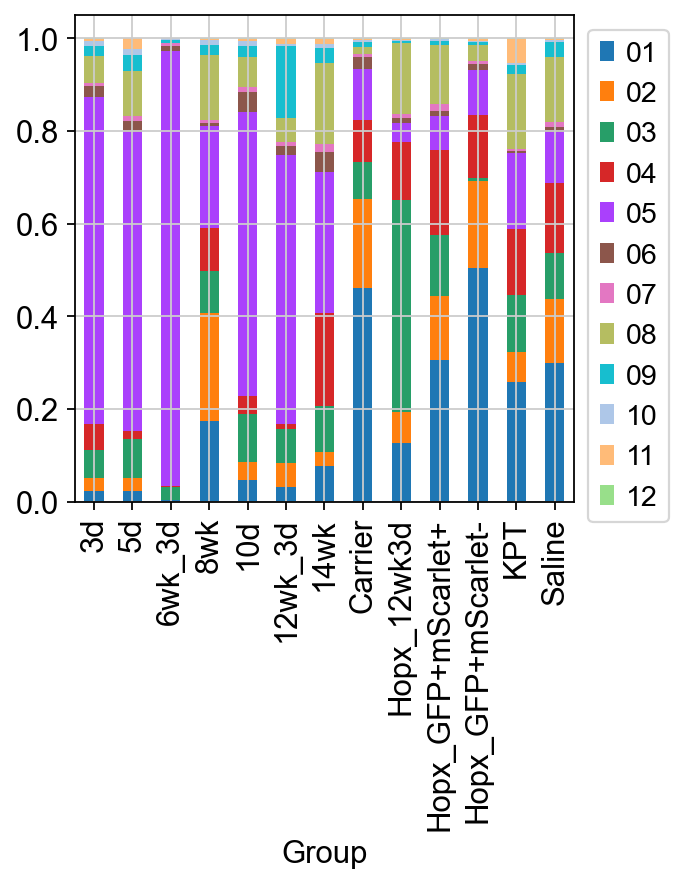

In [150]:
 cell_proportion_df = pd.crosstab(adata_concat.obs['clusterK12'],adata_log_ordered.obs['Group'], normalize='columns').T.plot(kind='bar', stacked=True).legend(bbox_to_anchor=(1,1))

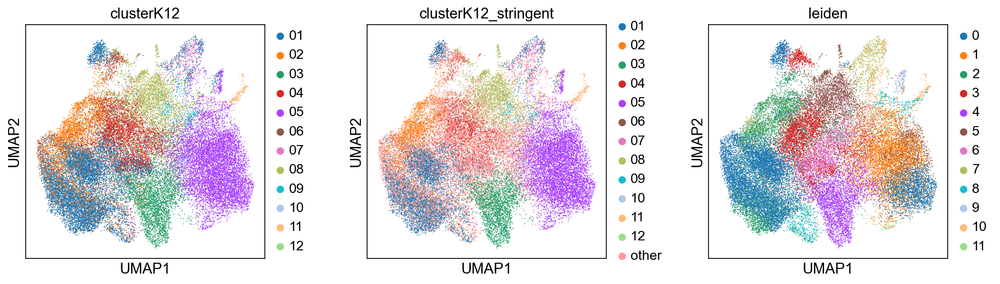

In [151]:
sc.pl.umap(adata_concat, color=['clusterK12', 'clusterK12_stringent','leiden'], wspace=0.3)

### End Logistic Regression

In [152]:
sc.tl.embedding_density(adata_concat,basis='umap', groupby='clusterK12')

computing density on 'umap'
--> added
    'umap_density_clusterK12', densities (adata.obs)
    'umap_density_clusterK12_params', parameter (adata.uns)


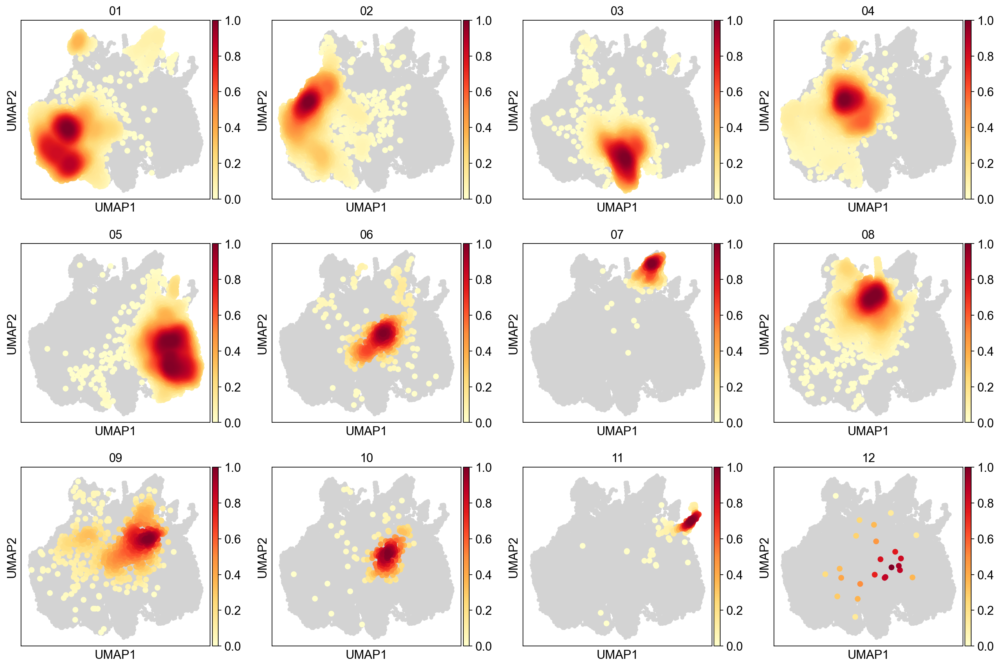

In [153]:
sc.pl.embedding_density(adata_concat,basis='umap',key='umap_density_clusterK12')

### Try ingestion

In [154]:
var_names = adata_orig.var_names.intersection(adata2.var_names)
adata_ref = adata_orig[:, var_names]
adata3 = adata2[:, var_names]

In [155]:
sc.pp.highly_variable_genes(adata_ref, batch_key='batch')

extracting highly variable genes
    finished (0:00:11)


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:700: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["hvg"] = {"flavor": flavor}


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [156]:
adata_ref.var.highly_variable = adata_ref.var.highly_variable_intersection

In [157]:
#Ensure marker genes aren't making an impact to highly variable gene analysis downstream
adata_ref.var.highly_variable['EGFP'] = False
adata_ref.var.highly_variable['mScarlet'] = False
adata_ref.var.highly_variable['Cre'] = False
adata_ref.var.highly_variable['ERT'] = False
adata_ref.var.highly_variable['iDTR'] = False
adata_ref.var.highly_variable['tagBFP'] = False
adata_ref.var.highly_variable['mKate2'] = False
adata_ref.var.highly_variable['Akaluc'] = False
adata_ref.var.highly_variable['tdTomato'] = False

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/3000869962.py:2: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata_ref.var.highly_variable['EGFP'] = False
/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/30

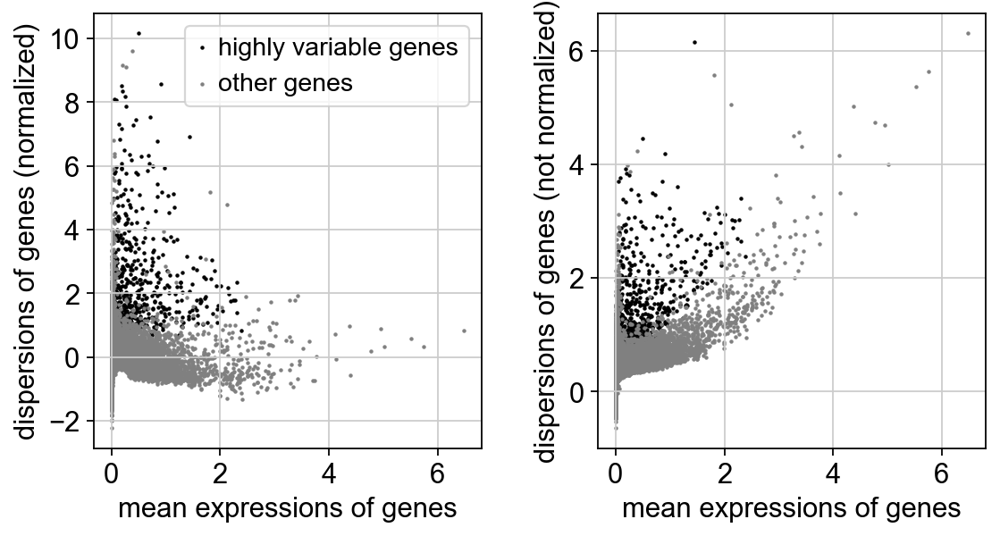

In [158]:
sc.pl.highly_variable_genes(adata_ref)

In [159]:
adata_ref.raw = adata_ref

In [160]:
sc.pp.scale(adata_ref, max_value=10)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [161]:
sc.tl.pca(adata_ref, svd_solver='arpack', n_comps=150)

computing PCA
    with n_comps=150
    finished (0:00:01)


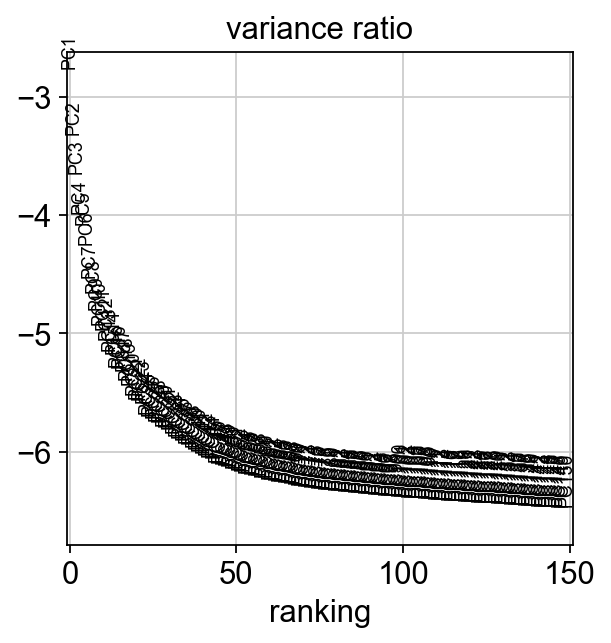

In [162]:
sc.pl.pca_variance_ratio(adata_ref, log=True, n_pcs=150)

In [163]:
sc.pp.neighbors(adata_ref, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)


In [164]:
sc.tl.umap(adata_ref)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:14)


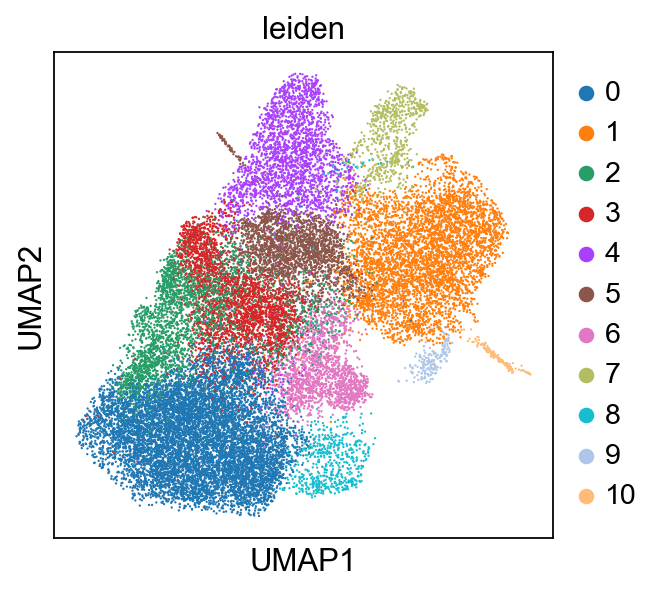

In [165]:
sc.pl.umap(adata_ref, color="leiden")

In [166]:
sc.tl.ingest(adata3, adata_ref, obs="leiden")

running ingest


/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


    finished (0:00:11)


<frozen _collections_abc>:949: ImplicitModificationWarning: Setting element `.obsm['rep']` of view, initializing view as actual.
<frozen _collections_abc>:949: ImplicitModificationWarning: Setting element `.obsm['X_umap']` of view, initializing view as actual.
<frozen _collections_abc>:949: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.


In [167]:
adata3.uns["leiden_colors"] = adata_ref.uns["leiden_colors"]

In [168]:
adata_concat = adata_ref.concatenate(adata3, batch_categories=["old", "new"])

/var/folders/xc/wjwqs2j55dqgp2ghrn6nmlj1nlk7kz/T/ipykernel_87287/1929136370.py:1: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_concat = adata_ref.concatenate(adata3, batch_categories=["old", "new"])
/Users/chanj2/opt/miniconda3/envs/scbackup/lib/python3.11/site-packages/anndata/_core/merge.py:1356: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


In [169]:
adata_concat.obs.leiden = adata_concat.obs.leiden.astype("category")
# fix category ordering
adata_concat.obs.leiden = adata_concat.obs.leiden.cat.reorder_categories(adata_ref.obs.leiden.cat.categories)
# fix category colors
adata_concat.uns["leiden_colors"] = adata_ref.uns["leiden_colors"]

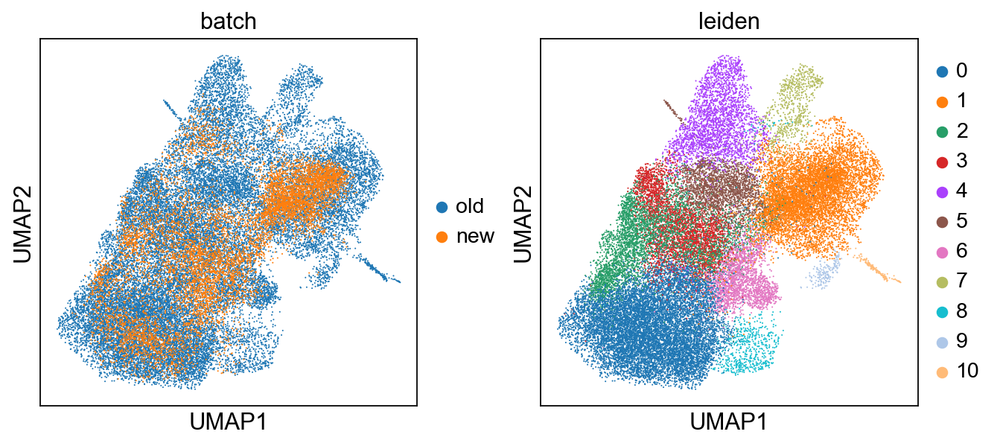

In [170]:
sc.pl.umap(adata_concat, color=["batch", "leiden"])

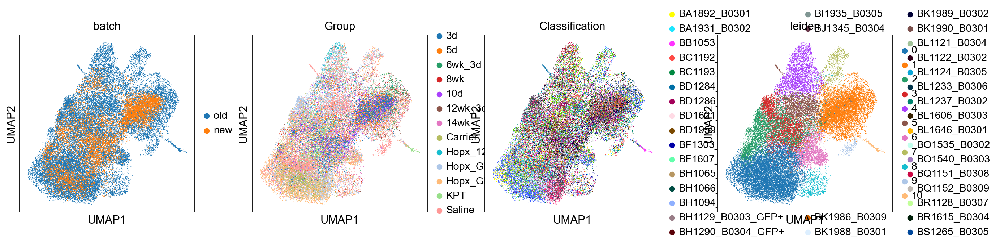

In [171]:
sc.pl.umap(adata_concat, color=['batch','Group','Classification','leiden'])

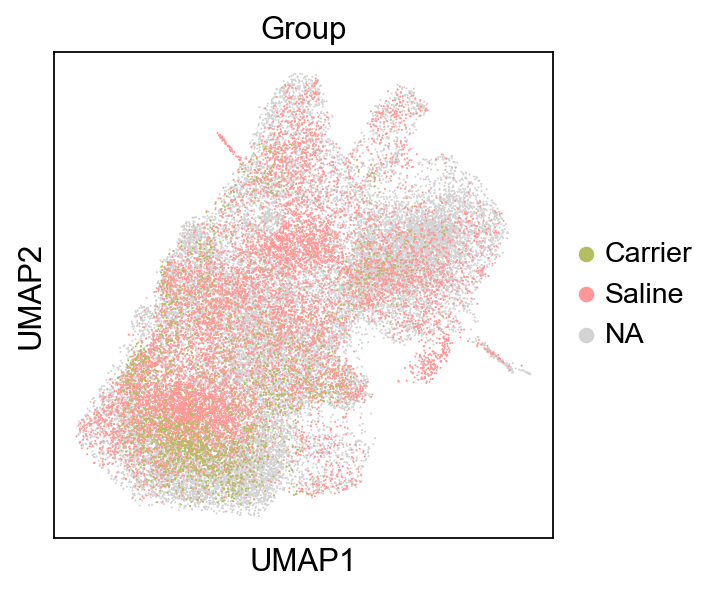

In [172]:
sc.pl.umap(adata_concat, color=['Group'], groups=['Saline', 'Carrier'])

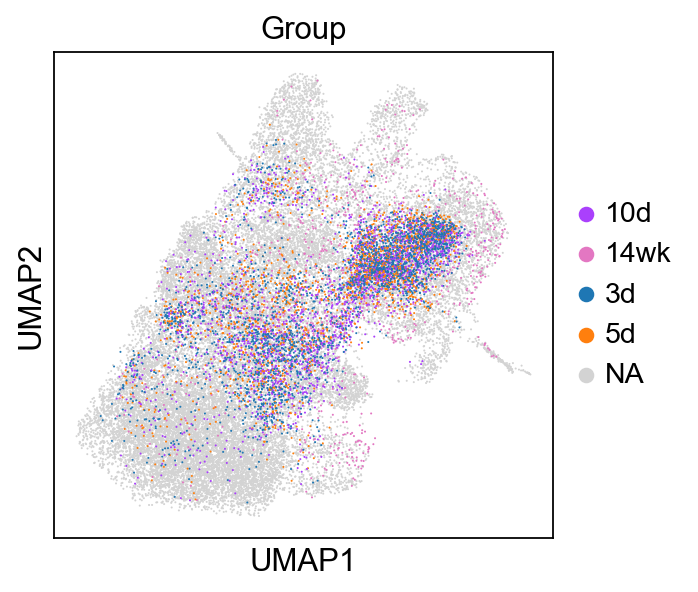

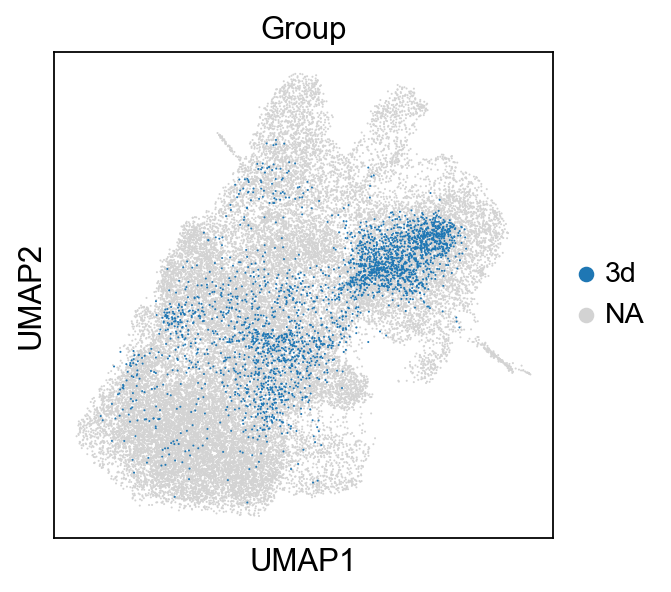

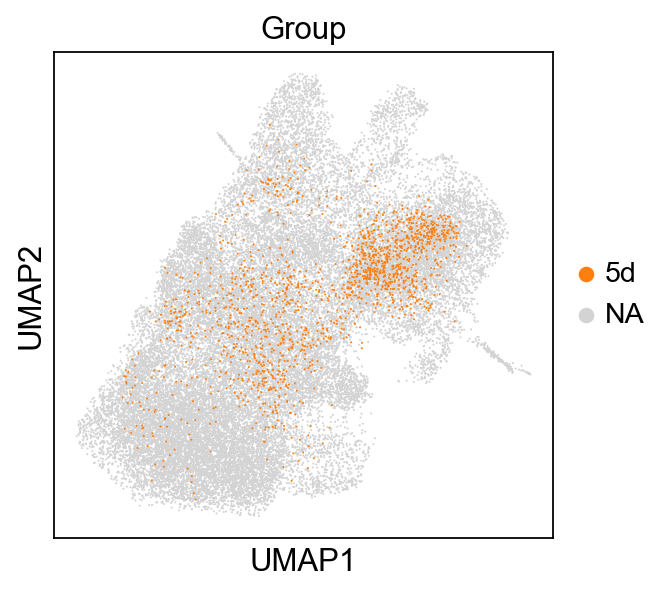

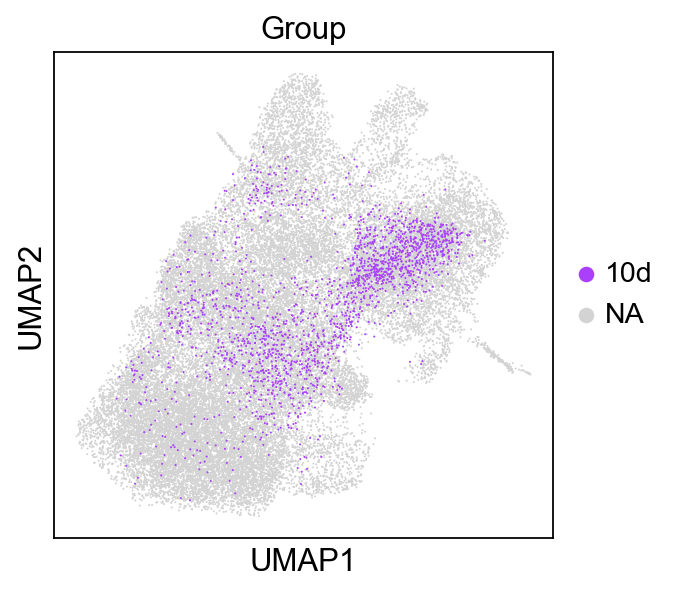

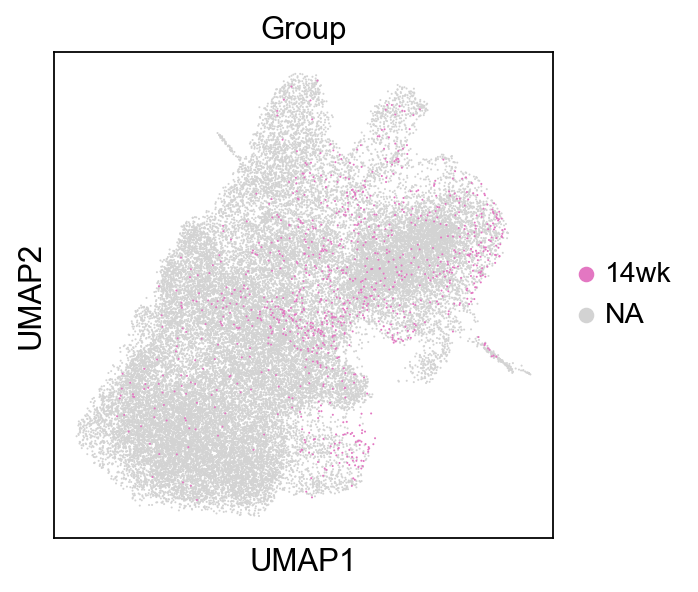

In [173]:
sc.pl.umap(adata_concat, color=['Group'], groups=['3d','5d','10d','14wk'])
sc.pl.umap(adata_concat, color=['Group'], groups=['3d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['5d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['10d'])
sc.pl.umap(adata_concat, color=['Group'], groups=['14wk'])

In [174]:
sc.tl.embedding_density(adata_concat,basis='umap', groupby='Group')

computing density on 'umap'
--> added
    'umap_density_Group', densities (adata.obs)
    'umap_density_Group_params', parameter (adata.uns)


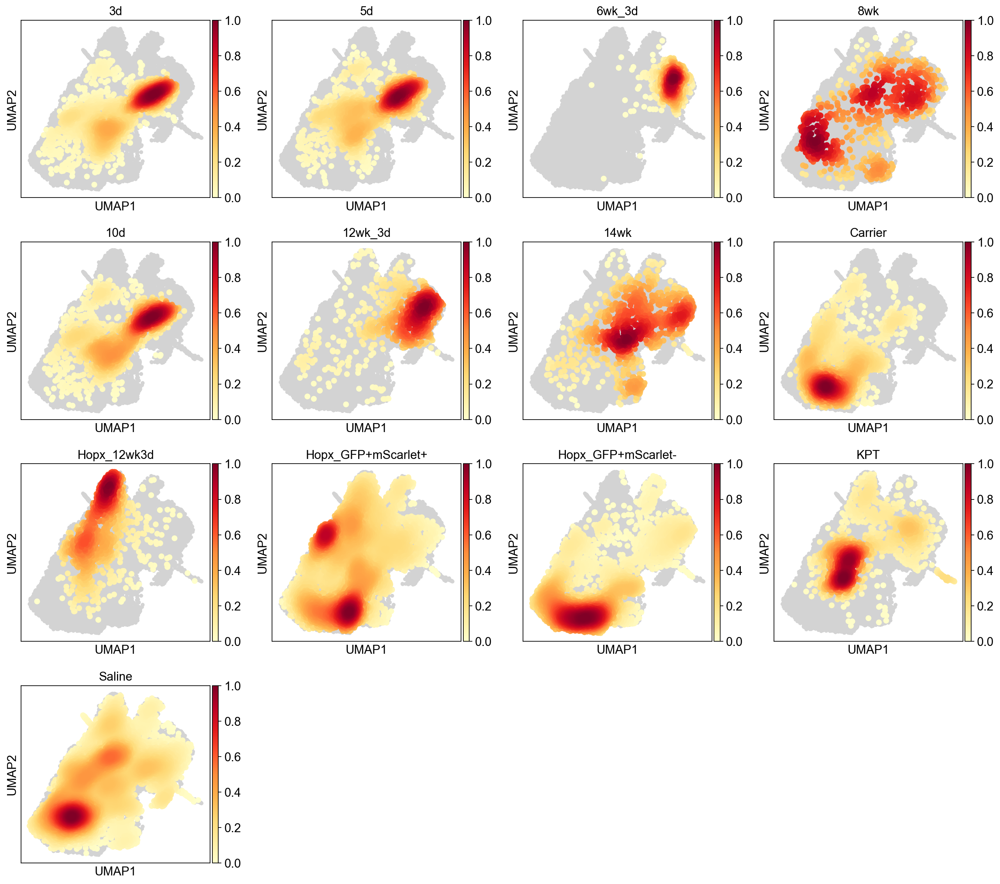

In [175]:
sc.pl.embedding_density(adata_concat,basis='umap',key='umap_density_Group')

In [176]:
adata.obs.batch.value_counts()

batch
traced    3176
Name: count, dtype: int64